In [6]:
import json
import csv
import numpy as np

from PIL import Image
import cv2

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def finderbyid(image_tuple_list, image_id):
    return list(filter(lambda x: x[0] == image_id, image_tuple_list))

def finderbyfilename(image_tuple_list, image_id):
    return list(filter(lambda x: x[1] == image_id, image_tuple_list))

# read imageannotation_ai_lung_bounding_boxes.json
images = {}
with open('../data/covid-chestxray-dataset/annotations/imageannotation_ai_lung_bounding_boxes.json') as json_file:
    data = json.load(json_file)

    # read images
    for image_info in data['images']:
        image_id = int(image_info['id'])
        
        images[(image_id, image_info['file_name'])] = []
        
    for image_annotation in data['annotations']:
        image_id = int(image_annotation['image_id'])
        
        # get image key
        image_key = finderbyid(images.keys(), image_id)[0]
        
        # append bounding box
        images[image_key].append(image_annotation['bbox'])
        
    # print(images)

# read metadata.csv
with open('../data/covid-chestxray-dataset/metadata.csv', newline='') as csvfile:
    
    csv_reader = csv.reader(csvfile, delimiter=',', quotechar='"')

    # get column name
    column_name = next(csv_reader)[:-1]
#     print(column_name)

    # construct the dictionary
    patient_data = {}
    for line in csv_reader:
        line = line[:-1]

        if 'COVID-19' in line[column_name.index('finding')] and \
            line[column_name.index('modality')] == 'X-ray' and \
            (line[column_name.index('view')] == 'PA' or 'AP' in line[column_name.index('view')]):
            
            patient_id = line[column_name.index('patientid')]
            
            if patient_id not in patient_data.keys():
                patient_data[patient_id] = {}
                
                patient_data[patient_id]['sex'] = line[column_name.index('sex')]
                patient_data[patient_id]['age'] = line[column_name.index('age')]
                patient_data[patient_id]['location'] = line[column_name.index('location')]
                
                patient_data[patient_id]['records'] = []
                
            # add bounding box
            try:
                image_file_name = line[column_name.index('filename')]
                image_key = finderbyfilename(images.keys(), image_file_name)[0]
                record = [line[1]] + line[5:] + [images[image_key]]
            except:
                record = [line[1]] + line[5:] + []
                
            patient_data[patient_id]['records'].append(record)

In [7]:
# compute statistics

import pandas as pd
from collections import defaultdict

patient_statistics = defaultdict(int)
sample_statistics = defaultdict(int)
patient_availability_statistics = defaultdict(int)
sample_availability_statistics = defaultdict(int)

with_multiple_samples = 0
for patient_id in patient_data:
    # reset
    survival = 0
    intubated = 0
    extubated = 0
    went_icu = 0
    needed_supplemental_O2 = 0
    temperature = 0
    pO2_saturation = 0
    leukocyte_count = 0
    neutrophil_count = 0
    lymphocyte_count = 0
    
    patient_statistics["total"] += 1
    patient_availability_statistics["total"] += 1
    
    if len(patient_data[patient_id]['records']) > 1:
        with_multiple_samples += 1
    
    for record in patient_data[patient_id]['records']:
        
        def binary_item(column_info, attr_name, attr_counter):
            
            if record[column_name.index(column_info) - 4] == '':
                
                patient_statistics[attr_name] += 0
                sample_statistics[attr_name] += 0
                patient_availability_statistics[attr_name] += 0
                sample_availability_statistics[attr_name] += 0
            else:
                sample_availability_statistics[attr_name] += 1

                if record[column_name.index(column_info) - 4] == 'Y':
                    
                    sample_statistics[attr_name] += 1

                    if attr_counter != 1:
                        patient_statistics[attr_name] += 1
                        patient_availability_statistics[attr_name] += 1
                    attr_counter = 1
                else:
                    if attr_counter != -1:
                        patient_availability_statistics[attr_name] += 1
                    attr_counter = -1

            return attr_counter
    
        def range_item(column_info, attr_name, attr_counter):
            if record[column_name.index(column_info) - 4] == '':
                patient_statistics[attr_name] += 0
                sample_statistics[attr_name] += 0
                patient_availability_statistics[attr_name] += 0
                sample_availability_statistics[attr_name] += 0
            else:
                sample_availability_statistics[attr_name] += 1

                if float(record[column_name.index(column_info) - 4]):
                    sample_statistics[attr_name] += 1

                    if attr_counter != 1:
                        patient_statistics[attr_name] += 1
                        patient_availability_statistics[attr_name] += 1
                    attr_counter = 1

            return attr_counter
        
        sample_statistics['total'] += 1
        sample_availability_statistics['total'] += 1
        
        survival = binary_item('survival', 'survival', survival)
        intubated = binary_item('intubated', 'intubated', intubated)
        extubated = binary_item('extubated', 'extubated', extubated)
        went_icu = binary_item('went_icu', 'went_icu', went_icu)
        needed_supplemental_O2 = binary_item('needed_supplemental_O2', 'needed_supplemental_O2', needed_supplemental_O2)
        
        temperature = range_item('temperature', 'temperature', temperature)
        pO2_saturation = range_item('pO2_saturation', 'pO2_saturation', pO2_saturation)
        leukocyte_count = range_item('leukocyte_count', 'leukocyte_count', leukocyte_count)
        neutrophil_count = range_item('neutrophil_count', 'neutrophil_count', neutrophil_count)
        lymphocyte_count = range_item('lymphocyte_count', 'lymphocyte_count', lymphocyte_count)
        
patient_statistics["patients_with_multiple_images"] = with_multiple_samples
patient_availability_statistics["patients_with_multiple_images"] = with_multiple_samples

# combine into one dictionary
result_patient_statistics = {}
for attr_name in patient_statistics.keys():
    result_patient_statistics[attr_name] = "%s (out of %s)" % (patient_statistics[attr_name], patient_availability_statistics[attr_name])
    
result_sample_statistics = {}
for attr_name in sample_statistics.keys():
    result_sample_statistics[attr_name] = "%s (out of %s)" % (sample_statistics[attr_name], sample_availability_statistics[attr_name])

# print final results
print("\033[1m[Patient Statistics]\033[0m: number of patients")
patient_df = pd.DataFrame(result_patient_statistics.items(), columns=["", ""])
print(patient_df)

print()
print()
print()

print("\033[1m[Sample/Image Statistics]\033[0m: number of images")
sample_df = pd.DataFrame(result_sample_statistics.items(), columns=["", ""])
print(sample_df)

[Patient Statistics]: number of patients
                                                   
0                           total  262 (out of 262)
1                        survival    63 (out of 78)
2                       extubated     8 (out of 11)
3          needed_supplemental_O2    17 (out of 27)
4                     temperature    51 (out of 51)
5                  pO2_saturation    80 (out of 80)
6                 leukocyte_count    14 (out of 14)
7                neutrophil_count    20 (out of 20)
8                lymphocyte_count    30 (out of 30)
9                       intubated    46 (out of 74)
10                       went_icu   65 (out of 106)
11  patients_with_multiple_images  102 (out of 102)



[Sample/Image Statistics]: number of images
                                            
0                    total  434 (out of 434)
1                 survival  125 (out of 157)
2                extubated    21 (out of 31)
3   needed_supplemental_O2    37 (out of 53)
4          

Patient 2	[Gender]: M	[Age]: 65
[Patient Location]: Cho Ray Hospital, Ho Chi Minh City, Vietnam


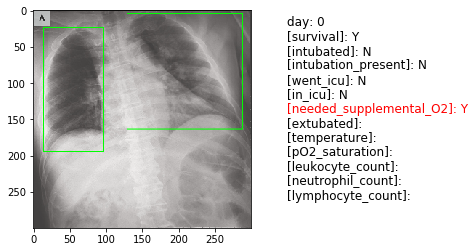

[Clincal Notes]: On January 22, 2020, a 65-year-old man with a history of hypertension, type 2 diabetes, coronary heart disease for which a stent had been implanted, and lung cancer was admitted to the emergency department of Cho Ray Hospital, the referral hospital in Ho Chi Minh City, for low-grade fever and fatigue. He had become ill with fever on January 17, a total of 4 days after he and his wife had flown to Hanoi from the Wuchang district in Wuhan, where outbreaks of 2019-nCoV were occurring. He reported that he had not been exposed to a �wet market� (a market where dead and live animals are sold) in Wuhan. Chest radiographs obtained on admission showed an infiltrate in the upper lobe of the left lung


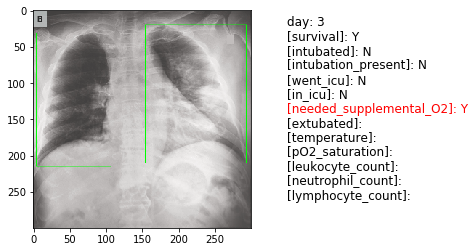

[Clincal Notes]: On January 22, 2020, a 65-year-old man with a history of hypertension, type 2 diabetes, coronary heart disease for which a stent had been implanted, and lung cancer was admitted to the emergency department of Cho Ray Hospital, the referral hospital in Ho Chi Minh City, for low-grade fever and fatigue. He had become ill with fever on January 17, a total of 4 days after he and his wife had flown to Hanoi from the Wuchang district in Wuhan, where outbreaks of 2019-nCoV were occurring. He reported that he had not been exposed to a �wet market� (a market where dead and live animals are sold) in Wuhan. On January 25, he received supplemental oxygen through a nasal cannula at a rate of 5 liters per minute because of increasing dyspnea with hypoxemia. The partial pressure of oxygen was 57.2 mm Hg while he was breathing ambient air, and a progressive infiltrate and consolidation were observed on chest radiographs


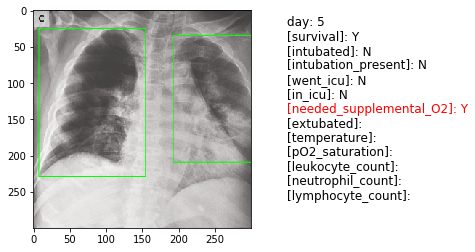

[Clincal Notes]: On January 22, 2020, a 65-year-old man with a history of hypertension, type 2 diabetes, coronary heart disease for which a stent had been implanted, and lung cancer was admitted to the emergency department of Cho Ray Hospital, the referral hospital in Ho Chi Minh City, for low-grade fever and fatigue. He had become ill with fever on January 17, a total of 4 days after he and his wife had flown to Hanoi from the Wuchang district in Wuhan, where outbreaks of 2019-nCoV were occurring. He reported that he had not been exposed to a �wet market� (a market where dead and live animals are sold) in Wuhan. On January 25, he received supplemental oxygen through a nasal cannula at a rate of 5 liters per minute because of increasing dyspnea with hypoxemia. The partial pressure of oxygen was 57.2 mm Hg while he was breathing ambient air, and a progressive infiltrate and consolidation were observed on chest radiographs


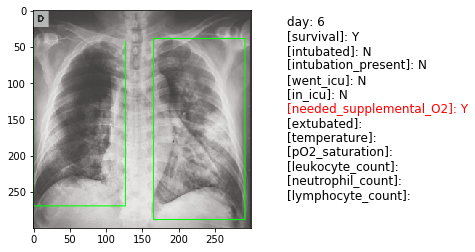

[Clincal Notes]: On January 22, 2020, a 65-year-old man with a history of hypertension, type 2 diabetes, coronary heart disease for which a stent had been implanted, and lung cancer was admitted to the emergency department of Cho Ray Hospital, the referral hospital in Ho Chi Minh City, for low-grade fever and fatigue. He had become ill with fever on January 17, a total of 4 days after he and his wife had flown to Hanoi from the Wuchang district in Wuhan, where outbreaks of 2019-nCoV were occurring. He reported that he had not been exposed to a �wet market� (a market where dead and live animals are sold) in Wuhan. Progressive infiltrate and consolidation





Patient 4	[Gender]: F	[Age]: 52
[Patient Location]: Changhua Christian Hospital, Changhua City, Taiwan 


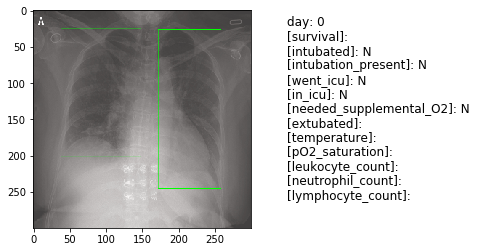

[Clincal Notes]: diffuse infiltrates in the bilateral lower lungs


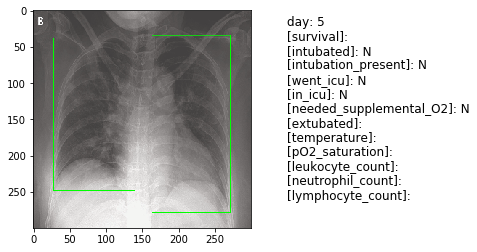

[Clincal Notes]: progressive diffuse interstitial opacities and consolidation in the bilateral parahilar areas and lower lung fields





Patient 6	[Gender]: 	[Age]: 
[Patient Location]: Wuhan Jinyintan Hospital, Wuhan, Hubei Province, China


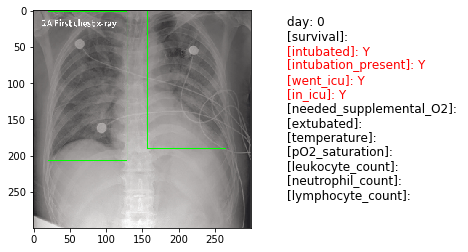

[Clincal Notes]: Case 2: chest x-ray obtained on Jan 6 (2A). The brightness of both lungs was decreased and multiple patchy shadows were observed; edges were blurred, and large ground-glass opacity and condensation shadows were mainly on the lower right lobe. Tracheal intubation could be seen in the trachea. Heart shadow roughly presents in the normal range. On the left side, the diaphragmatic surface is not clearly displayed. The right side of the diaphragmatic surface was light and smooth and rib phrenic angle was less sharp. Chest x-ray on Jan 10 showed worse status (2B)


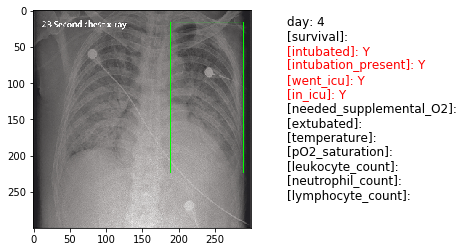

[Clincal Notes]: Case 2: chest x-ray obtained on Jan 6 (2A). The brightness of both lungs was decreased and multiple patchy shadows were observed; edges were blurred, and large ground-glass opacity and condensation shadows were mainly on the lower right lobe. Tracheal intubation could be seen in the trachea. Heart shadow roughly presents in the normal range. On the left side, the diaphragmatic surface is not clearly displayed. The right side of the diaphragmatic surface was light and smooth and rib phrenic angle was less sharp. Chest x-ray on Jan 10 showed worse status (2B)





Patient 11	[Gender]: M	[Age]: 56
[Patient Location]: Sunnybrook Health Sciences Centre, Toronto, Ontario, Canada


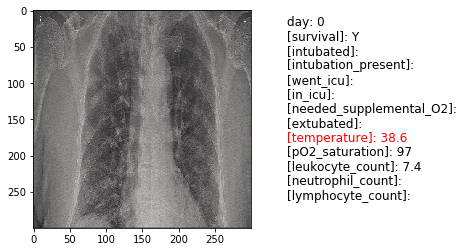

[Clincal Notes]: A 56-year-old man presented to our Emergency Department in Toronto, ON, Canada, with fever and non-productive cough, 1 day after returning from a 3-month visit to Wuhan, China. Given this travel history, the transferring ambulance and receiving hospital personnel used appropriate personal protective equipment. He had a medical history of well controlled hypertension. On examination, his maximum temperature was 38�6�C, oxygen saturation was 97% on room air, and respiratory rate was 22 breaths per min�without any signs of respiratory distress. Laboratory investigations showed mild thrombocytopenia (113 � 109 per L, normal 150�400), haemoglobin concentration 146 g/L (normal 130�180), white blood cell count 7�4 � 109 per L (normal 4�11), creatinine concentration 81 ?mol/L, alanine aminotransferase 29 IU/L (normal <40), and lactate concentration 1�1 mmol/L (normal 0�5�2�0). A chest x-ray showed patchy bilateral, peribronchovascular, ill-defined opacities in all lung zones.


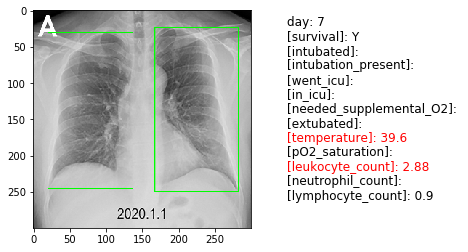

[Clincal Notes]: On January 1, 2020, a 42-year-old man was admitted to the emergency department of Union Hospital (Tongji Medical College, Wuhan, Hubei Province) due to a high-grade fever (39.6�C [103.28�C]), cough, and fatigue for 1 week. Bilateral coarse breath sounds with wet rales distributed at the bases of both lungs were heard on auscultation. A, Chest radiograph obtained on day 7 after the onset of symptoms shows opacities in the left lower and right upper lobes.





Patient 13	[Gender]: M	[Age]: 35
[Patient Location]: Snohomish County, Washington, USA


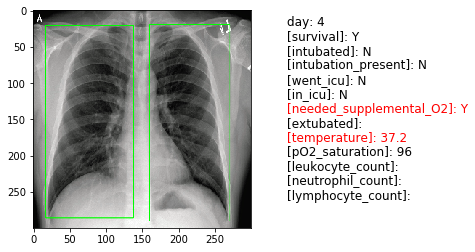

[Clincal Notes]: On January 19, 2020, a 35-year-old man presented to an urgent care clinic in Snohomish County, Washington, with a 4-day history of cough and subjective fever. No thoracic abnormalities were noted.


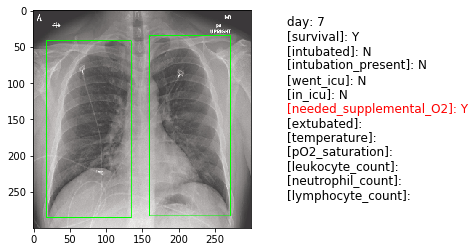

[Clincal Notes]: On January 19, 2020, a 35-year-old man presented to an urgent care clinic in Snohomish County, Washington, with a 4-day history of cough and subjective fever. No acute intrathoracic plain-film abnormality was noted.


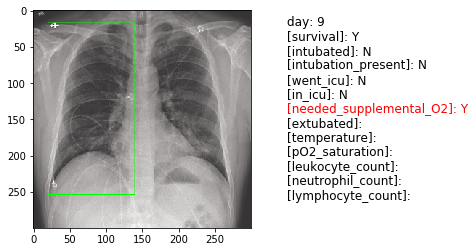

[Clincal Notes]: On January 19, 2020, a 35-year-old man presented to an urgent care clinic in Snohomish County, Washington, with a 4-day history of cough and subjective fever.Increasing left basilar opacity was visible, arousing concern about pneumonia.


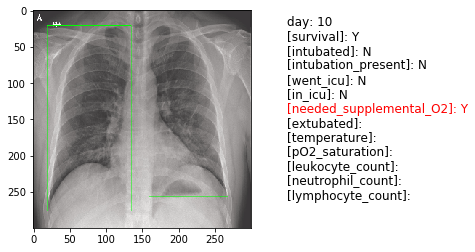

[Clincal Notes]: On January 19, 2020, a 35-year-old man presented to an urgent care clinic in Snohomish County, Washington, with a 4-day history of cough and subjective fever. Stable streaky opacities in the lung bases were visible, indicating likely atypical pneumonia; the opacities have steadily increased in density over time.





Patient 14	[Gender]: F	[Age]: 
[Patient Location]: Hong Kong


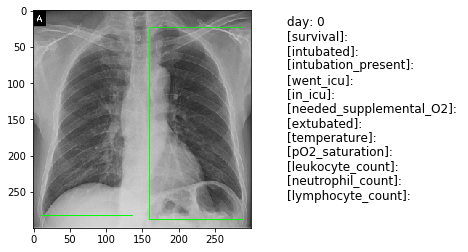

[Clincal Notes]: 





Patient 15	[Gender]: M	[Age]: 
[Patient Location]: Hong Kong


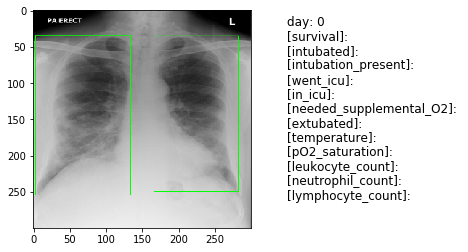

[Clincal Notes]: Chest radiographs of an elderly male patient from Wuhan, China, who travelled to Hong Kong, China. These are 3 chest radiographs selected out of the daily chest radiographs acquired in this patient. The consolidation in the right lower zone on day 0 persist into day 4 with new consolidative changes in the right midzone periphery and perihilar region. This midzone change improves on the day 7 film.


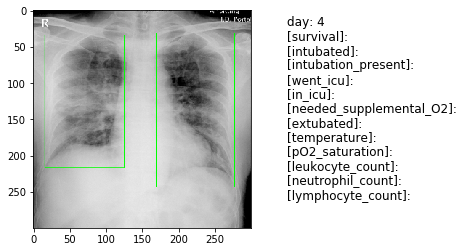

[Clincal Notes]: Chest radiographs of an elderly male patient from Wuhan, China, who travelled to Hong Kong, China. These are 3 chest radiographs selected out of the daily chest radiographs acquired in this patient. The consolidation in the right lower zone on day 0 persist into day 4 with new consolidative changes in the right midzone periphery and perihilar region. This midzone change improves on the day 7 film.


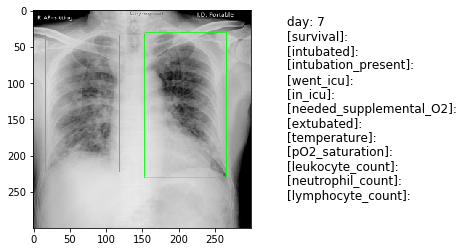

[Clincal Notes]: Chest radiographs of an elderly male patient from Wuhan, China, who travelled to Hong Kong, China. These are 3 chest radiographs selected out of the daily chest radiographs acquired in this patient. The consolidation in the right lower zone on day 0 persist into day 4 with new consolidative changes in the right midzone periphery and perihilar region. This midzone change improves on the day 7 film.





Patient 16	[Gender]: F	[Age]: 59
[Patient Location]: Sichuan Provincial People�s Hospital, Chengdu, China


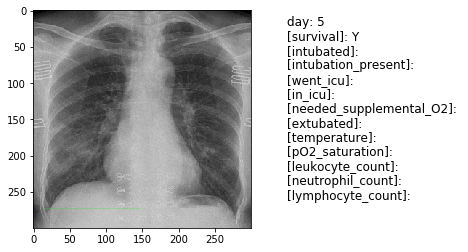

[Clincal Notes]: A 59-year-old female from Sichuan Provincial People�s Hospital presented with fever and chills. She had no history of sick contacts in the family, but she referred a plane ride 5 days prior to onset of symptoms from London, U.K., to Chengdu, China.  Chest radiograph in a patient with COVID-19 infection demonstrates right infrahilar airspace opacities.





Patient 17	[Gender]: M	[Age]: 54
[Patient Location]: Myongji Hospital, Goyang, South Korea


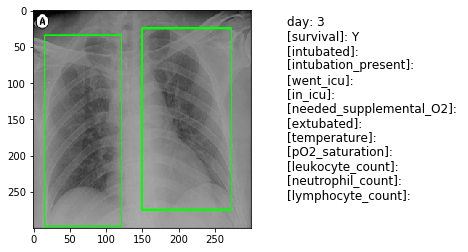

[Clincal Notes]: Small consolidation in right upper lobe and ground-glass opacities in both lower lobes were observed on high-resolution computed tomography scan


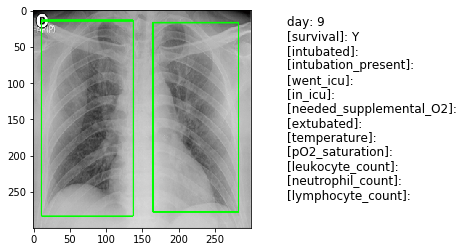

[Clincal Notes]: Small consolidation in right upper lobe and ground-glass opacities in both lower lobes were observed on high-resolution computed tomography scan


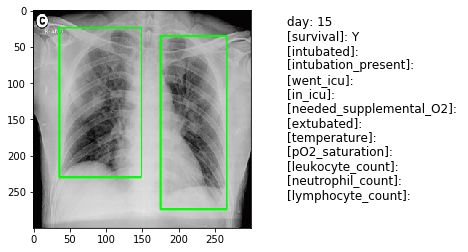

[Clincal Notes]: Small consolidation in right upper lobe and ground-glass opacities in both lower lobes were observed on high-resolution computed tomography scan





Patient 18	[Gender]: F	[Age]: 53
[Patient Location]: Jinling Hospital, Medical School of Nanjing University, Nanjing, Jiangsu, China


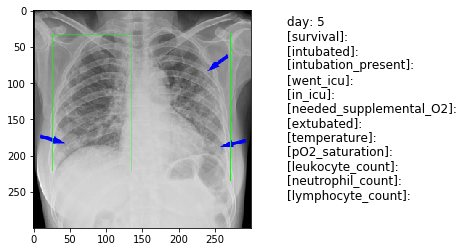

[Clincal Notes]: Chest radiography of confirmed Coronavirus Disease 2019 (COVID-19) pneumonia A 53-year-old female had fever and cough for 5 days. Multifocal patchy opacities can be seen in both lungs (arrows).





Patient 19	[Gender]: F	[Age]: 55
[Patient Location]: Taoyuan General Hospital, Taoyuan, Taiwan


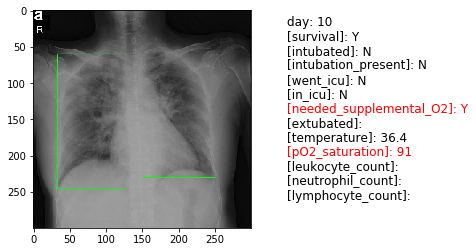

[Clincal Notes]: On January 20, 2020, a 55-year-old woman who worked in Wuhan, China, arrived at Taiwan Taoyuan International Airport and presented to quarantine officials immediately, with a history of sore throat, dry cough, fatigue, and low-grade subjective fever since January 11, 2020. Apart from a history of hypothyroidism with regular medical follow-up, she had no other underlying disease before this onset. Chest X-ray showed progression of prominent bilateral perihilar infiltration and ill-defined patchy opacities at bilateral lungs, which slowly resolved on the follow-up image.


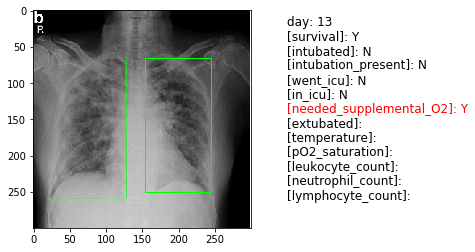

[Clincal Notes]: On January 20, 2020, a 55-year-old woman who worked in Wuhan, China, arrived at Taiwan Taoyuan International Airport and presented to quarantine officials immediately, with a history of sore throat, dry cough, fatigue, and low-grade subjective fever since January 11, 2020. Apart from a history of hypothyroidism with regular medical follow-up, she had no other underlying disease before this onset. Chest X-ray showed progression of prominent bilateral perihilar infiltration and ill-defined patchy opacities at bilateral lungs, which slowly resolved on the follow-up image.


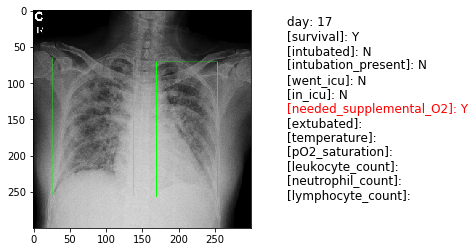

[Clincal Notes]: On January 20, 2020, a 55-year-old woman who worked in Wuhan, China, arrived at Taiwan Taoyuan International Airport and presented to quarantine officials immediately, with a history of sore throat, dry cough, fatigue, and low-grade subjective fever since January 11, 2020. Apart from a history of hypothyroidism with regular medical follow-up, she had no other underlying disease before this onset. Chest X-ray showed progression of prominent bilateral perihilar infiltration and ill-defined patchy opacities at bilateral lungs, which slowly resolved on the follow-up image.


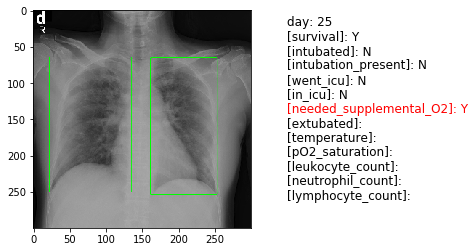

[Clincal Notes]: On January 20, 2020, a 55-year-old woman who worked in Wuhan, China, arrived at Taiwan Taoyuan International Airport and presented to quarantine officials immediately, with a history of sore throat, dry cough, fatigue, and low-grade subjective fever since January 11, 2020. Apart from a history of hypothyroidism with regular medical follow-up, she had no other underlying disease before this onset. Chest X-ray showed progression of prominent bilateral perihilar infiltration and ill-defined patchy opacities at bilateral lungs, which slowly resolved on the follow-up image.





Patient 20	[Gender]: M	[Age]: 
[Patient Location]: Jonkoping, Sweden


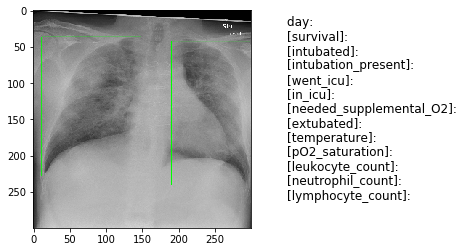

[Clincal Notes]: Elderly male, covid-19 positive. Fever and elevated c-reactive protein. Perihilar and apical, mostly peripheral,opacifications bilaterally.





Patient 21	[Gender]: F	[Age]: 50
[Patient Location]: Macao, China


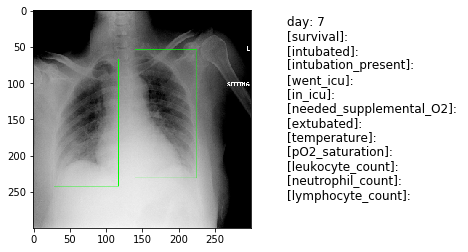

[Clincal Notes]: Productive cough with a sore throat for 1 week, no fever or chest pain, traveling to Macau from Wuhan 3 days prior, denied close contact with wet market. Multiple small bilateral areas of patchy confluent opacification, including a discrete rounded opacity in the right lower zone.





Patient 22	[Gender]: M	[Age]: 70
[Patient Location]: Riccione, Italy


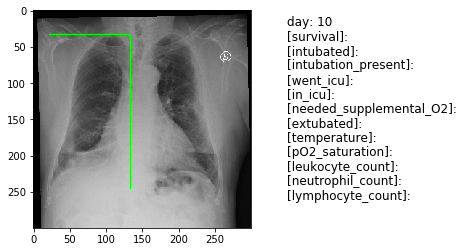

[Clincal Notes]: Fever, cough, breathing difficulties for about ten days. Vertical air space consolidation along the left costal margin.





Patient 23	[Gender]: F	[Age]: 70
[Patient Location]: Ospedale Santo Spirito. Rome, Italy


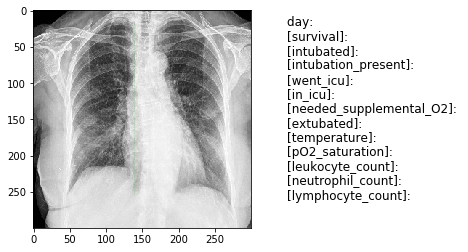

[Clincal Notes]: Admitted at A&E with shortness of breath. There is a coarsening of lung markings more evident at the lower fields (R>L) but no clear consolidation seen. Surgical clips overlie the right breast shadow.





Patient 24	[Gender]: M	[Age]: 75
[Patient Location]: Ospedale Santo Spirito. Rome, Italy


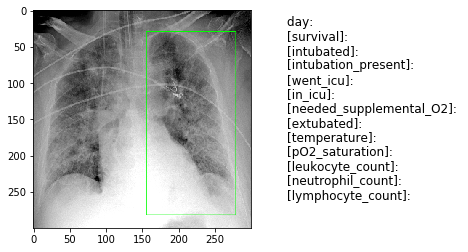

[Clincal Notes]: AP chest radiograph for CVC position shows the presence of extensive bilateral ground-glass opacities as demonstrated on the recent CT. Also right IJV catheter and ETT noted.





Patient 32	[Gender]: M	[Age]: 43
[Patient Location]: Italy


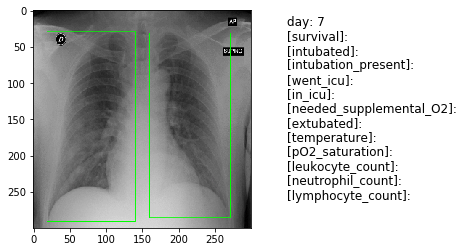

[Clincal Notes]: 43-year-old man, in the absence of known medical history pathologies.For 7 days fever and asthenia Blood count, PCR and procalciton in the norm. Extended and nuanced parenchymal thickening in the middle-lower right field.





Patient 33	[Gender]: M	[Age]: 62
[Patient Location]: Italy


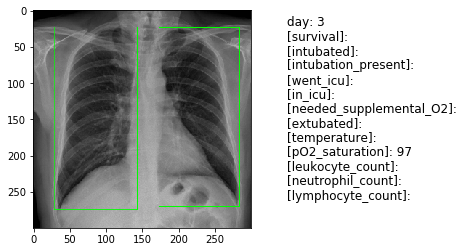

[Clincal Notes]: Remote history changes, not copatologies. Onset with asthenia, dry cough and 3 days serotin fever. pO 2 = 97% in air; PCR = 0.75.





Patient 34	[Gender]: M	[Age]: 45
[Patient Location]: Italy


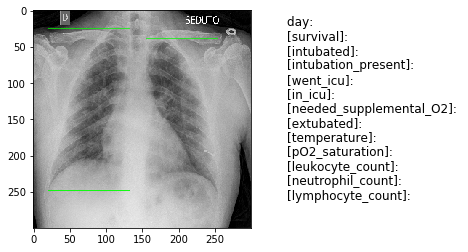

[Clincal Notes]: Chest X-ray (AP in bed). We compare the chest radiographic examination, performed a few hours before the CT investigation. Small and subtle bilateral opacities are evident. The radiographic investigation underestimates the degree of lung involvement.





Patient 35	[Gender]: M	[Age]: 43
[Patient Location]: Italy


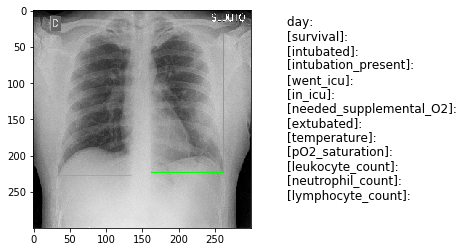

[Clincal Notes]: Chest X-ray (AP in bed): We compare the chest radiographic examination, performed a few hours before the CT scan. It is evident nuanced peripheral hypodiaphaly in the lower III of the left hemithorax. Data poorly correlated to CT findings, by underestimation.





Patient 36	[Gender]: M	[Age]: 67
[Patient Location]: Italy


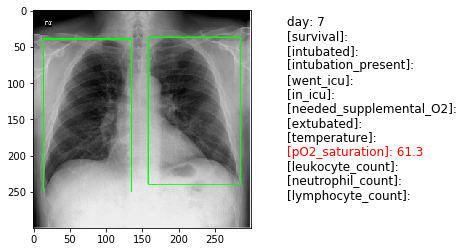

[Clincal Notes]: Chest radiogram at onset, performed on an outpatient basis in another hospital: o pleuroparenchymal thickenings; thickening of the peribronco-vascular interstitium. "


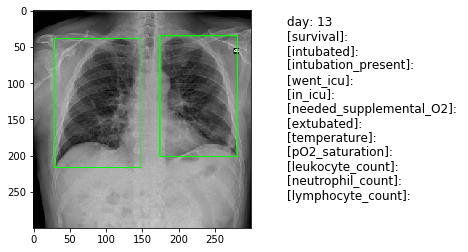

[Clincal Notes]: At the entrance: pO2 = 61.3% (emogas)





Patient 37	[Gender]: M	[Age]: 58
[Patient Location]: Italy


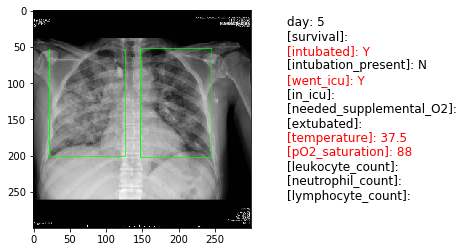

[Clincal Notes]: Upon entering PS: TC 37.5;SPO2 = 88%;Hemoglobin 11.50;GB 7250;Neutrophils 90.20%;Platelets 67000. Hospitalization and, in the light of the radiological finding, request for Covid 19 infectious disease assessment and research, which is positive. In the next hour worsening of dyspnea and need for hospitalization in Resuscitation.


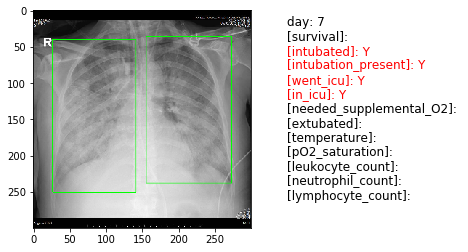

[Clincal Notes]: Upon entering PS: TC 37.5;SPO2 = 88%;Hemoglobin 11.50;GB 7250;Neutrophils 90.20%;Platelets 67000. Hospitalization and, in the light of the radiological finding, request for Covid 19 infectious disease assessment and research, which is positive. In the next hour worsening of dyspnea and need for hospitalization in Resuscitation.





Patient 39	[Gender]: M	[Age]: 50
[Patient Location]: Italy


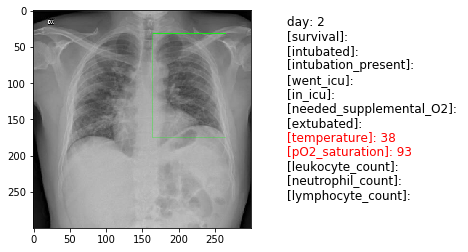

[Clincal Notes]: Male, 50 years old, non-co-pathological, symptomatic for two days, worsening, with dry cough, pyrexia over 38 � C, asthenia. 93% pO2 saturation is detected in ambient air. The radiological picture is typical for COVID-19 interstitial pneumonia.The patient is accompanied to the emergency room, subjected to a pharyngeal swab and hospitalized for appropriate treatment.





Patient 40	[Gender]: F	[Age]: 46
[Patient Location]: Italy


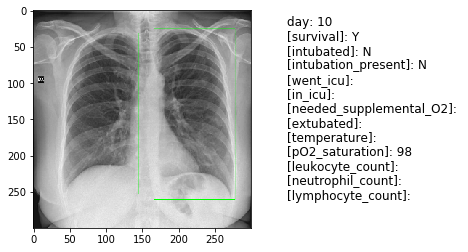

[Clincal Notes]: 46-year-old female, non-co-pathological, asymptomatic. 98% pO2 saturation is detected in ambient air. He reports nonspecific low back pain about 10 days ago, resolved spontaneously. In cohabitation with her husband (case 14), whom she accompanies, without personal protective equipment. CLINICAL DIAGNOSTIC PATH: following the radiological diagnosis of interstitial pneumonia of the husband, it was decided to subject the woman, although asymptomatic, to Standard Radiogram of the chest and subsequently to Basal CT of the chest. Chest x-ray: thickening of the peribroncovascular interstitium in the lower left pulmonary field.Multiple areas of small parenchymal thickening on the left both in the upper and lower lung field and on the right in the upper right lung field.No pleural effusion.Heart and small circle within limits.





Patient 41	[Gender]: M	[Age]: 71
[Patient Location]: Italy


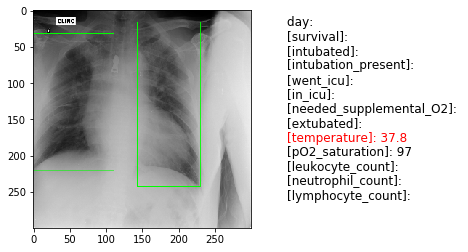

[Clincal Notes]: Male, 71 years old, travels to PS for fever (37.8 �) and cough, eupnoic. In history of ischemic heart disease. Saturation pO2 97%. Chest x-ray performed with portable device positioned in a tensile structure specifically used outside the PS. The radiographic investigation shows a widespread increase in the peribroncovascular interstitial plot with associated multiple areas of parenchymal thickening arranged mainly at the level of the upper field of both lungs.Heart increased in volume;hypo-expanded but free of pouring costofrenic sinuses.





Patient 42	[Gender]: F	[Age]: 69
[Patient Location]: Italy


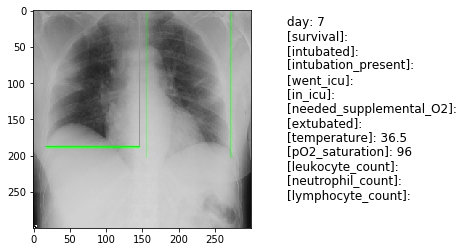

[Clincal Notes]: Women, 69 years old, has reported fever since one week treated with antibiotics without benefit. In the anamnesis, he does not report any noteworthy pathologies. PS temperature in the normal range (36.5 �), pO2 96%, eupnoic. The radiographic investigation shows a discrete increase in the peribroncovascular interstitium with associated some nuanced parenchymal thickenings at the base of both lungs.Cardiomediastinal shadow in the norm.Normo-expanded costophrenic sinuses





Patient 43	[Gender]: M	[Age]: 27
[Patient Location]: Italy


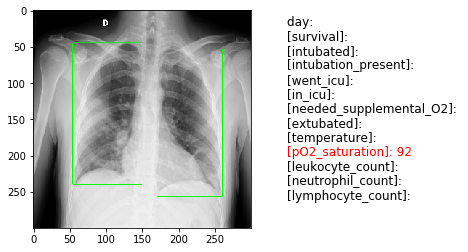

[Clincal Notes]: Male, 27 years old, transferred from another hospital for suspected pneumonia. Deny other pathologies. Deny contact with COVID-19 positive Pcs and with people from risk areas. Eupnoic, apiretic with 92% pO2. The radiographic investigation demonstrates the presence of an increase in the peribroncovascular interstitial plot with associated parenchymal thickenings especially in the basal and lateral subpleural site at the level of the middle-upper field of the right lung.





Patient 44	[Gender]: F	[Age]: 78
[Patient Location]: Italy


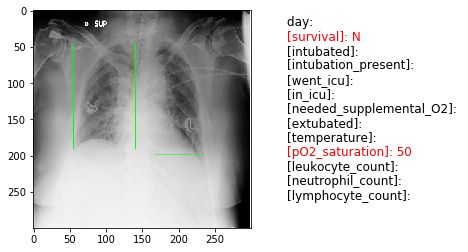

[Clincal Notes]: Woman, 78 years old, transported since 118 from another hospital for acute respiratory failure. Conscious, tachypnoic, apyretic with 50% pO2. Chest x-ray required, hospitalized in resuscitation and predisposed to nasopharyngeal swab (COVID-19 positive). The X-ray investigation demonstrates a widespread increase in the peribroncovascular interstitial plot with associated bilateral bilateral thickening, especially on the right.





Patient 45	[Gender]: F	[Age]: 71
[Patient Location]: Italy


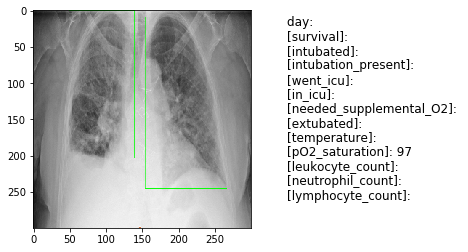

[Clincal Notes]: Woman, 71 years old, reports dyspnea and fever. In anamnesis COPD, IRC, arterial hypertension, DM, mitral valve replacement. In slightly tachypnoic PS, apyretic with 97% pO2. Deny contact with COVID-19 positive Pcs and with people from risk areas. The X-ray investigation demonstrates a widespread increase in the peribroncovascular interstitial plot with associated bilateral bilateral parenchymal thickening.Pleural effusion on the right with obliteration of the costophrenic sinus on this side.





Patient 46	[Gender]: F	[Age]: 55
[Patient Location]: Italy


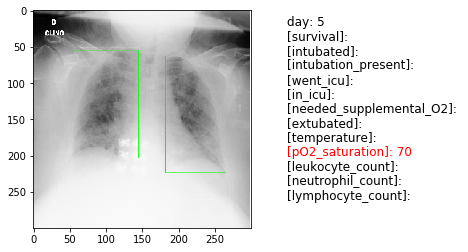

[Clincal Notes]: Woman, 55 years old, reports dyspnea for a few days, does not report fever. In the history of asthma and type II diabetes. At first he denies contacts with people in a feverish state and coming from areas at risk. After a more accurate and "insistent" anamnesis, he reports that the cohabiting son works in a company where COVID-19 cases have occurred in the risk area (Lombardy).





Patient 47	[Gender]: F	[Age]: 58
[Patient Location]: Italy


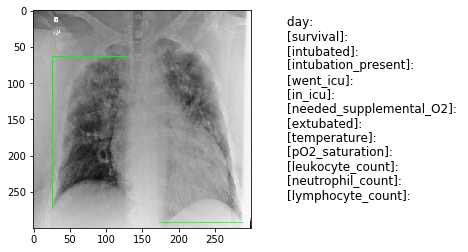

[Clincal Notes]: Woman, 58, has been reporting wheezing and fever for over a week. COPD history and dilated cardiomyopathy with severe congestive heart failure (FE 25%); severe obesity. The patient reports that she has not been in regions and / or cities with epidemic outbreaks nor has she received people from areas at risk. The radiographic investigation shows a widespread increase in the peribroncovascular interstitial plot with associated multiple areas of parenchymal thickening arranged in correspondence with the upper field of both lungs. Heart increased in volume; hypo-expanded but free of pouring costofrenic sinuses. The X-ray pattern confirms the presence of bilateral interstitial pneumonia strongly suspected for a positivity to COVID-19.





Patient 48	[Gender]: M	[Age]: 68
[Patient Location]: Italy


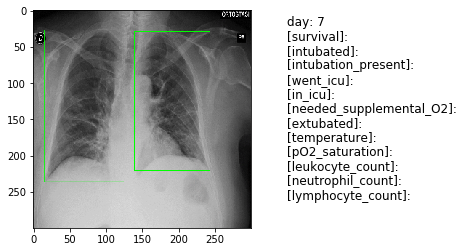

[Clincal Notes]: 68-year-old man with chronic lymphatic leukemia in follow-up, high blood pressure and dyslipidemia. For 7 days, hyperpyrexia with dyspnoea and diarrheal alve has appeared. Leukocytosis, elevated PCR and normal procalcitonin. Multiple bilateral ribbon-like parenchymal thickenings.No pleural effusion.





Patient 49	[Gender]: M	[Age]: 64
[Patient Location]: Italy


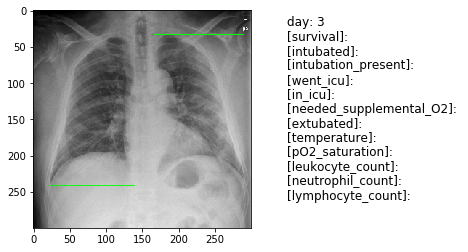

[Clincal Notes]: 64 year old man suffering from diabetes mellitus and hypertension. Dyspnoea, cough and hyperpyrexia for 3 days. Normal blood count and procalcitonin. High PCR (13.44 mg / dL). Multiple bilateral parenchymal thickenings.





Patient 50	[Gender]: M	[Age]: 63
[Patient Location]: Italy


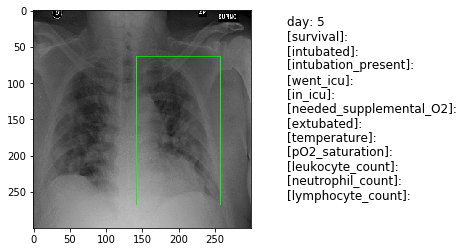

[Clincal Notes]: 63 year old man with night apnea in home CPAP. For 5 days fever, asthenia, pharyngodynia and diarrheal alvo. High PCR (16.27 mg / dL), normal hematocrit and procalcitonin. Extended and multiple bilateral parenchymal thickenings.





Patient 51	[Gender]: M	[Age]: 47
[Patient Location]: Italy


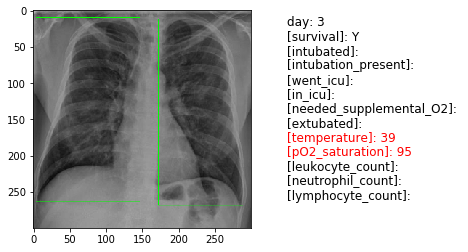

[Clincal Notes]: Male patient, 47 years old. Remote history changes, not co-pathologies. Onset March 1, 2020 with asthenia, arthralgias, headache, dry cough and pyrexia 39 �. pO 2 = 95% in ambient air. PS access on March 4, 2020. There are some nuanced bilateral alveolar infiltrative thickenings in a picture of onset alveolar interstitial pneumonia.


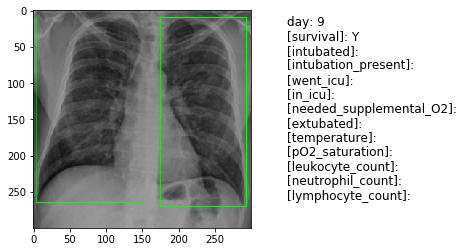

[Clincal Notes]: Appearance of pulmonary parenchymal thickenings, some with interstitial changes.





Patient 52	[Gender]: F	[Age]: 72
[Patient Location]: Italy


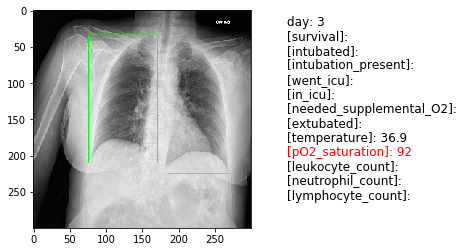

[Clincal Notes]: 72-year-old woman shows up on March 5, 2020 in PS with fever and dyspepsia with diarrheal episodes for about 3 days. Patient in close contact with another positive COVID person in the last days of February. Medical history: diabetic in oral treatment Physical examination: good general conditions, eupnoic, norm-transmitted FVT; temperature 36.9 � C, saturation 92%. Laboratory tests at the entrance (07/03/2020) after admission to the Tropical Diseases ward: GB 4.6 U / l, lymphocytopenia (0.7 U / L) .; PCR 80 mg / l. Laboratory tests of 10/03/2020: GB 6.1 U / l; lymphocytes 0.7 U / l; PCR 141 mg / l. Bilateral parenchymal consolidations at the posterior regions of the lower lung lobes, bilaterally.Subpleural nodules at the anterior segments of the left upper lung lobe.Multiple frosted glass opacities across the lung.No pleural effusion.





Patient 53	[Gender]: M	[Age]: 53
[Patient Location]: Italy


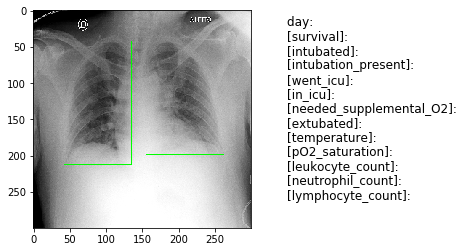

[Clincal Notes]: Patient of 53 years, with arterial hypertension in pharmacological treatment and with recent CT-scan of significant monovasal obstructive epicardial coronary artery disease, on the list for coronary angiography, enters PS for syncopal episode in the absence of angor, dyspnoea and declining edemas. The patient at admission is apiretic (T: 36 � C) and denies potential contacts with patients with COVID-19 or recent stay in areas at risk. Laboratory tests on admission reveal a slight reduction in white blood cells (3.47 x10 ^ 3 / ul; vn 4.5 - 10.0) in the absence of significant lymphopenia, increased fibrinogen (650 mg / dL vn 150-450 ), negative troponin, ESR within the limits (13 mm / h; vn <15). In the evening he develops a slight increase in body temperature (T 37 � C) and performs negative chest X-ray for defined parenchymal alterations.





Patient 54	[Gender]: M	[Age]: 73
[Patient Location]: Italy


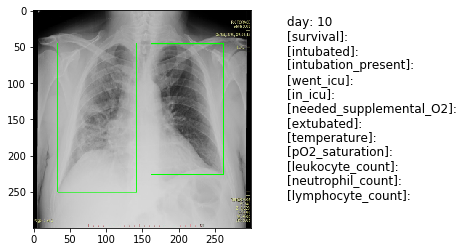

[Clincal Notes]: 73-year-old male patient. He enters Mortara's PS for a 10-day fever not responsive to paracetamol. WBC within limits, PCR not available PS radiography at Mortara Hospital (fever indication). Feedback of right interstitial paracardial thickening with tendency to cavitation in its most cranial portion.Mild right hilar enlargement.The phlogistic-infectious nature is hypothesized.





Patient 55	[Gender]: M	[Age]: 87
[Patient Location]: Italy


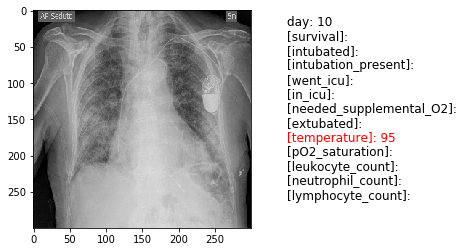

[Clincal Notes]: Male patient, 87 years old, hospitalized from 02/27 to 01/03/2020 with diagnosis of right heart failure in hypertensive heart disease and PM, regressed with diuretic therapy. At home, unproductive cough without fever. Progressive dyspnea for which he is transported to DEA on 07/03. Apiretic patient, bilateral middle-basal crepitations. Chest x - ray: bilateral middle - basal pulmonary parenchymal thickening, more evident on the right.





Patient 56	[Gender]: F	[Age]: 82
[Patient Location]: Italy


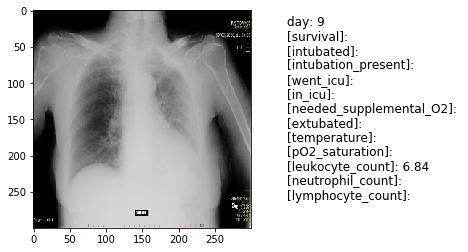

[Clincal Notes]: 82 year old female patient. On 3/3 he enters the PS of Vigevano for dyspnea and fever for 7 days, in anamnesis k renal and arterial hypertension. Blood chemistry tests: WBC 6.84; PCR 106.93 (limit 5); VES 45 (limit 15); LDH 314 (limit 214); Glucose 137. Findings of alterations in the interstitium of the left hemithorax with discrete diffuse reduction in pulmonary transparency, greater in the peripheral area, and in suspected traces of effusion. Pleural parenchymal findings within the limits on the right. No signs of heart failure. TC deepening is recommended.





Patient 57	[Gender]: F	[Age]: 67
[Patient Location]: Hospital of Wuhan University, Wuhan, China


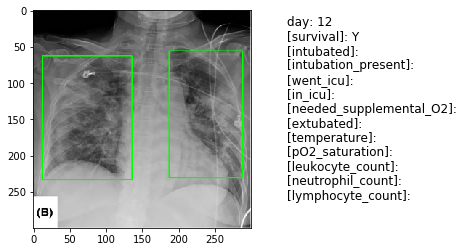

[Clincal Notes]: Chest Xay and CT images of a 67ld woman with onset of cough and sputum on January 1, 2020, and progressively developed dyspnea. A, Transverse CT scan image on January 9 showing multiple lobular and segmental consolidation combined with groundlass opacities diffusely distributed in bilateral lung field. B, Chest Xay showing extended bilateral consolidation on January 12. C, The attenuation and the involvement of the consolidation decreased in chest Xay of January 17 (D) CT scan on January 22 showing absorption of bilateral consolidation, scattered fibrous can be observed. The symptoms and dyspnea of the patient improved after treatment, and the patient was discharged on January 24


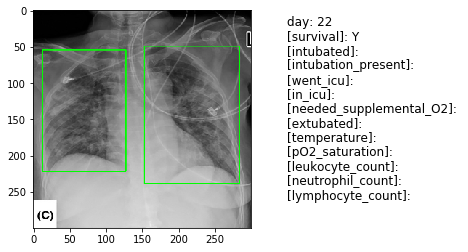

[Clincal Notes]: Chest Xay and CT images of a 67ld woman with onset of cough and sputum on January 1, 2020, and progressively developed dyspnea. A, Transverse CT scan image on January 9 showing multiple lobular and segmental consolidation combined with groundlass opacities diffusely distributed in bilateral lung field. B, Chest Xay showing extended bilateral consolidation on January 12. C, The attenuation and the involvement of the consolidation decreased in chest Xay of January 17 (D) CT scan on January 22 showing absorption of bilateral consolidation, scattered fibrous can be observed. The symptoms and dyspnea of the patient improved after treatment, and the patient was discharged on January 24





Patient 58	[Gender]: M	[Age]: 36
[Patient Location]: Hospital of Wuhan University, Wuhan, China


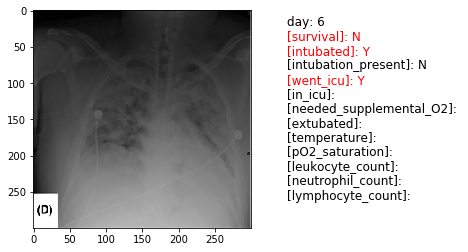

[Clincal Notes]: Chest Xay and CT scan images of a 36ld man without history of smoking. The patient had fever, cough, and diarrhea on January 6, 2020. A, Transverse CT images on January 9. A, Bilateral multiple groundlass opacities, most of them are irregular small round lesions scattered in the lung field in upper lobe. B, Bilateral multiple irregular groundlass opacities and a wedgehaped opacity located in the right upper lobe under the pleura. C, Bilateral multiple irregular groundlass opacities and a small nodular opacity located in the left lower upper lobe under the pleura. D, The symptoms of the patient deteriorated on January 12, chest Xay showing bilateral diffuse patchy and consolidation, soalled hite lung.E, Chest Xay after intubation and mechanical ventilation on January 13, the attenuation lowered down, leaving scattered small irregular consolidation. F, On January 20, bilateral lung lesions deteriorated, and bilateral costophrenic angles were not clearly displayed, sugges

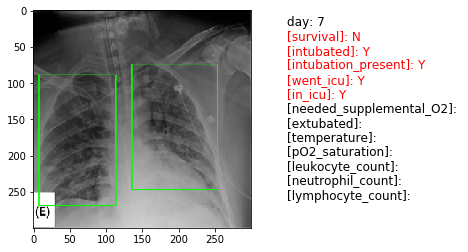

[Clincal Notes]: Chest Xay and CT scan images of a 36ld man without history of smoking. The patient had fever, cough, and diarrhea on January 6, 2020. A, Transverse CT images on January 9. A, Bilateral multiple groundlass opacities, most of them are irregular small round lesions scattered in the lung field in upper lobe. B, Bilateral multiple irregular groundlass opacities and a wedgehaped opacity located in the right upper lobe under the pleura. C, Bilateral multiple irregular groundlass opacities and a small nodular opacity located in the left lower upper lobe under the pleura. D, The symptoms of the patient deteriorated on January 12, chest Xay showing bilateral diffuse patchy and consolidation, soalled hite lung.E, Chest Xay after intubation and mechanical ventilation on January 13, the attenuation lowered down, leaving scattered small irregular consolidation. F, On January 20, bilateral lung lesions deteriorated, and bilateral costophrenic angles were not clearly displayed, sugges

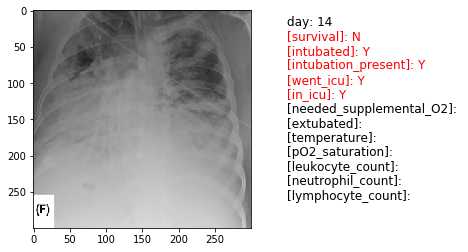

[Clincal Notes]: Chest Xay and CT scan images of a 36ld man without history of smoking. The patient had fever, cough, and diarrhea on January 6, 2020. A, Transverse CT images on January 9. A, Bilateral multiple groundlass opacities, most of them are irregular small round lesions scattered in the lung field in upper lobe. B, Bilateral multiple irregular groundlass opacities and a wedgehaped opacity located in the right upper lobe under the pleura. C, Bilateral multiple irregular groundlass opacities and a small nodular opacity located in the left lower upper lobe under the pleura. D, The symptoms of the patient deteriorated on January 12, chest Xay showing bilateral diffuse patchy and consolidation, soalled hite lung.E, Chest Xay after intubation and mechanical ventilation on January 13, the attenuation lowered down, leaving scattered small irregular consolidation. F, On January 20, bilateral lung lesions deteriorated, and bilateral costophrenic angles were not clearly displayed, sugges

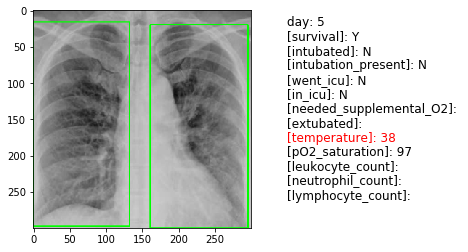

[Clincal Notes]: Chest X-ray films of the case of COVID-19. (A) Hospital day 1: increased pulmonary infiltrations, esp. in left lung field (white arrows). (B) Hospital day 14: Resolution of pulmonary infiltrates at left lung field (white arrows).


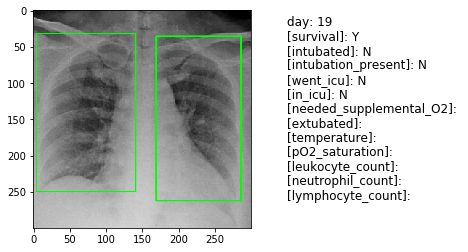

[Clincal Notes]: Chest X-ray films of the case of COVID-19. (A) Hospital day 1: increased pulmonary infiltrations, esp. in left lung field (white arrows). (B) Hospital day 14: Resolution of pulmonary infiltrates at left lung field (white arrows).





Patient 60	[Gender]: F	[Age]: 71
[Patient Location]: China


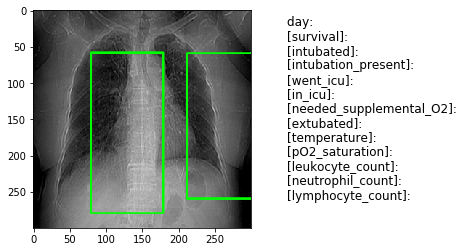

[Clincal Notes]: Chest x-ray images and chest CT images from a 71-year-old woman showing that there are scattered high-density shadows with fuzzy patches in the lower lobes of the two lungs, with ground glass like changes, with clear hilar structure, unobstructed trachea, no displacement of mediastinum, no enlarged lymph node shadow, and local thickening of bilateral pleura;





Patient 61	[Gender]: M	[Age]: 38
[Patient Location]: China


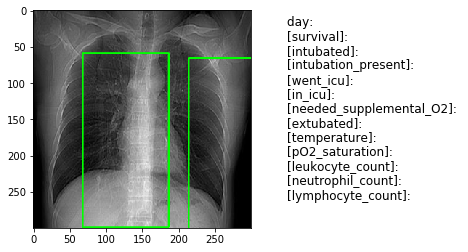

[Clincal Notes]: Chest x-ray images and chest CT images from a 38-year-old man showing that there are small patchy ground glass like density increasing shadow in the upper and lower lobes of the left lung, with clear hilar structure, unobstructed trachea, no mediastinum displacement, no enlarged lymph node shadow, and no abnormality of pleura on both sides;





Patient 62	[Gender]: M	[Age]: 12
[Patient Location]: China


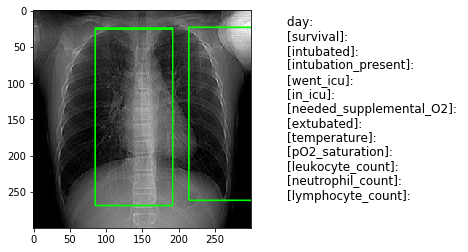

[Clincal Notes]: Chest x-ray images and chest CT images from a 12-year-old boy showing that there was no abnormal density shadow in the parenchyma of both lungs, the structure of pulmonary hilus was clear, the trachea was unobstructed, mediastinum was not displaced, and no enlarged lymph node shadow was found.





Patient 63	[Gender]: 	[Age]: 
[Patient Location]: South Korea


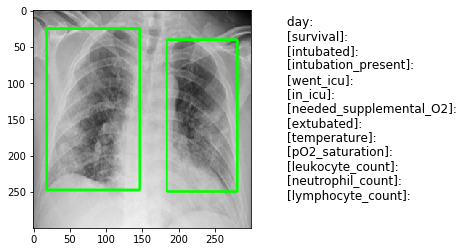

[Clincal Notes]: COVID-19 pneumonia. Anteroposterior chest radiograph shows multifocal patchy peripheral consolidations in bilateral lungs, except for left upper lung zone.





Patient 64	[Gender]: 	[Age]: 
[Patient Location]: South Korea


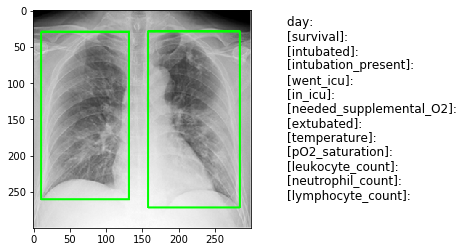

[Clincal Notes]: COVID-19 pneumonia. Baseline anteroposterior chest radiograph shows patchy ground-glass opacities in right upper and lower lung zones and patchy consolidation in left middle to lower lung zones. Several calcified granulomas are incidentally noted in left upper lung zone.





Patient 65	[Gender]: 	[Age]: 
[Patient Location]: South Korea


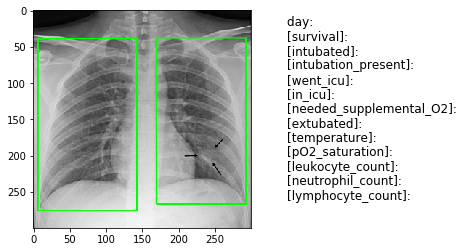

[Clincal Notes]: COVID-19 pneumonia manifesting as single nodular lesion. Anteroposterior chest radiograph shows single nodular consolidation (arrows) in left lower lung zone.





Patient 67	[Gender]: 	[Age]: 
[Patient Location]: Taiwan


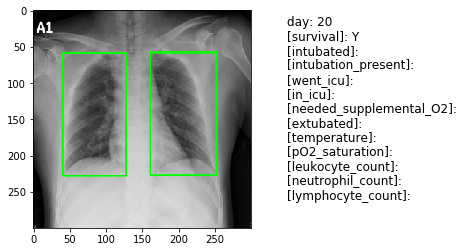

[Clincal Notes]: No active lung lesion was noted in patient A on admission (16 February


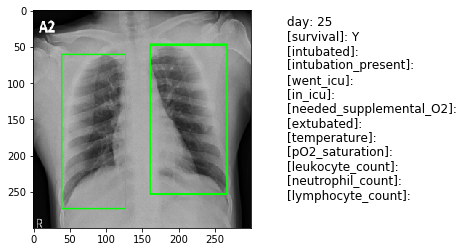

[Clincal Notes]: right upper lung interstitial infiltrates were st presented on day 6 on admission (21 February





Patient 68	[Gender]: 	[Age]: 
[Patient Location]: Taiwan


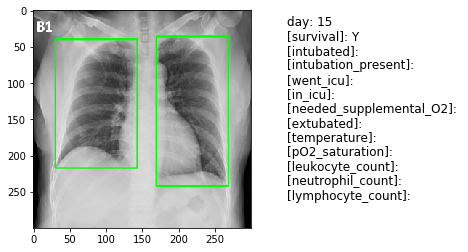

[Clincal Notes]: Left lower lung interstitial infiltrates were noted in patient B on admission and persisted to day 5 of admission (normal white blood cell (WBC) counts without lymphocytopenia and the neutrophil to lymphocyte ratio in the normal range)


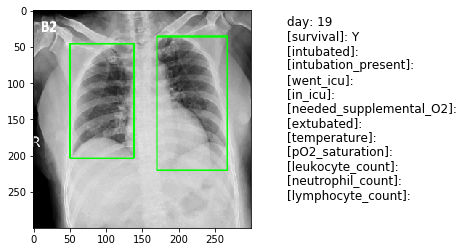

[Clincal Notes]: Left lower lung interstitial infiltrates were noted in patient B on admission and persisted to day 5 of admission (normal white blood cell (WBC) counts without lymphocytopenia and the neutrophil to lymphocyte ratio in the normal range)





Patient 69	[Gender]: F	[Age]: 25
[Patient Location]: Thanh H�a, Vietnam


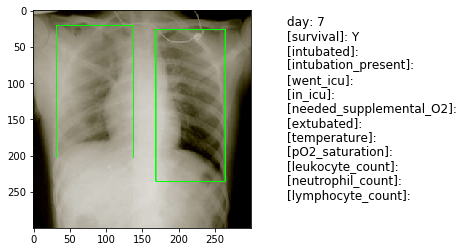

[Clincal Notes]: X-ray done at admission (January 24). On admission to hospital, the patient was alert but exhausted, with mild chest pain, a temperature of 39�2�C, blood pressure of 120/70 mm Hg, a pulse of 100 beats per min, and a respiratory rate of 25 breaths per min. The patient had no crackles or bronchi rales on lung auscultation. All other clinical findings were normal. Initial laboratory tests showed a white blood cell count of 3�7 06/L, a red blood cell count of 4�28 09/L, a platelet count of 185 06/L, and a haemoglobin concentration of 127 g/L. Chest radiography showed no abnormalities


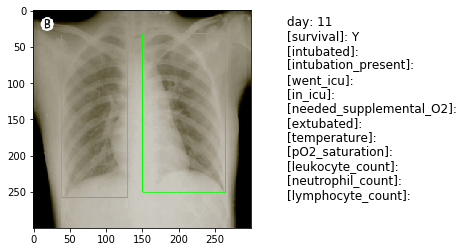

[Clincal Notes]:  X-ray done 4 days after admission (January 28). The patient had a high fever, dry cough, and chest pain for the first 2 days. On day 3, her fever subsided and her clinical condition began to improve.





Patient 70	[Gender]: M	[Age]: 65
[Patient Location]: Italy


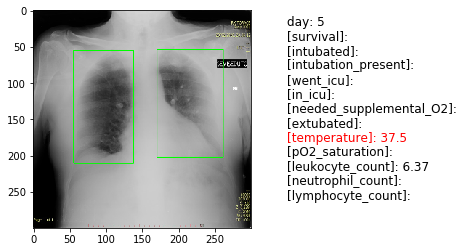

[Clincal Notes]: entered the emergency room of Vigevano for fever (37.5 �) and cough for a few days. Blood chemistry tests: WBC 6.37 D-DIMERO <150 GLUCOSE 140 PCR 70.99 (limit 5) LDH 326 (limit 225). Mild hypotransprence of left hemithorax in hypo-expanded thorax. No other relevant findings. 


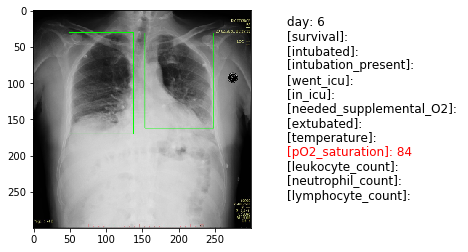

[Clincal Notes]: Hypo-expanded thorax with disventilation of the lung bases and nuanced thickening of the lung fields, greater than left. Right paratracheal calcific lymph nodes. No signs of heart failure.





Patient 71	[Gender]: M	[Age]: 61
[Patient Location]: Italy


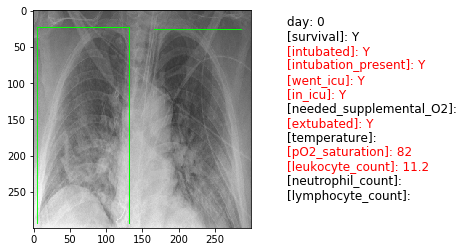

[Clincal Notes]: On March 3, 2020 he accesses the DEAS of the AOU Careggi (Florence) for severe dyspnea, mental confusion and prolonged lodging for recent upper airway infection; non-smoker, diabetes mellitus in insulin therapy and high blood pressure. Blood chemistry tests: WBC 11.2;PCR 301 (VN <5);LDH 738 (VN 135-225);Fibrinogen 798 (VN 200-400);INR 1.4.Blood gas analysis: PaO2 82;PCO2 32. 


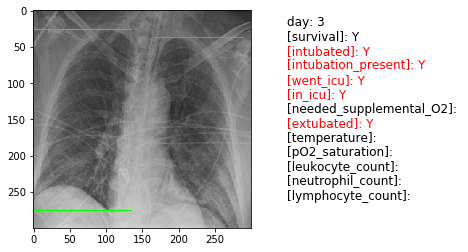

[Clincal Notes]: Pulmonary picture improvement.


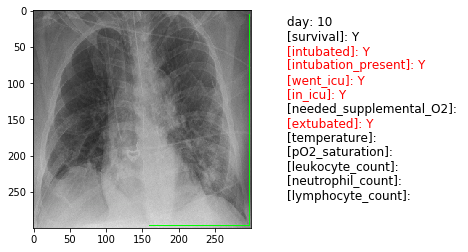

[Clincal Notes]:  increase in procalcitonin 1.96 (lower limit 0.5). Appearance of parenchymal area of sedimentation in basal site sn suspected for bacterial superinfection.





Patient 72	[Gender]: M	[Age]: 60
[Patient Location]: Italy


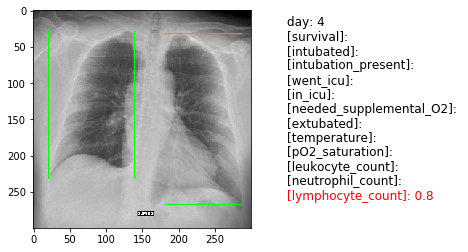

[Clincal Notes]: abdominal pain and hyperpyrexia for 4 days, denies coughing or dyspnoea. normal language, integral and symmetric force, not motor deficits, integral sensitivity.Flat and manageable abdomen.Negative Blumberg.Murphy negative.Jordanian negative.Peristalsis present.Vesicular murmur present, no pathological noises. Laboratory tests at the entrance: lymphocytes 0.8 x 10E9 / L;PCR 95 mg / L;positive buffer for COVID19. 





Patient 73	[Gender]: F	[Age]: 
[Patient Location]: The Royal Melbourne Hospital, Melbourne, Australia


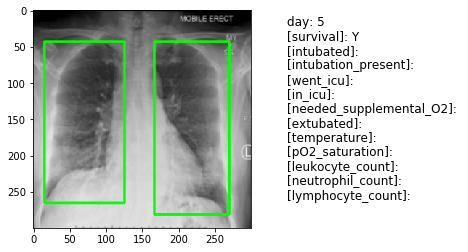

[Clincal Notes]: Chest radiography demonstrated bi-basal infiltrates at day 5 that cleared on day 10. Blood C-reactive protein was elevated at 83.2, with normal counts of lymphocytes (4.3 ? 109 cells per liter (range, 4.0 ? 109 to 12.0 ? 109 cells per liter)) and neutrophils (6.3 ? 109 cells per liter (range, 2.0 ? 109 to 8.0 ? 109 ? 109 cells per liter)). No other respiratory pathogens were detected. Her management was intravenous fluid rehydration without supplemental oxygenation. No antibiotics, steroids or antiviral agents were administered.


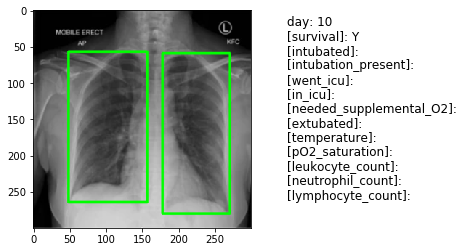

[Clincal Notes]: Chest radiography demonstrated bi-basal infiltrates at day 5 that cleared on day 10. Blood C-reactive protein was elevated at 83.2, with normal counts of lymphocytes (4.3 ? 109 cells per liter (range, 4.0 ? 109 to 12.0 ? 109 cells per liter)) and neutrophils (6.3 ? 109 cells per liter (range, 2.0 ? 109 to 8.0 ? 109 ? 109 cells per liter)). No other respiratory pathogens were detected. Her management was intravenous fluid rehydration without supplemental oxygenation. No antibiotics, steroids or antiviral agents were administered.





Patient 74	[Gender]: M	[Age]: 50
[Patient Location]: 


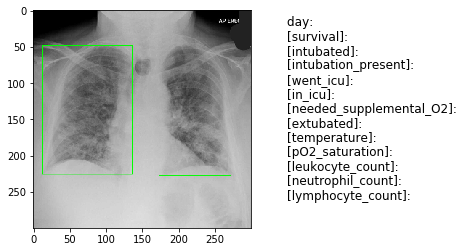

[Clincal Notes]: 





Patient 75	[Gender]: F	[Age]: 75
[Patient Location]: Laniado Hospital, Netanya, Israel


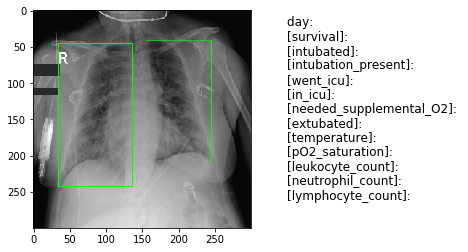

[Clincal Notes]: Bronchial wall thickening. Small peripheral patchy infiltrates.





Patient 76	[Gender]: F	[Age]: 40
[Patient Location]: Jiangxi Provincial People's Hospital, Nanchang, China


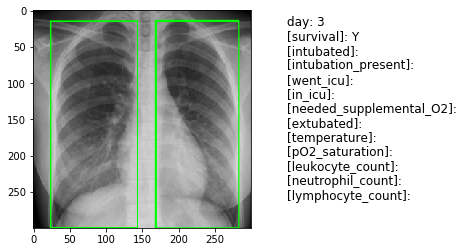

[Clincal Notes]: 40-year-old female patient with Coronavirus disease 2019 pneumonia. Initial posteroanterior chest radiograph and chest CT scan were performed on day of admission (3 days after onset of fever). Chest radiograph(A)shows no thoracic abnormalities. Axial CT scan(B)shows GGOs in subpleural area of right lower lobe. Left lung is normal. Patchy consolidations and GGOs in both lungs were almost absorbed leaving a few fibrous lesions that may represent residual organizing pneumonia. Repeat real-time reverse-transcriptase-polymerase chain reaction was negative and patient was discharged.





Patient 77	[Gender]: F	[Age]: 65
[Patient Location]: Italy


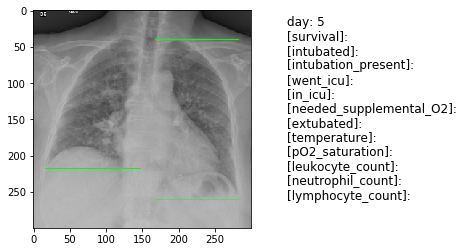

[Clincal Notes]: Female patient, 65 years old, in a pathological history of bariatric surgery, bipolar syndrome. Non-smoker. Pathological history of the next change, in particular negative due to contact with positive Covid-19 patients. He arrives in PS for cough and chest tightness, without fever. At EGA pH 7.44, pCO2 37mmHg, pO2 69mmHg, HCO3 25mmol / l in ambient air. At EE Gb 12.420 / ul, Hb 9.8G / dl, creatinine and ionemia within limits, PCR 178 mg / l. Initially no buffer for COVID-19. accentuation of the bilateral interstitial-vascular weft and multiple patches of parenchymal thickening on the right. Free your breasts cost frantic.





Patient 78	[Gender]: M	[Age]: 
[Patient Location]: Italy


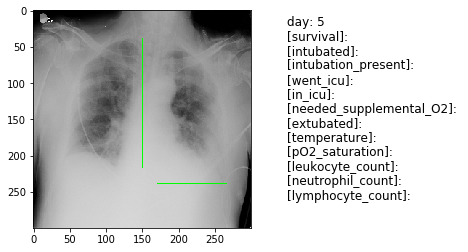

[Clincal Notes]: The patient has been receiving cough and dyspnoea for about 5 days and has therefore taken first therapy with amoxicillin / clavulanic acid per os and subsequently im ceftriaxione without benefit. He reports that he made a train journey from Florence to Rome (train from Venice) during which he had contacts with people from the red zone on 24 February. Patient with arterial hypertension in home therapy with Neolotan and Tiklid. On physical examination, it appears slightly tachypnoic at rest, asymptomatic for thoraco-abdominal pain, complains of dyspnea, MV diffusely reduced, basal crepitation on the left. Softened confluent densities with peripheral distribution with associated thickening of the interstitial weft. No pleural effusion.





Patient 79	[Gender]: M	[Age]: 33
[Patient Location]: 


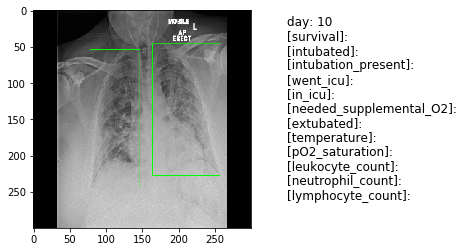

[Clincal Notes]: A 33 year old male presented to ED with 10 days of malaise and dry cough then 3 days of Haemoptysis, shortness of breath, pleuritic chest pain and dizziness. He has no past medical history but he is morbidly obese (BMI 58.1 kg/m2). No family or travel history. His O2 saturation was initially 58% on room air and 89% on 15 litres of Oxygen via non-rebreather mask, Heart rate of 146 and Blood pressure of 143/81. Chest X-Ray shows extensive bilateral inflammatory changes. Basic blood tests show raised inflammatory markers (CRP 135), raised D-dimers and normal lymphocytes. CT Pulmonary Angiography revealed Widespread patchy airspace change likely pulmonary haemorrhages. Patient was admitted to ITU and had full immunology , virology, microbiology and rheumatology screens done. He tested negative for all investigations done including HIV, HCV, HBV, TB and connective tissue diseases. Patient tested positive of COVID-19. He later deteriorated and required invasive support. Pati

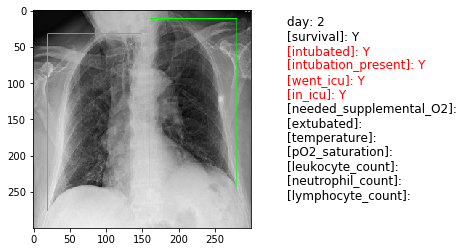

[Clincal Notes]: 84M with COPD, HFpEF, and BPH with recurrent UTIs. Was in his USOH and recovering from recent admission for UTI and subsequent stay in short-term rehab 2 weeks ago. Found unresponsive by wife at home with labored breathing. Afebrile, hypoxic and tachycardic in the field, arrived to ED on non-rebreather satting well but altered and in respiratory distress, intubated for airway protection. CBC/BMP completely unremarkable aside from anion gap of 19 and leukocytosis 16. CXR (image 1) showed some questionable linear opacities compared to recent prior, and there was concern for infection given #COVID-19 epidemic and respiratory distress. However further labs revealed POC trop 2.16, BNP 4K, VBG pH 7.37, lactate 4.3. EKG showed new RBBB and S1Q3T3 pattern (image 2, right). Echo (image 2, left) showed severely dilated RV, apical hypokinesis and McConnell's sign. PERT code was activated and pt was taken for stat CTA (image 3) revealing massive #Pulmonaryembolism (?saddle) but pr

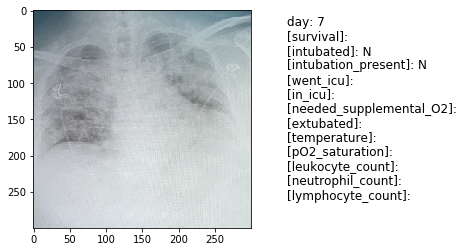

[Clincal Notes]: 44M untreated DM2 (A1C 11), no other medical issues or comorbidities, now confirmed #COVID-19 Presented with 1 week of GI-predominate symptoms (epigastric pain, poor PO, 1 episode of vomiting at onset). Progressed to myalgias and non-productive cough but really presented for GI symptoms. Hypoxic to low 90s on RA at presentation, febrile to 101. Rapidly devloped hypoxemic respiratory failure over course of several hours, RA -> max NC -> non-rebreather. So far not requiring intubation. Started on trial of liponavir/ritonavir. L CXR at presentation, R several months prior.





Patient 82	[Gender]: F	[Age]: 52
[Patient Location]: Italy


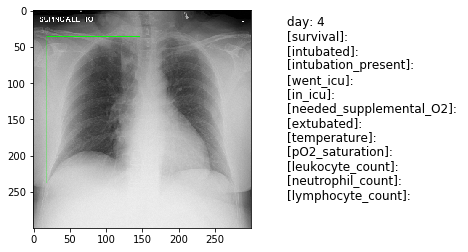

[Clincal Notes]: Cuneo 52 year old female patient, for about 4 days fever and malaise, worsening. He enters DEA for syncope after urination with head trauma and left hemicostat trauma. APR: asthma, in therapy with Montelukast in the evening, Beclometasone + Formoterol 1 puff x 4. Normal blood count, PCR 10.12 mg / L, PCT 0.13 ng / mL; LDH 279 U / L. Research SARS-CoV-2 (COVID-19) RNA on nasopharyngeal swab: DETECTED. No radiographic images of pleuro-pulmonary lesions in activity. Cardio-vasal shadow within the limits.





Patient 83	[Gender]: M	[Age]: 40
[Patient Location]: Italy


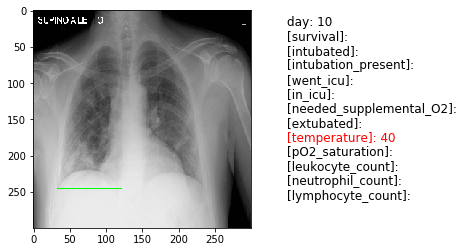

[Clincal Notes]: A 40-year-old male patient, he entered the DEA on 13/03/2020 for fever and from now dyspnea. Previous pneumonia, former smoker.  Returned on 5/03 from Milan (where he currently lives), for about 10 days fever; already started treatment with Amoxicillina + A. Clavulanico and Levofloxacina for some days without benefit.   On physical examination: T � 40 � C and dyspnea, without significant bronchial secretions, few humid noises. Hemodynamically stable, preserved diuresis.  At EGA: hypoxemia (PaO2 63.4 mmHg), mild respiratory alkalosis (pH 7.5, pCO2 35 mmHg) and blood tests, increase in inflammation indexes with: PCR: 87.16 mg / L, Fibrinogen: 621 mg / dL, Procalcitonin: 0.16 ng / ml, LDH: 328 U / L. which shows uneven bilateral pulmonary thickening more evident in the right basal site (expression in the first hypothesis of SARS VOC 2 infectious foci) with cardiac shadow of limited size.





Patient 84	[Gender]: M	[Age]: 60
[Patient Location]: Italy


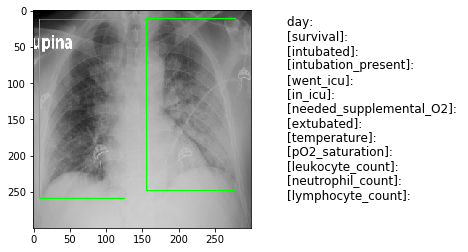

[Clincal Notes]: 60 year old man  Dyspnea and hyperthermia appear  APR: DMT2, dyslipidemia, high blood pressure, ex-heavy smoker. widespread parenchymal thickening in the middle and lower third of the left hemithorax; further, more nuanced parenchymal thickening in the right basal site.





Patient 85	[Gender]: M	[Age]: 30
[Patient Location]: Italy


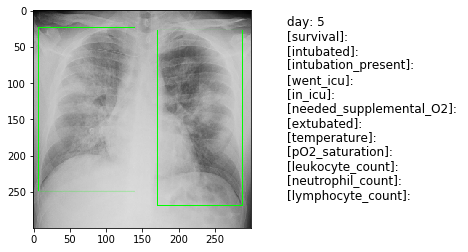

[Clincal Notes]: 30 year old man. General malaise and 5-day fever, 2-day cough and breathing difficulties. APR: silent. Bilateral parenchymal thickening, more evident on the right, of an inflammatory nature.  





Patient 86	[Gender]: M	[Age]: 60
[Patient Location]: Italy


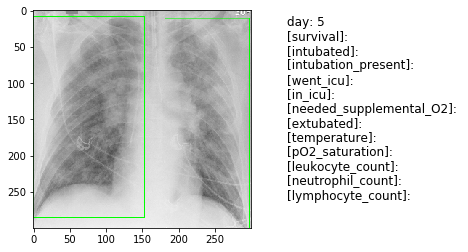

[Clincal Notes]: 60 year old man Dyspnea and fever onset APR: silent. Bilateral "ground glass" parenchymal thickenings with a phlogistic aspect on both upper lobes.


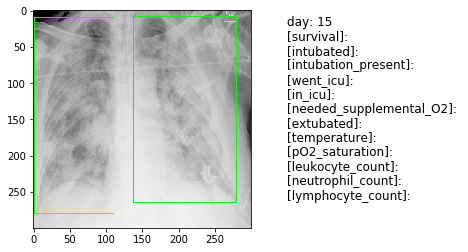

[Clincal Notes]: the appearance, on both sides, also in correspondence of the middle-lower fields, of multiple parenchymal thickening tending to the confluence, possible expression of bronchopneumonic foci.





Patient 93	[Gender]: M	[Age]: 55
[Patient Location]: Tehran, Iran


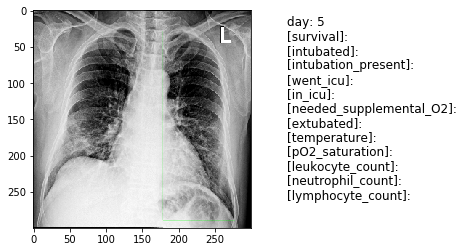

[Clincal Notes]: Fever and non-productive cough start from 5 days ago. Patchy peripheral opacities are seen at the lung fields mid to lower zones.  Bilateral multi-lobar peripheral ground-glass and consolidative opacities are seen in both lungs, mostly mid to lower zones.





Patient 94	[Gender]: F	[Age]: 31
[Patient Location]: Wuhan, China


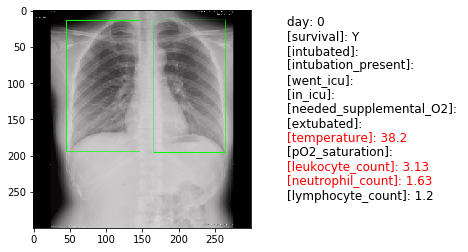

[Clincal Notes]: 31-year-old woman presented with fever (38.2�C [100.8�F]), dry cough, dizziness, and fatigue. Pulmonary auscultation was normal. Initial CT scan was normal. Leukopenia (white blood cell count,3.13�109/L, neutrophil count 1.63�109/L) with normal lymphocyte cell count, 1.2�109/L. White blood cell differential count: 52.1% neutrophils and 38.3% lymphocytes. C-reactive protein, erythrocyte sedimentation rate, aspartate aminotransferase, alanine aminotransferase, procalcitonin, inflammatory cytokines and coagulation profile were normal.





Patient 95	[Gender]: F	[Age]: 70
[Patient Location]: Valencia, Spain


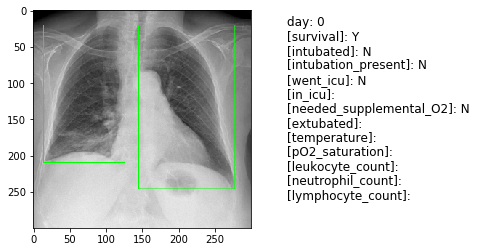

[Clincal Notes]: Fever and two days of odynophagia


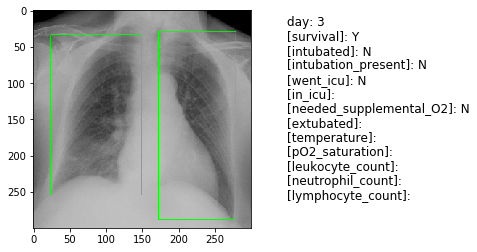

[Clincal Notes]: Fever and two days of odynophagia; positive test for SARS-CoV-2 RNA. Slight increasing of the opacity in the right lower lung field, without changes in the other fields.





Patient 96	[Gender]: M	[Age]: 60
[Patient Location]: Spain


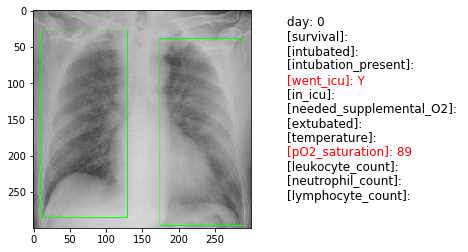

[Clincal Notes]: Fever and odynophagia. Trip to Italy 7 days ago. Low oxygen saturation (SpO2 89%) and lymphopenia were observed. The patient presented clinical worsening during his stay in the emergency department, and radiological control was performed at 12 hours. SARS-CoV-2 RNA was detected. Faint, ill-defined alveolar consolidations in both upper lobes.


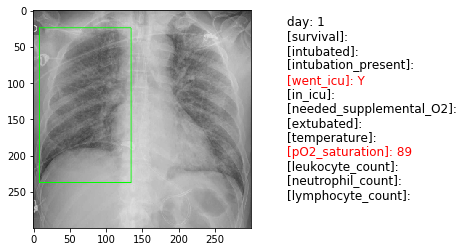

[Clincal Notes]: Fever and odynophagia. Trip to Italy 7 days ago. Low oxygen saturation (SpO2 89%) and lymphopenia were observed. The patient presented clinical worsening during his stay in the emergency department, and radiological control was performed at 12 hours. SARS-CoV-2 RNA was detected. Radiological worsening with patchy, bilateral alveolar consolidations with panlobar opacities, suggesting ARDS secondary to COVID19.


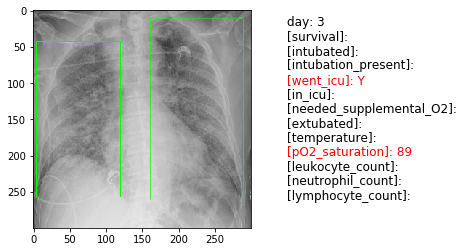

[Clincal Notes]: Fever and odynophagia. Trip to Italy 7 days ago. Low oxygen saturation (SpO2 89%) and lymphopenia were observed. The patient presented clinical worsening during his stay in the emergency department, and radiological control was performed at 12 hours. SARS-CoV-2 RNA was detected. Radiological stability, with slight improvement of the alveolar consolidation in right lower lobe. The patient still needs supportive care measures.





Patient 97	[Gender]: F	[Age]: 70
[Patient Location]: Spain


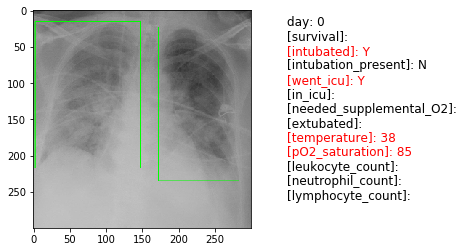

[Clincal Notes]: Admitted with acute respiratory failure, fever (38�C) and dyspnea. She was tachypneic (30 bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Ill-defined bilateral alveolar consolidation with peripheral distribution.


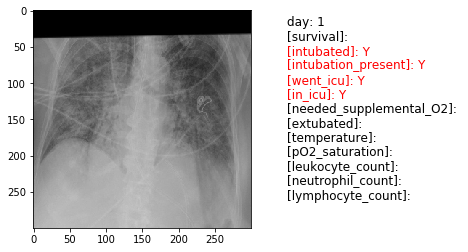

[Clincal Notes]: Admitted with acute respiratory failure, fever (38�C) and dyspnea. She was tachypneic (30 bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Radiological worsening, with changes within the lower lobes. Endotracheal tube and central venous line were required.


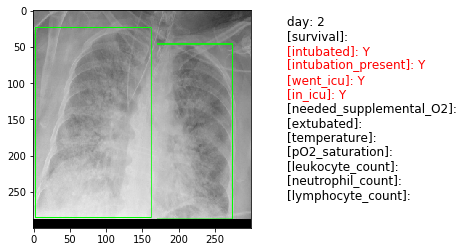

[Clincal Notes]: Admitted with acute respiratory failure, fever (38�C) and dyspnea. She was tachypneic (30 bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Radiological worsening. Bilateral alveolar consolidation with panlobar change.


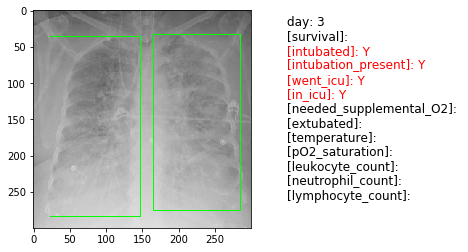

[Clincal Notes]: Admitted with acute respiratory failure, fever (38�C) and dyspnea. She was tachypneic (30 bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Bilateral alveolar consolidation with panlobar change, with typical radiological findings of ARDS. 





Patient 98	[Gender]: M	[Age]: 75
[Patient Location]: Spain


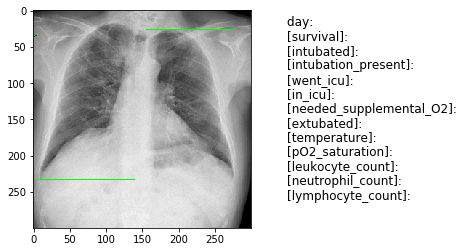

[Clincal Notes]: Presents to the primary care center for a week's worth of diarrhea, fever and malaise. No respiratory symptoms were reported. Blood test only shows high CRP. A chest x-ray is performed. Multiple faint alveolar opacities are identified, predominantly peripheral with greater involvement of the upper lobes. 





Patient 99	[Gender]: M	[Age]: 55
[Patient Location]: Spain


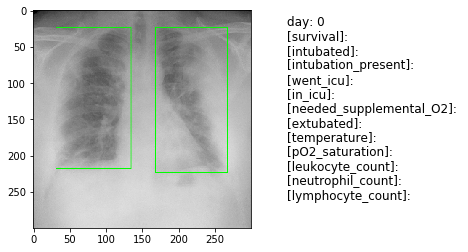

[Clincal Notes]: Attended the emergency department for progressive dyspnea in the last few days along with fever and cough. On the blood test, lymphopenia is detected. Bilateral and peripheral alveolar consolidations, more prominent in the left lung.





Patient 112	[Gender]: 	[Age]: 
[Patient Location]: 


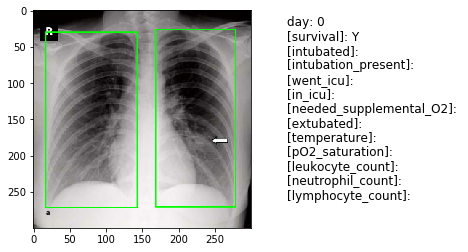

[Clincal Notes]: Serial chest radiographs of patient who presented with fever. Initial chest radiograph (a) revealed a left infrahilar focal consolidation (arrow). Follow-up chest radiograph


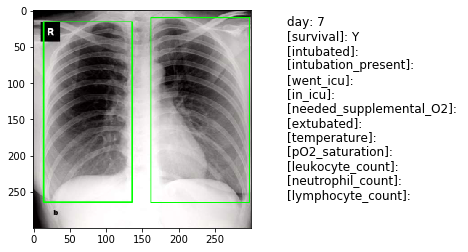

[Clincal Notes]: performed 7 days later showed interval resolution. The patient was stable during admission, without need for oxygen supplementation. 





Patient 113	[Gender]: 	[Age]: 
[Patient Location]: 


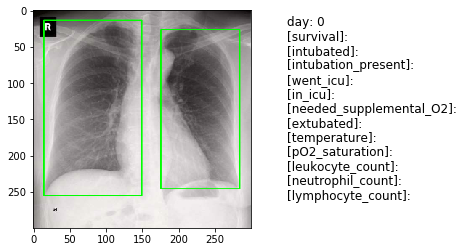

[Clincal Notes]: Serial chest radiographs of patient who presented with fever, cough and sore throat. Initial chest radiograph (a) was normal. 


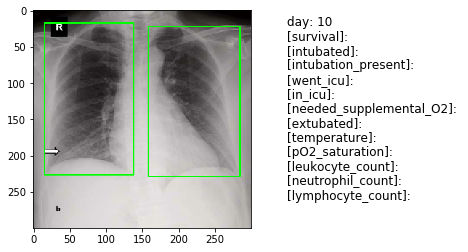

[Clincal Notes]:  performed 10 days later showed interval development of a right lower zone ground-glass opacity. The patient was stable during admission, without requiring oxygen supplementation. 





Patient 114	[Gender]: 	[Age]: 
[Patient Location]: 


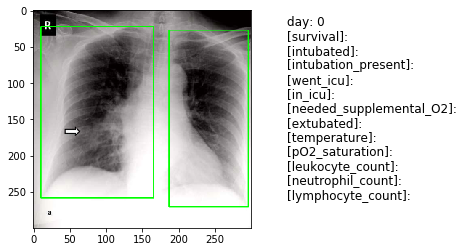

[Clincal Notes]: Serial chest radiographs of a patient who presented with fever and cough. Initial chest radiograph (a) showed a right infrahilar focal consolidation (arrow)


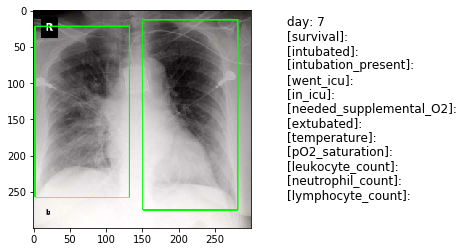

[Clincal Notes]: A follow-up radiograph (b) performed 7 days later demonstrated worsening right lung changes with predominant perihilar mixed GGO and consolidation.





Patient 115	[Gender]: 	[Age]: 
[Patient Location]: 


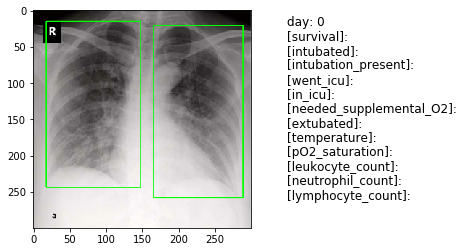

[Clincal Notes]: Serial chest radiographs of a patient who presented with fever and cough. Initial chest radiograph (a) showed bilateral predominant perihilar consolidation.


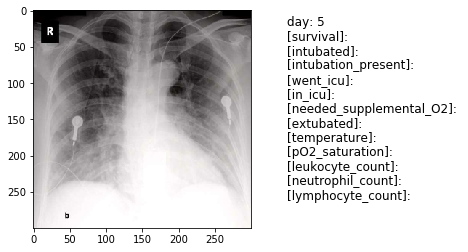

[Clincal Notes]: Follow-up chest radiograph (b) performed 5 days later showed interval worsening of bilateral perihilar and lower zone consolidation.





Patient 116	[Gender]: M	[Age]: 55
[Patient Location]: Edinburgh, United Kingdom


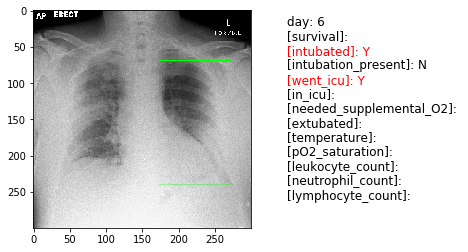

[Clincal Notes]: Six days self-isolating with fever. Progressive respiratory effort. Lymphopenic on presentation (1.2). Mutifocal consolidation in right mid zone and left mid/lower zones.  No pleural abnormality.


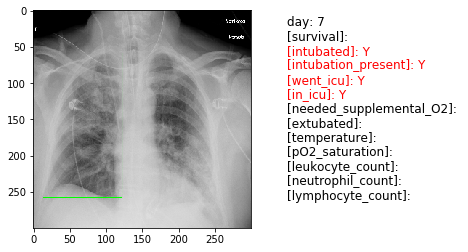

[Clincal Notes]: Intensive care study


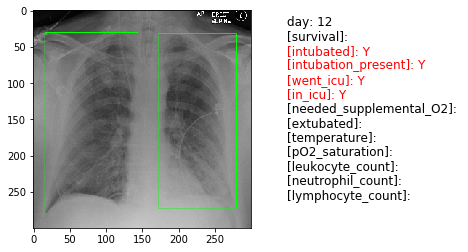

[Clincal Notes]: Persisting but improving regions of consolidation nearly a week after presentation. Remains intubated.





Patient 117	[Gender]: M	[Age]: 50
[Patient Location]: Spain


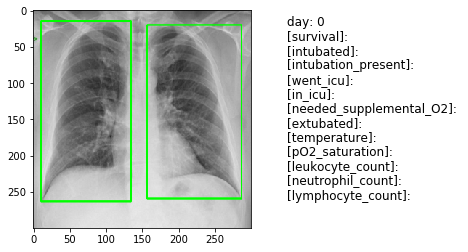

[Clincal Notes]: This middle aged man attended the emergency room for a dysthymic sensation 2-3 times a day, breathing difficulty and dry cough. In the complementary tests, only lymphopenia and elevated CRP stand out. Therefore, no coronavirus test was performed because he did not meet epidemiological criteria and the patient was discharged. No significant findings. Lungs clear.  


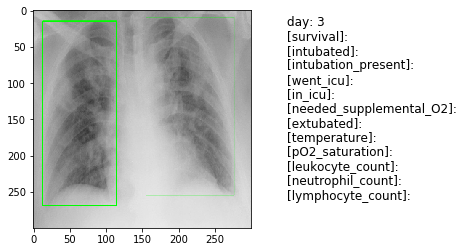

[Clincal Notes]: Patchy, ill-defined bilateral alveolar consolidations, with a peripheral distribution.  


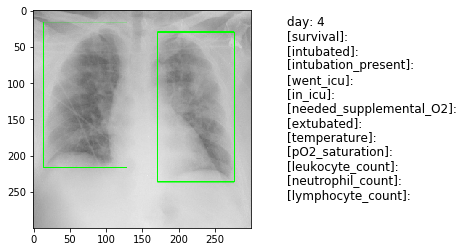

[Clincal Notes]: Radiological worsening, with consolidation in the left upper lobe.  


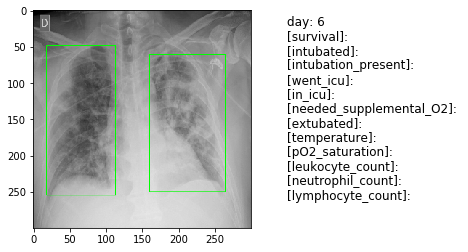

[Clincal Notes]: Radiological worsening, with typical findings of acute respiratory distress syndrome (ARDS).  





Patient 118	[Gender]: F	[Age]: 71
[Patient Location]: Italy


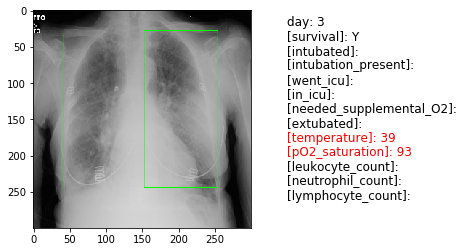

[Clincal Notes]: Female patient, 71 years old, transferred to the DEA from the local PS with the diagnosis of dyspnea, reported 3 days (39 �) fever; Pcs resident in common with multiple COVID-19 cases. In a history of COPD with moderate respiratory failure. Pz disponoica, tachipnoica, tachycardia with pO2 93% in ambient air. Chest x-ray is required and considering the epidemiological link, a buffer (positive for SARS-CoV-2) and isolation of the patient is carried out. The X-ray investigation demonstrates a widespread increase in the peribroncovascular interstitial texture with associated bilateral bilateral parenchymal thickenings arranged in the peripheral location. Pleural effusion on the right with obliteration of the costophrenic sinus on this side. The Pz is assisted and treated in an MU (department dedicated to COVID-19 patients) and after about 1 week it shows significant improvements as evident from the first control CT performed about 8 days after hospitalization.





Patient

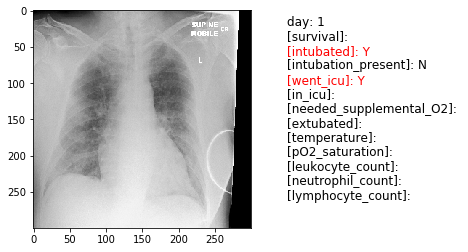

[Clincal Notes]: Recent travel from endemic COVID-19 region. 24 hours confusion with new temperature and desaturation on assessment. Supine study. Patchy consolidation in peripheral right midzone.  No pleural abnormality.


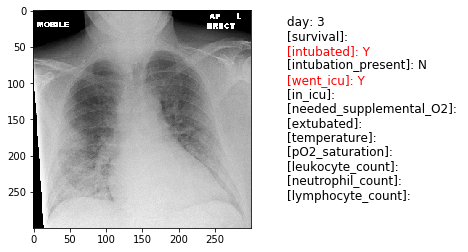

[Clincal Notes]: Progressive right mid and lower zone consolidation. Left lung and pleural spaces remains clear.


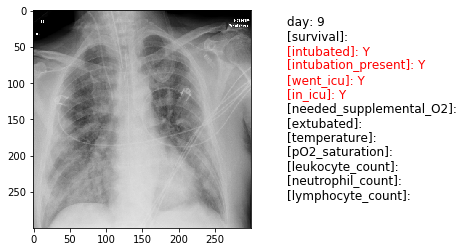

[Clincal Notes]: Diffuse patchy airspace consolidation in the mid/lower zones bilaterally.  ET tube, right jugular central line and NG tube in situ.  No pleural abnormality.





Patient 137	[Gender]: M	[Age]: 83
[Patient Location]: Italy


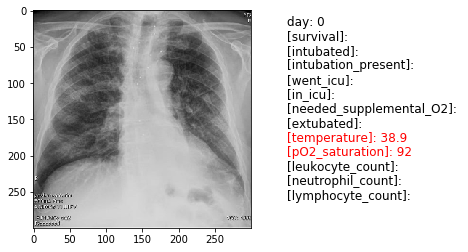

[Clincal Notes]: The X-ray examination shows nuanced parenchymal thickenings in the middle and lower field in the right hemithorax and in the middle field on the left.





Patient 138	[Gender]: M	[Age]: 77
[Patient Location]: Italy


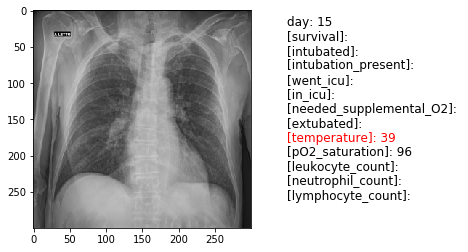

[Clincal Notes]: 77 year old male patient brought to PS after clinical worsening (difficulty feeding and hydrating) for 15 days diarrhea, vomiting and epigastralgia. The patient shares a home with a positive Covid19 subject. Concomitant pathologies: arterial hypertension, rheumatic polymyalgia, Horton's arteritis, ex-smoker.  Upon entering the PS the alert, eupnoic, apyretic patient reported nausea. Treatable abdomen and auscultation of the thorax. Chest ultrasound performed by PS colleague reported negative for interstitial disease on Saturday afternoon. On blood tests discrete electrolyte imbalance, modest increase in LDH and PCR, lymphopenia.





Patient 139	[Gender]: M	[Age]: 45
[Patient Location]: Italy


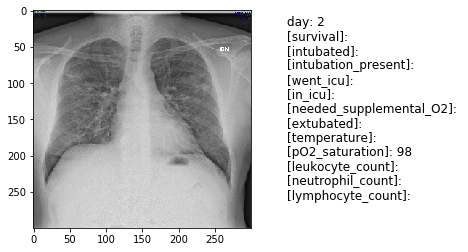

[Clincal Notes]: multiple peribroncovasal parenchymal thickenings in the right pulmonary perilary seat, in the upper and lower right pulmonary field, in the upper left perilary pulmonary seat, with a phlogistic aspect.


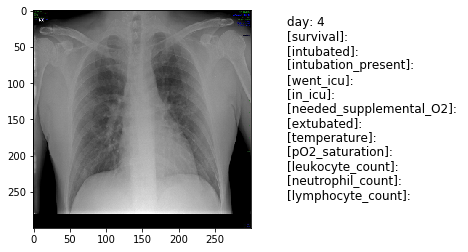

[Clincal Notes]: clear regression of the areas of hypodiaphania previously appreciable bilaterally, in particular in both the upper lung fields and the right lung base.





Patient 140	[Gender]: F	[Age]: 60
[Patient Location]: Tabriz, Iran


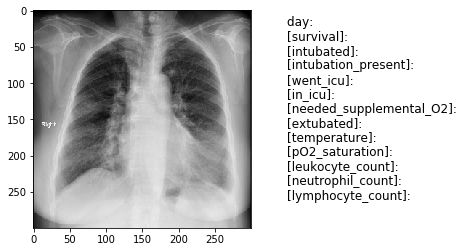

[Clincal Notes]: Patchy ill defined subpleural opacities are seen particularly at mid zone of right lung.  





Patient 141	[Gender]: M	[Age]: 65
[Patient Location]: Tabriz, Iran


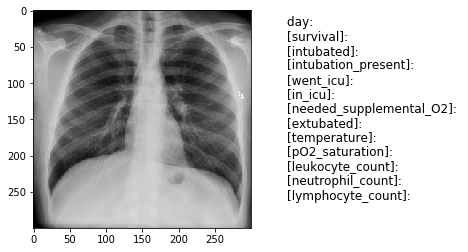

[Clincal Notes]: Patchy ground glass opacities are present at both lungs predominantly at subpleural regions.  





Patient 142	[Gender]: M	[Age]: 65
[Patient Location]: Peshawar, Pakistan


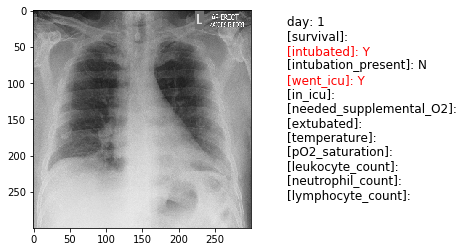

[Clincal Notes]: Increasing lethargy and flu like symptoms. New oxygen requirement. Crackles on both bases. No collapse or consolidation. No pleural effusion.   


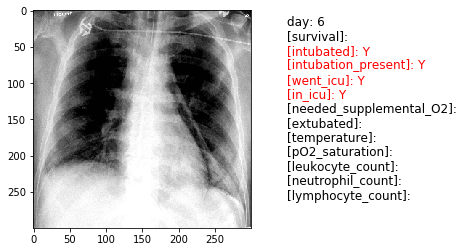

[Clincal Notes]: ETT and NG tube placed. New air-space shadowing with air bronchogram in left lower zone . New pneumomediastinum demonstrated.


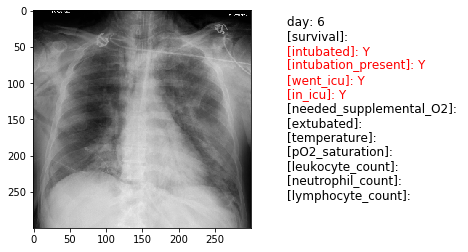

[Clincal Notes]: ETT and NG tube in place. Right-sided intercostal drain with bilateral small pneumothorax and pneumomediastinum with diffuse air space in both lungs typical for COVID.


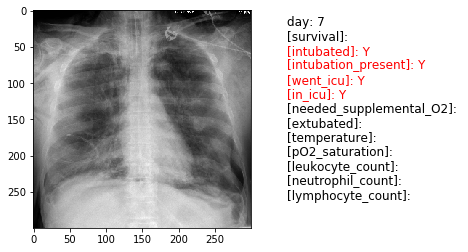

[Clincal Notes]: ETT, NG tube and right sided intercostal drain in place. Interval increase in size of left pneumothorax with persistent right pneumothorax and pneumomediastinum with diffuse air space in both lungs. No pleural effusion.





Patient 143	[Gender]: M	[Age]: 65
[Patient Location]: Birmingham, United Kingdom


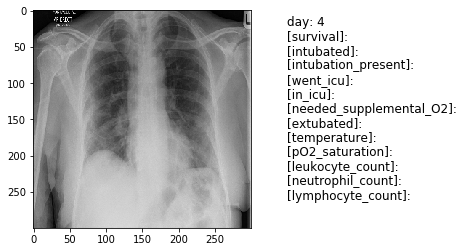

[Clincal Notes]: Four-day history of high-grade fever, cough and myalgia. On admission, the patient was tachycardic but maintained oxygen saturation on low flow. On auscultation, he had bilateral crackles and crepitations. Coarse patchy opacification of both lower zones which appear inflammatory in nature. No focal collapse or consolidation. The pleural surfaces are clear with normal cardio-mediastinal contour.


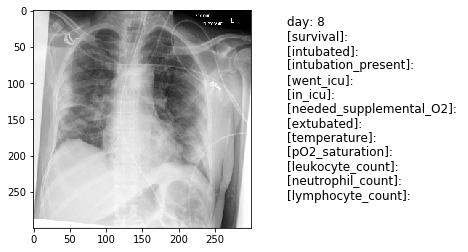

[Clincal Notes]: Four days following admission, the patient developed increasing hypoxia and sepsis with hypotension, requiring intensive care admission for ventilation and inotropic support.  AP supine portable CXR:  The previously seen patchy opacities appear as areas of bilateral peripheral consolidations with air bronchograms. Consolidation above the horizontal fissure suggests right upper lobe pneumonia. Obliteration of the left heart border suggests lower lobe pneumonia.  Support lines (ETT, NG, and left internal jugular CVC) are in situ.





Patient 144	[Gender]: F	[Age]: 30
[Patient Location]: Nottingham, United Kingdom 


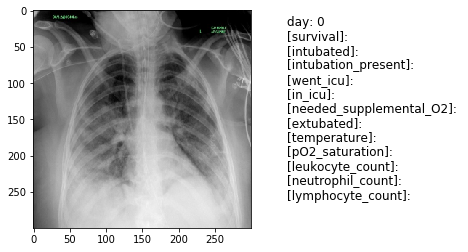

[Clincal Notes]: PC: Dyspnea and fever. BG: Asthma, Cerebral palsy. Clinically high risk on admission. Patchy areas of air space opacification bilaterally with a lower zone predominance.  Appropriately positioned right central venous catheter, endotracheal and nasogastric tubes.


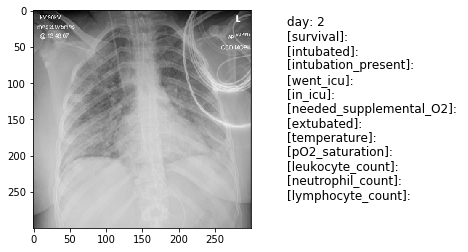

[Clincal Notes]: Radiological progression with widespread bilateral opacification across all zones. No pleural effusions. 





Patient 145	[Gender]: F	[Age]: 35
[Patient Location]: Belgium


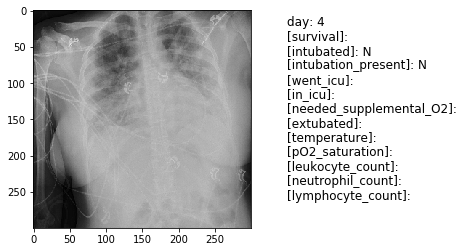

[Clincal Notes]: Diffuse bilateral lung opacities.  No intubation.





Patient 146	[Gender]: M	[Age]: 85
[Patient Location]: Nottingham, United Kingdom 


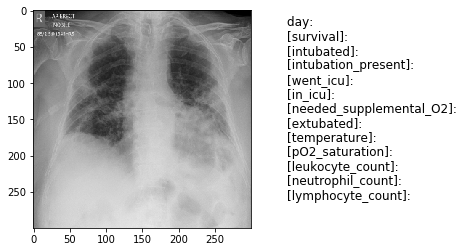

[Clincal Notes]: Worsening dyspnea. Past history of COPD. T2DM. Previous pancreatectomy. ETOH excess. Lymphopenia on admission. Chest radiograph on admission demonstrates bilateral, almost symmetrical areas of peripheral consolidation with perihilar infiltrates and an indistinct left heart border. In an endemic area, appearances are highly suggestive of COVID-19. 





Patient 147	[Gender]: F	[Age]: 50
[Patient Location]: Orange, California, USA


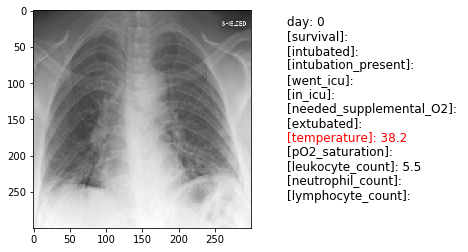

[Clincal Notes]: 50 year-old woman with history of type 2 diabetes and essential hypertension presents to the emergency room with 7 days of worsening shortness of breath, fatigue, and bouts of diarrhea. The patient recently traveled to Uganda. COVID-19, consolidation, atoll, reverse halo, viral pneumonia, ground glass. Chest radiograph is generally nonspecific manifesting with peripheral and basal predominant consolidation. The most common imaging appearance on chest CT scans include peripheral and basal predominant ground-glass opacities and less commonly consolidation that often has a rounded appearance. Some of the opacities may manifest an atoll or reverse halo sign with central ground-glass opacities and peripheral consolidation. A perilobular distribution may also be present, likely representing an organizing pneumonia pattern of lung injury. AP chest radiograph at presentation shows peripheral and basal predominant consolidation.





Patient 148	[Gender]: M	[Age]: 41
[Patient L

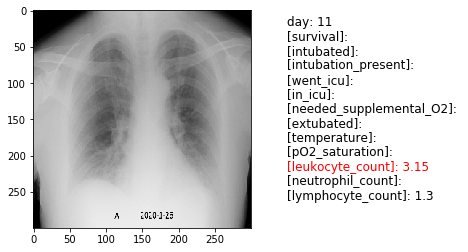

[Clincal Notes]:  Chest radiograph and CT images of a 41-year-old man with COVID-2019 infection performed at the same time. (A) Chest radiograph shows basal atelectasis without confluent consolidation. (B, C) Axial thin-section unenhanced CT scan shows patchy ground-glass opacities (circle) in the medial right lower lobe. Ground-glass nodules (arrows) are also in the right upper lobe and left lower lobe. The patient presented with an 11-day history of cough after recent travel to Wuhan, China. The patient had no history of diabetes, hypertension, cardiovascular disorders or other diseases. Bronchiectasis, Consolidation, linear opacities, Ground-glass opacities, linear opacities





Patient 149	[Gender]: M	[Age]: 40
[Patient Location]: Zigong, China


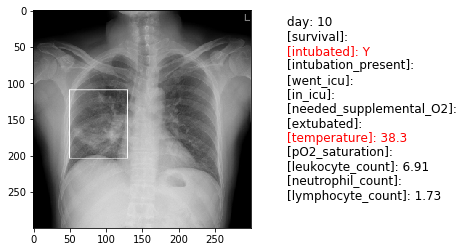

[Clincal Notes]: 40-year-old man presented with a 10-day history of cough and a 1-day history of fever (38.3?). After 6 days of treatment combined with antiviral drugs and anti-inflammatory drugs, the pulmonary lesions had nearly resolved, however new ground-glass opacities appeared in the periphery of the right lower lobe. Fortunately, following continuous treatment, the man improved and was discharged. PA and lateral chest radiographs show patchy consolidation in the right mid lung zone.





Patient 150	[Gender]: M	[Age]: 28
[Patient Location]: 


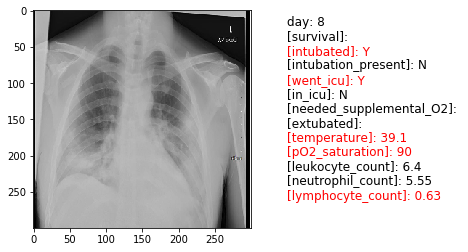

[Clincal Notes]: 28M previously fit and well, not on any regular medications, presented with a 6 day Hx of fever, non-productive cough and SOB for the last 4 days. His symptoms started as sore throat and coryzal symptoms 8 days prior to his presentation and he reported contact with a friend with similar symptomatology.  O/E T39.1 HR87 BP119/63 RR38 SpO2 90% on RA. Bilateral nasal crepitations without a wheeze.  Image 1 - CXR on admission Image 2 - haematology, biochemistry on admission and serial gases Image 3 - CXR post intubation in the critical care setting Image 4 - the reason for this unfortunate young man requiring critical care.


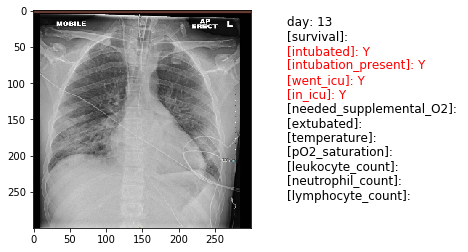

[Clincal Notes]: 28M previously fit and well, not on any regular medications, presented with a 6 day Hx of fever, non-productive cough and SOB for the last 4 days. His symptoms started as sore throat and coryzal symptoms 8 days prior to his presentation and he reported contact with a friend with similar symptomatology.  O/E T39.1 HR87 BP119/63 RR38 SpO2 90% on RA. Bilateral nasal crepitations without a wheeze.  Image 1 - CXR on admission Image 2 - haematology, biochemistry on admission and serial gases Image 3 - CXR post intubation in the critical care setting Image 4 - the reason for this unfortunate young man requiring critical care.





Patient 151	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


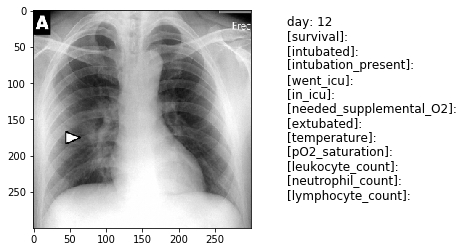

[Clincal Notes]: 





Patient 152	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


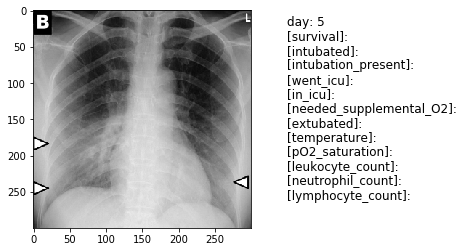

[Clincal Notes]: 





Patient 153	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


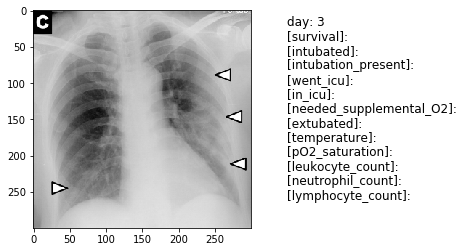

[Clincal Notes]: 





Patient 154	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


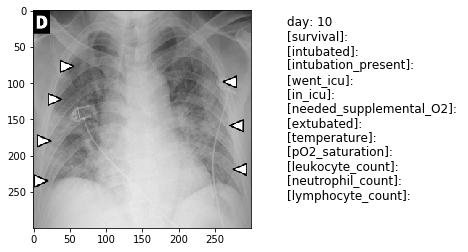

[Clincal Notes]: 





Patient 155	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


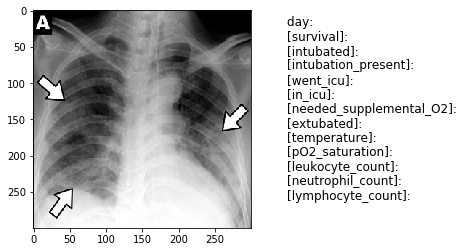

[Clincal Notes]: patchy consolidations,





Patient 156	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


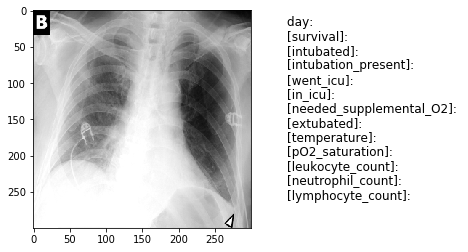

[Clincal Notes]: pleural effusion





Patient 157	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


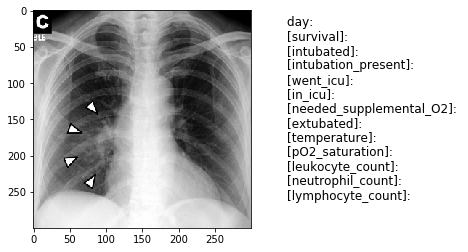

[Clincal Notes]: perihilar distribution





Patient 158	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


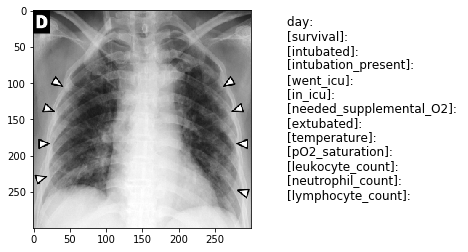

[Clincal Notes]: peripheral distribution.





Patient 159	[Gender]: 	[Age]: 
[Patient Location]: Hong Kong


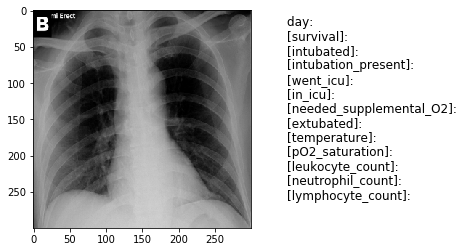

[Clincal Notes]: Ground glass opacities





Patient 160	[Gender]: M	[Age]: 44
[Patient Location]: Wuhan, China


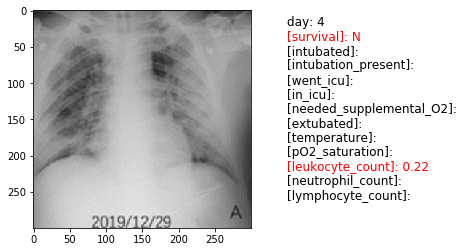

[Clincal Notes]: progressively increased extension and density of the lung opacities


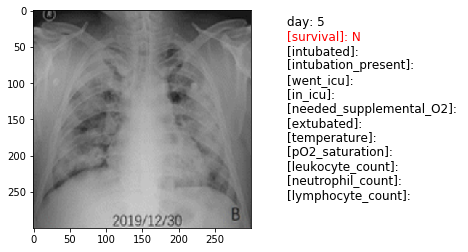

[Clincal Notes]: progressively increased extension and density of the lung opacities


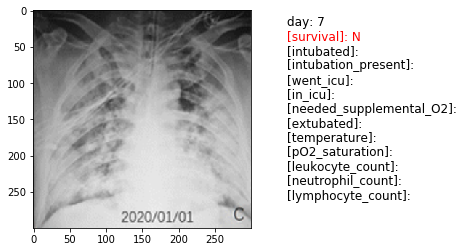

[Clincal Notes]: progressively increased extension and density of the lung opacities, culminating in confluent basilar predominant bilateral lung consolidation





Patient 161	[Gender]: M	[Age]: 71
[Patient Location]: Shanghai, China


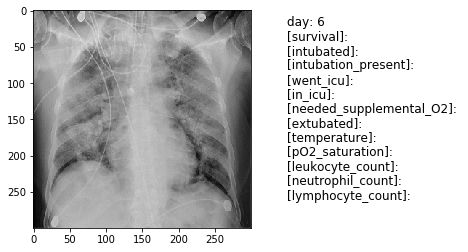

[Clincal Notes]: diffusely increased opacities in both lungs, with relative bibasilar sparing





Patient 162	[Gender]: M	[Age]: 45
[Patient Location]: Zahedan, Iran


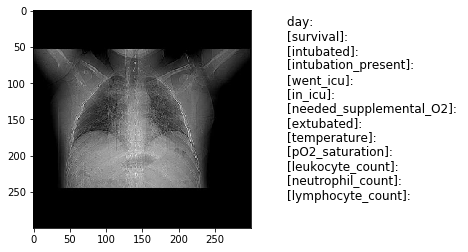

[Clincal Notes]: Dry cough, chest pain and dyspnea





Patient 163	[Gender]: M	[Age]: 70
[Patient Location]: Spain


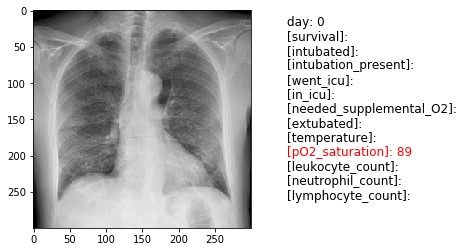

[Clincal Notes]: No significant findings reported. In retrospect, a subtle ground-glass pattern can be seen in both lungs, with peripheral distribution.


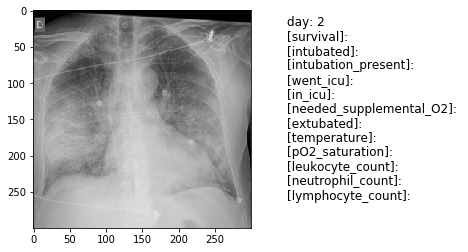

[Clincal Notes]: Bilateral ground-glass alveolar consolidation with peripheral distribution.





Patient 164	[Gender]: M	[Age]: 75
[Patient Location]: Barcelona, Spain 


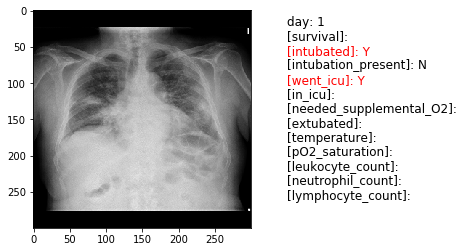

[Clincal Notes]: Bilateral ground-glass opacities more prominent in the right upper lobe and right paramediastinal region.


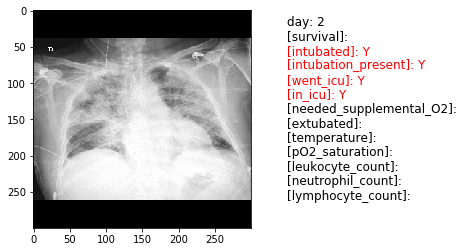

[Clincal Notes]: Progressive bilateral ground-glass opacities affecting both lungs, more prominent in the upper lobes and paramediastinal parenchyma. The patient is intubated and has a central venous line. 





Patient 165	[Gender]: F	[Age]: 
[Patient Location]: Rome, Italy


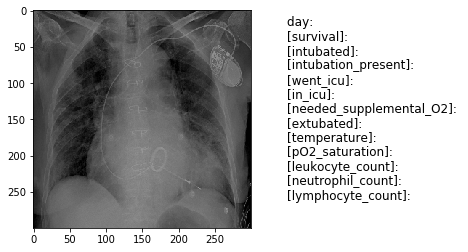

[Clincal Notes]: Patient admitted for heart failure. Developed fever and dyspnea during hospitalization. AP chest x-ray documents the presence of consolidation at both lung bases as well as in the peripheral mid zones. The heart is enlarged. Single-lead pacemaker and valvuloplasty noted. 





Patient 166	[Gender]: M	[Age]: 50
[Patient Location]: Riccione, Italy 


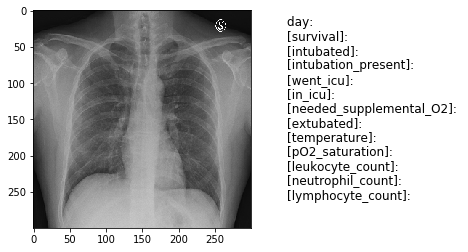

[Clincal Notes]: Examination within the limits of the norm.





Patient 167	[Gender]: M	[Age]: 75
[Patient Location]: Riccione, Italy 


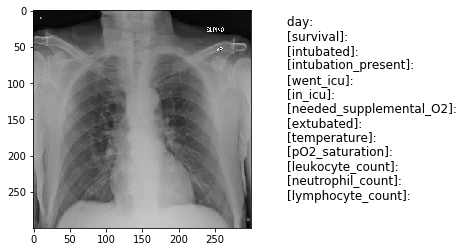

[Clincal Notes]: Fever for ten days with dry cough, shortness of breath and abdominal pain with diarrhea. Normal examination. 


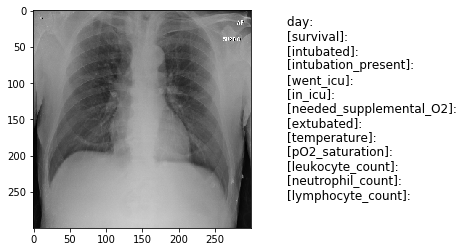

[Clincal Notes]: Fever for ten days with dry cough, shortness of breath and abdominal pain with diarrhea. Normal examination. 





Patient 168	[Gender]: F	[Age]: 35
[Patient Location]: Nottingham, United Kingdom 


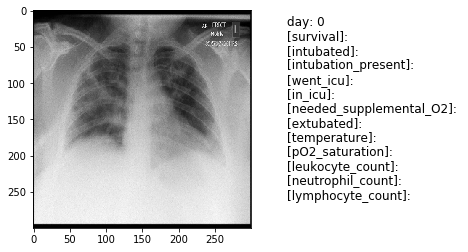

[Clincal Notes]: Four-day history of dry cough, myalgia, pyrexia and sore throat. Admitted to hospital for worsening dyspnea. No past medical history. First chest radiograph on admission demonstrates multiple patchy areas of peripheral air space opacification considered typical for COVID 19 with the appropriate history. No pleural effusions. 


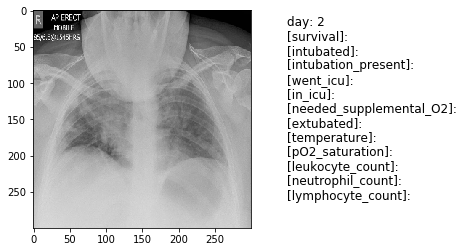

[Clincal Notes]: Four-day history of dry cough, myalgia, pyrexia and sore throat. Admitted to hospital for worsening dyspnea. No past medical history. Limited inspiratory effort, with radiological progression showing peri-hilar and peripheral areas of consolidation and new areas of interstitial thickening.





Patient 169	[Gender]: M	[Age]: 60
[Patient Location]: Nottingham, United Kingdom 


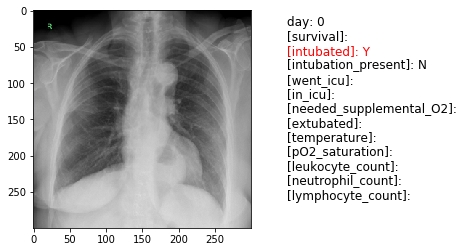

[Clincal Notes]: Patient presented with pyrexia and dyspnea. Past medical history of hypertension, GERD, and asthma. Lymphopenia on admission. Subtle bilateral peripheral air space opacification predominantly in the right upper and both mid zones. No pleural effusions.  Hiatus hernia.


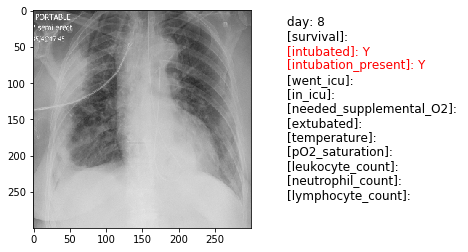

[Clincal Notes]: Patient presented with pyrexia and dyspnea. Past medical history of hypertension, GERD, and asthma. Lymphopenia on admission. Radiological progression with dense peripheral right upper lobe consolidation. Peripheral areas of air space opacification in the left hemithorax are also now more conspicuous.   The nasogastric tube is inappropriately positioned in the esophagus requiring resiting. 





Patient 173	[Gender]: F	[Age]: 70
[Patient Location]: Australia


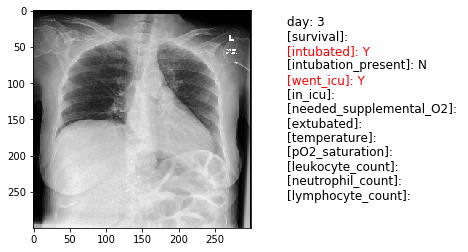

[Clincal Notes]: Three days cough, myalgias and fever. No recent overseas travel. Only sick contact was her husband who was recently hospitalized with presumed community-acquired pneumonia but not tested for COVID-19. Past history of vascath in-situ for dialysis on a background of chronic end-stage renal failure with dysfunctional A-V fistula. There is mild left peri-hilar and upper lobe interstitial opacity consistent with developing consolidation.


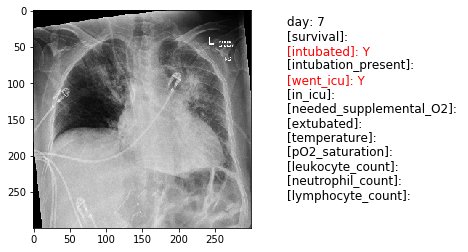

[Clincal Notes]: Three days cough, myalgias and fever. No recent overseas travel. Only sick contact was her husband who was recently hospitalized with presumed community-acquired pneumonia but not tested for COVID-19. Past history of vascath in-situ for dialysis on a background of chronic end-stage renal failure with dysfunctional A-V fistula. Serial chest x-ray was taken four days after the first x-ray, and seven days since the onset of symptoms. By this stage, the patient has had a positive nasopharyngeal swab for COVID-19 virus.  There is established left upper lobe and now progressive patchy consolidation in left lower, right upper and middle lobes.


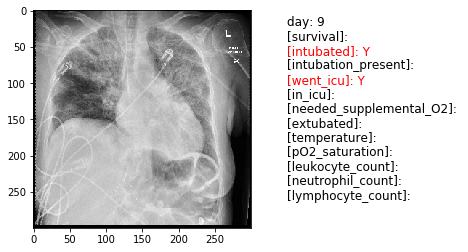

[Clincal Notes]: Three days cough, myalgias and fever. No recent overseas travel. Only sick contact was her husband who was recently hospitalized with presumed community-acquired pneumonia but not tested for COVID-19. Past history of vascath in-situ for dialysis on a background of chronic end-stage renal failure with dysfunctional A-V fistula. There is progression of right side opacity and, clinically, the patient is desaturating with increased work of breathing higher supplemental oxygen requirements. 


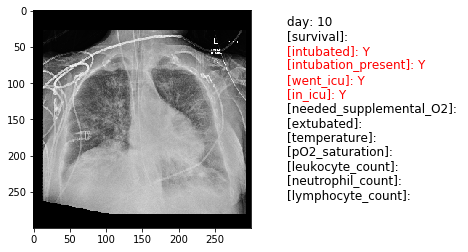

[Clincal Notes]: Three days cough, myalgias and fever. No recent overseas travel. Only sick contact was her husband who was recently hospitalized with presumed community-acquired pneumonia but not tested for COVID-19. Past history of vascath in-situ for dialysis on a background of chronic end-stage renal failure with dysfunctional A-V fistula. Little more than 24 hours from the previous x-ray the patient has increased work of breathing, fatigue and low oxygen saturations on 10-15 L/min of supplemental oxygen. Progressive acute respiratory failure. Patient intubated and mechanically ventilated. The endotracheal tube is just above the carina and there is a nasogastric tube within the stomach. There is a right jugular central line with the tip in the superior vena cava. There is now widespread interstitial and alveolar opacity diffusely spread through both lung fields.





Patient 174	[Gender]: F	[Age]: 30
[Patient Location]: Tabriz, Iran


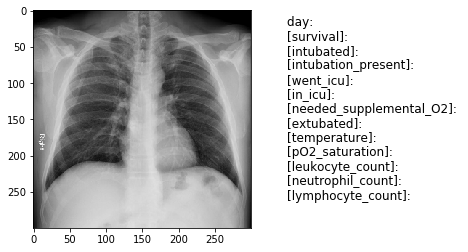

[Clincal Notes]: Fever and cough. Normal appearances.





Patient 175	[Gender]: M	[Age]: 85
[Patient Location]: Nottingham, United Kingdom 


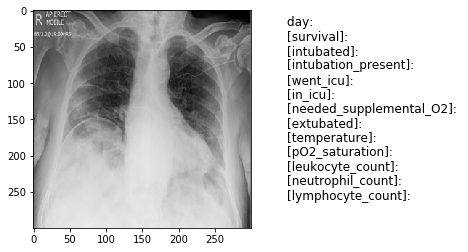

[Clincal Notes]: Patient presented with a cough and pyrexia. Recent history of travel to the Caribbean. PMH: AF and prostate cancer. Bilateral peripheral areas of air space opacification in the mid to lower zones. Appearances represent classical features of mild COVID-19 pneumonia. Incidental note is made of Chilaiditi sign. Elderly patient with a recent travel history deemed high risk for COVID-19 pneumonia following clinical presentation. Findings confirmed with viral swabs for SARS-CoV2 RNA with positive RT-PCR. Appearances are considered 'typical' for COVID-19 with no further indication for CT diagnosis when confirmed with viral PCR. Patient was appropriately isolated and subsequently discharged following an uncomplicated recovery. 





Patient 176	[Gender]: 	[Age]: 
[Patient Location]: Canterbury, United Kingdom 


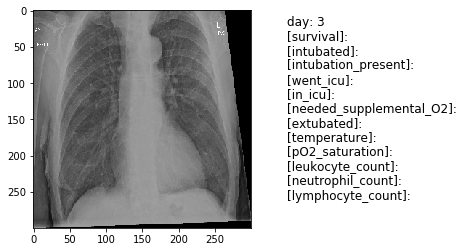

[Clincal Notes]: Multifocal bilateral lung changes which may represent COVID-19 in the correct clinical context. Correlation with inflammatory markers and PCR testing advised. The patient tested positive for COVID-19. Subtle bilateral mid and lower lung zones peripheral ground-glass opacities. No pleural effusion. OVID TEMP SPIKES WITH OCCASIONAL LABORED BREATHING





Patient 177	[Gender]: M	[Age]: 
[Patient Location]: Vivantes Klinikum Neuk�lln, Berlin, Germany


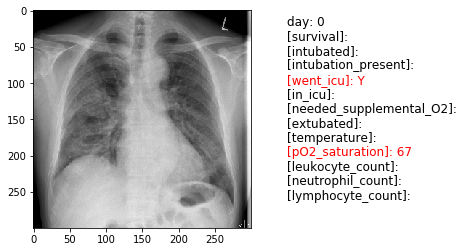

[Clincal Notes]: A 61-year-old male non-smoking patient presented with dyspnoea (respiratory rate 25/min, peripheral capillary oxygen saturation 67%) and fever (38.3�C). Apart from pre-existing arterial hypertension, there were no risk factors or known pathogen exposure. Blood analysis showed normal leucocytes, elevated C-reactive protein (CRP) levels (106.3mg/l; normal range <5mg/l) and a normal procalcitonin level (0.12�g/l; normal range <0.50�g/l). Glomerular filtration rate was reduced (47ml/min). Reverse transcription polymerase change reaction (RT-PCR) for coronavirus disease-2019 (COVID-19) was positive, Influenza tests were negative. As dyspnoea deteriorated, the patient was admitted to our intensive care unit. Under continuous invasive ventilation and broad-spectrum antibiotics CRP levels rose to 300mg/l and fever continued over the next 4 days. With the impending need of extracorporeal membrane oxygenation, a chest CT scan was performed. Chest X-ray at initial presentation sh

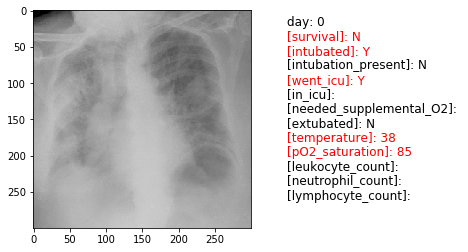

[Clincal Notes]: A 72-year-old woman admitted with acute respiratory failure, fever (38�C) and dyspnoea. She was tachypneic (30bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Patient presented to the emergency department two days earlier with fever (up to 38.6�C), dry cough, odynophagia and general malaise. She was discharged from hospital because she did not present alarm criteria at that time. The patient required mechanical ventilation and was admitted to intensive care. During her stay in ICU, poor evolution to respiratory distress syndrome and to multi-organic failure. The patient passed away 24 hours laterigure 1 (at admission). Ill-defined bilateral alveolar consolidation with peripheral distribution. 


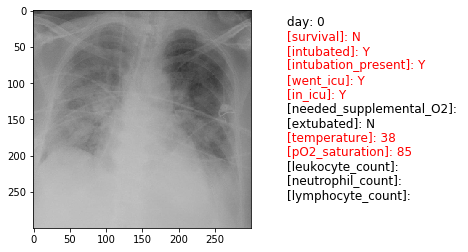

[Clincal Notes]: A 72-year-old woman admitted with acute respiratory failure, fever (38�C) and dyspnoea. She was tachypneic (30bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Patient presented to the emergency department two days earlier with fever (up to 38.6�C), dry cough, odynophagia and general malaise. She was discharged from hospital because she did not present alarm criteria at that time. The patient required mechanical ventilation and was admitted to intensive care. During her stay in ICU, poor evolution to respiratory distress syndrome and to multi-organic failure. The patient passed away 24 hours later. Figure 2 (4 hours later). Radiological worsening, with affectation of lower lobes. Endotracheal tube and central venous line were required.


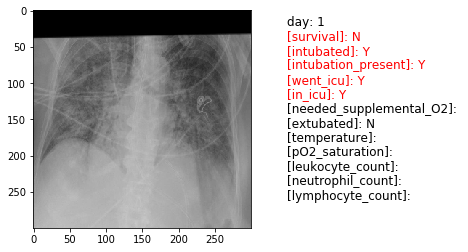

[Clincal Notes]: A 72-year-old woman admitted with acute respiratory failure, fever (38�C) and dyspnoea. She was tachypneic (30bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Patient presented to the emergency department two days earlier with fever (up to 38.6�C), dry cough, odynophagia and general malaise. She was discharged from hospital because she did not present alarm criteria at that time. The patient required mechanical ventilation and was admitted to intensive care. During her stay in ICU, poor evolution to respiratory distress syndrome and to multi-organic failure. The patient passed away 24 hours later. Figure 2 (4 hours later). Radiological worsening, with affectation of lower lobes. Endotracheal tube and central venous line were required. Figure 3 (Day 1). Bilateral alveolar consolidation.


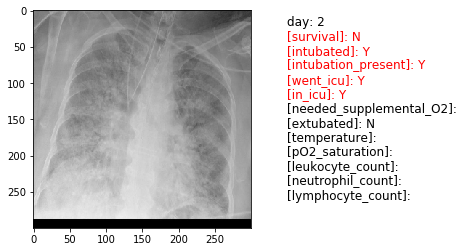

[Clincal Notes]: A 72-year-old woman admitted with acute respiratory failure, fever (38�C) and dyspnoea. She was tachypneic (30bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Patient presented to the emergency department two days earlier with fever (up to 38.6�C), dry cough, odynophagia and general malaise. She was discharged from hospital because she did not present alarm criteria at that time. The patient required mechanical ventilation and was admitted to intensive care. During her stay in ICU, poor evolution to respiratory distress syndrome and to multi-organic failure. The patient passed away 24 hours later. Figure 4 (Day 2). Radiological worsening. Bilateral alveolar consolidation with panlobar affectation.


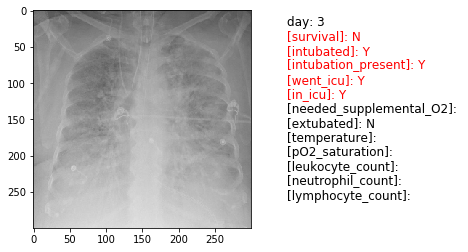

[Clincal Notes]: A 72-year-old woman admitted with acute respiratory failure, fever (38�C) and dyspnoea. She was tachypneic (30bpm), with lymphopenia and low oxygen saturation (SpO2 85%, PAFI<250). Patient presented to the emergency department two days earlier with fever (up to 38.6�C), dry cough, odynophagia and general malaise. She was discharged from hospital because she did not present alarm criteria at that time. The patient required mechanical ventilation and was admitted to intensive care. During her stay in ICU, poor evolution to respiratory distress syndrome and to multi-organic failure. The patient passed away 24 hours later. Figure 5 (Day 3). Bilateral alveolar consolidation with panlobar affectation, with typical radiological findings of ARDS. 24 hours later the patient passed away.





Patient 179	[Gender]: M	[Age]: 56
[Patient Location]: University of California Irvine, Orange, California, USA


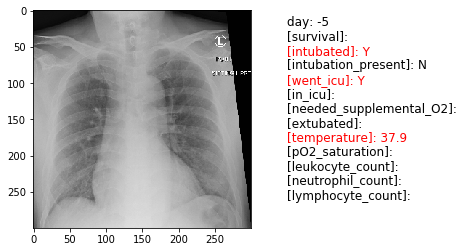

[Clincal Notes]: A 56-year-old male patient with end-stage renal disease, heart failure, and tobacco cigarette smoking (5 pack year history) presented to the emergency department with nausea, vomiting, and low-grade fever (37.9�C), and was diagnosed with gastroenteritis. He subsequently developed a dry cough and myalgia, and returned 5 days later with fever (38.1�C). Laboratory studies were remarkable for mild lymphopenia (0.8�103/�L, normal range 0.9�103/�L � 3.3�103/�L), elevated aspartate aminotransferase (71 IU/L, normal range 13 IU/L � 39 IU/L), elevated c-reactive protein (14.6 mg/dL, normal range 0 � 1 mg/dL), and elevated procalcitonin (2.37 ng/mL, normal < 0.1 ng/mL). He had traveled to South Korea approximately 7 weeks prior to presentation. AP chest X-ray at initial presentation demonstrated mild patchy increased interstitial markings at the bilateral lung bases without evidence of focal consolidation and stable mild cardiomegaly (Fig. 1).


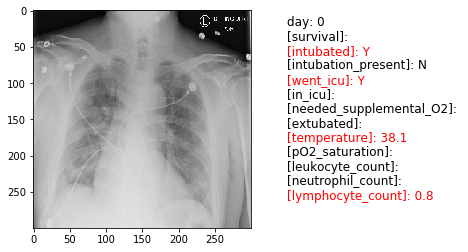

[Clincal Notes]: A 56-year-old male patient with end-stage renal disease, heart failure, and tobacco cigarette smoking (5 pack year history) presented to the emergency department with nausea, vomiting, and low-grade fever (37.9�C), and was diagnosed with gastroenteritis. He subsequently developed a dry cough and myalgia, and returned 5 days later with fever (38.1�C). Laboratory studies were remarkable for mild lymphopenia (0.8�103/�L, normal range 0.9�103/�L � 3.3�103/�L), elevated aspartate aminotransferase (71 IU/L, normal range 13 IU/L � 39 IU/L), elevated c-reactive protein (14.6 mg/dL, normal range 0 � 1 mg/dL), and elevated procalcitonin (2.37 ng/mL, normal < 0.1 ng/mL). He had traveled to South Korea approximately 7 weeks prior to presentation. AP Chest X-ray obtained at second presentation demonstrated diffuse patchy bilateral airspace opacities (Fig. 2). 


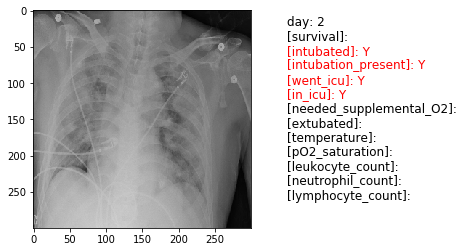

[Clincal Notes]: A 56-year-old male patient with end-stage renal disease, heart failure, and tobacco cigarette smoking (5 pack year history) presented to the emergency department with nausea, vomiting, and low-grade fever (37.9�C), and was diagnosed with gastroenteritis. He subsequently developed a dry cough and myalgia, and returned 5 days later with fever (38.1�C). Laboratory studies were remarkable for mild lymphopenia (0.8�103/�L, normal range 0.9�103/�L � 3.3�103/�L), elevated aspartate aminotransferase (71 IU/L, normal range 13 IU/L � 39 IU/L), elevated c-reactive protein (14.6 mg/dL, normal range 0 � 1 mg/dL), and elevated procalcitonin (2.37 ng/mL, normal < 0.1 ng/mL). He had traveled to South Korea approximately 7 weeks prior to presentation. AP chest X-ray on day two of admission (Fig. 4) demonstrated interval intubation, increased patchy airspace opacities, and stable mild cardiomegaly.





Patient 180	[Gender]: M	[Age]: 61
[Patient Location]: Civili Hospital, Vigevano, Ita

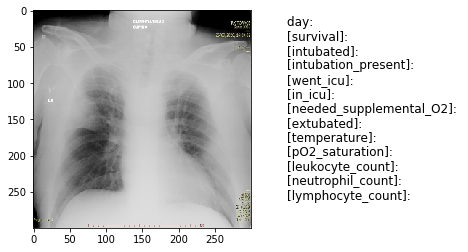

[Clincal Notes]: A 61-year-old male patient presented with three days fever and mild sore throat. Past history of diabetes mellitus and arterial hypertension. Blood analysis showed mild elevation of C-reactive protein level (11,26 mg/l ), normal LDH level, normal WBC count with neutrophylia (80,4%) and hyperglycaemia (151 mg/dl). Chest X-ray (antero-posterior view): consolidations in right upper lobe sharply defined at the fissure, and in lower zone of the left-lung. 





Patient 181	[Gender]: F	[Age]: 53
[Patient Location]: GZA Sint-Augustinus, Antwerp, Belgium


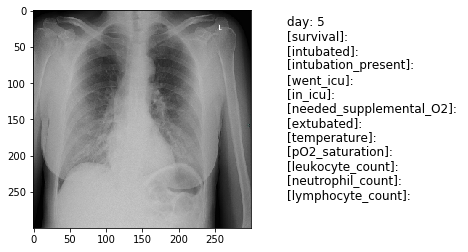

[Clincal Notes]: A 53-year-old woman was referred to our emergency department by her general practitioner (GP) because of increasing dyspnoea and suspicion of COVID-19 infection. Symptoms started five days prior with muscle ache, sore throat, cough, general malaise and fever up to 38�C. No other remarkable medical history was noted. Laboratory results showed only a mildly increased CRP (16 mg/L). There was no hypoxaemia. She was tested for COVID-19, influenza and respiratory syncytial virus. AP bedside chest X-ray. This demonstrated a normal size of the heart without evidence of alveolar consolidation or pleural effusion. However, there was a noticeable increase in interstitial trauma at the base of the lungs





Patient 182	[Gender]: M	[Age]: 34
[Patient Location]: Ospedale di Cattinara, Trieste, Italy


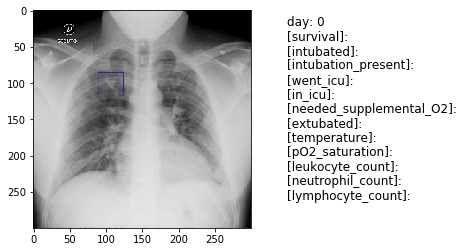

[Clincal Notes]: A previously healthy 34-year-old man presented to the emergency department with a 7-day history of high fever, dry cough and dyspnoea. Laboratory tests showed elevation of C-reactive protein (45 mg/L), while white cell count was normal. Chest X-ray performed on admission showed only a small opacity in the right upper perihilar region (Fig. 1).





Patient 183	[Gender]: F	[Age]: 30
[Patient Location]: University of California Irvine, Orange, California, USA


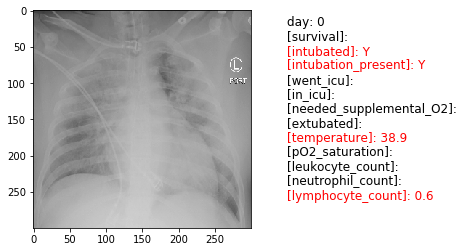

[Clincal Notes]: A 30-year-old female patient with a past medical history of asthma, morbid obesity (BMI 39.5), and hypertension on an angiotensin-converting enzyme (ACE) inhibitor presented with a 6-day history of fever (Tmax 38.9�C), cough, and shortness of breath. Laboratory studies were remarkable for lymphopenia (0.6�103/�L, normal range 0.9�103/�L � 3.3�103/�L), elevated serum creatinine (1.3 mg/dL, normal range 0.6 mg/dL � 1.2 mg/dL), elevated aspartate aminotransferase (73 IU/L, normal range 13 IU/L � 39 IU/L), elevated c-reactive protein (8.6 mg/dL, normal range 0 � 1 mg/dL), elevated procalcitonin (2.39 ng/mL, normal < 0.1 ng/mL), elevated interleukin-6 (197 pg/mL, normal ? 5 pg/mL), elevated cardiac troponin I (142 ng/L, normal < 15 ng/L), and mildly elevated d-dimer (570 ng/mL, normal < 500 ng/mL). She reported a history of contact with a COVID-positive co-worker and no recent travel. Influenza A/B RT-PCR were negative. She developed acute respiratory distress and was emerg

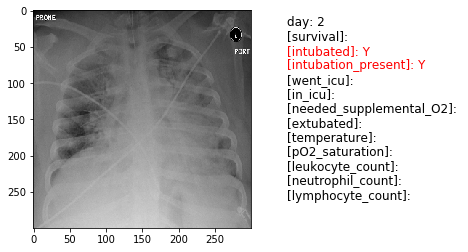

[Clincal Notes]: A 30-year-old female patient with a past medical history of asthma, morbid obesity (BMI 39.5), and hypertension on an angiotensin-converting enzyme (ACE) inhibitor presented with a 6-day history of fever (Tmax 38.9�C), cough, and shortness of breath. Laboratory studies were remarkable for lymphopenia (0.6�103/�L, normal range 0.9�103/�L � 3.3�103/�L), elevated serum creatinine (1.3 mg/dL, normal range 0.6 mg/dL � 1.2 mg/dL), elevated aspartate aminotransferase (73 IU/L, normal range 13 IU/L � 39 IU/L), elevated c-reactive protein (8.6 mg/dL, normal range 0 � 1 mg/dL), elevated procalcitonin (2.39 ng/mL, normal < 0.1 ng/mL), elevated interleukin-6 (197 pg/mL, normal ? 5 pg/mL), elevated cardiac troponin I (142 ng/L, normal < 15 ng/L), and mildly elevated d-dimer (570 ng/mL, normal < 500 ng/mL). She reported a history of contact with a COVID-positive co-worker and no recent travel. Influenza A/B RT-PCR were negative. She developed acute respiratory distress and was emerg

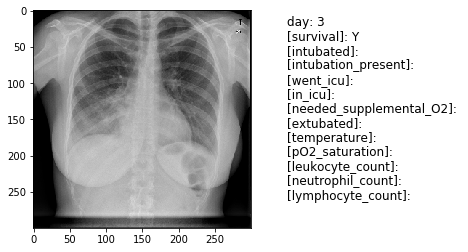

[Clincal Notes]: A 29-year-old immunocompromised female patient with a 3-day history of cough and fever. Past medical history includes severe ulcerative colitis treated with Tofacitinib. The patient was admitted to the hospital ward and discharged one week after admission with complete recovery. Chest X-ray: Increase of parenchymal opacity in right lower lobe.





Patient 185	[Gender]: F	[Age]: 78
[Patient Location]: Shanghai Public Health Clinical Center, Shanghai, China


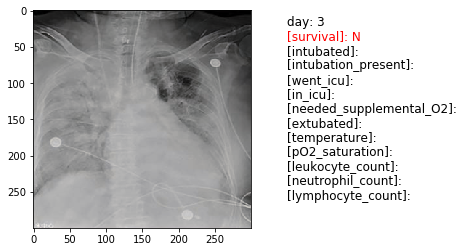

[Clincal Notes]: 79-year-old woman who presented with chest pain, cough, and fever for 3 days. Coronavirus disease (COVID-19) had recently been diagnosed in two of her household members. Patient developed acute respiratory distress syndrome within subsequent few days and died 11 days after admission. (Courtesy of Song F, Shanghai Public Health Clinical Center, Shanghai, China).  show ground glass opacification (GGO) on day 1.


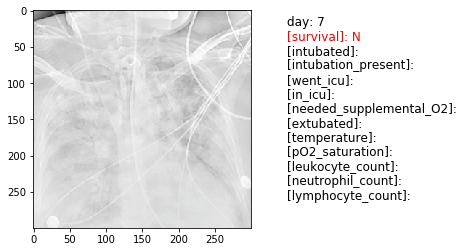

[Clincal Notes]: 79-year-old woman who presented with chest pain, cough, and fever for 3 days. Coronavirus disease (COVID-19) had recently been diagnosed in two of her household members. Patient developed acute respiratory distress syndrome within subsequent few days and died 11 days after admission. (Courtesy of Song F, Shanghai Public Health Clinical Center, Shanghai, China).  obtained on day 4 show GGO has progressed to airspace consolidation.





Patient 187	[Gender]: M	[Age]: 50
[Patient Location]: China


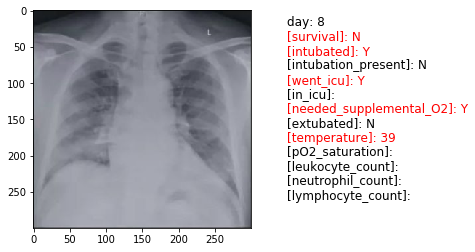

[Clincal Notes]: 50-year-old man was sent to the fever clinic for fever, chills, cough, fatigue, and shortness of breath. He reported the travel history of Wuhan from January 8 to 12, and the first symptoms appeared on January 14 (the first day of onset), manifested as mild chills and dry cough. But the patient continued to work until going to the hospital on January 21 (Figure 1). The patient underwent a chest radiograph and a pharyngeal swab in the hospital. The chest radiograph showed multiple patchy images of both lungs (Appendix p2). On January 22 (the 9th day of onset). He was immediately transferred to the isolation ward, and oxygen was given through the mask for oxygen support. Interferon alpha-2b (aerosol inhalation of 5 million U, bid) and lopinavir / ritonavir (500 mg, bid., Po) were used as antiviral treatment, and moxifloxacin (0.4 g, qd. , ivgtt) to prevent secondary infections. Given its severe shortness of breath and hypoxemia, methylprednisolone (80 mg, bid., Ivgtt) wa

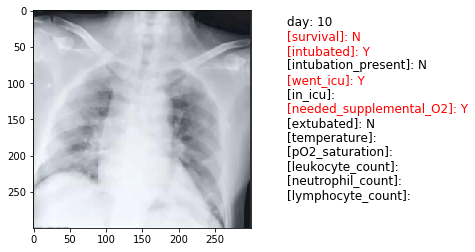

[Clincal Notes]: 50-year-old man was sent to the fever clinic for fever, chills, cough, fatigue, and shortness of breath. He reported the travel history of Wuhan from January 8 to 12, and the first symptoms appeared on January 14 (the first day of onset), manifested as mild chills and dry cough. But the patient continued to work until going to the hospital on January 21 (Figure 1). The patient underwent a chest radiograph and a pharyngeal swab in the hospital. The chest radiograph showed multiple patchy images of both lungs (Appendix p2). On January 22 (the 9th day of onset). He was immediately transferred to the isolation ward, and oxygen was given through the mask for oxygen support. Interferon alpha-2b (aerosol inhalation of 5 million U, bid) and lopinavir / ritonavir (500 mg, bid., Po) were used as antiviral treatment, and moxifloxacin (0.4 g, qd. , ivgtt) to prevent secondary infections. Given its severe shortness of breath and hypoxemia, methylprednisolone (80 mg, bid., Ivgtt) wa

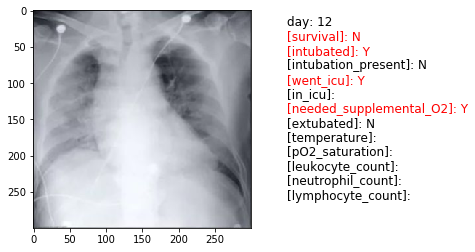

[Clincal Notes]: 50-year-old man was sent to the fever clinic for fever, chills, cough, fatigue, and shortness of breath. He reported the travel history of Wuhan from January 8 to 12, and the first symptoms appeared on January 14 (the first day of onset), manifested as mild chills and dry cough. But the patient continued to work until going to the hospital on January 21 (Figure 1). The patient underwent a chest radiograph and a pharyngeal swab in the hospital. The chest radiograph showed multiple patchy images of both lungs (Appendix p2). On January 22 (the 9th day of onset). He was immediately transferred to the isolation ward, and oxygen was given through the mask for oxygen support. Interferon alpha-2b (aerosol inhalation of 5 million U, bid) and lopinavir / ritonavir (500 mg, bid., Po) were used as antiviral treatment, and moxifloxacin (0.4 g, qd. , ivgtt) to prevent secondary infections. Given its severe shortness of breath and hypoxemia, methylprednisolone (80 mg, bid., Ivgtt) wa

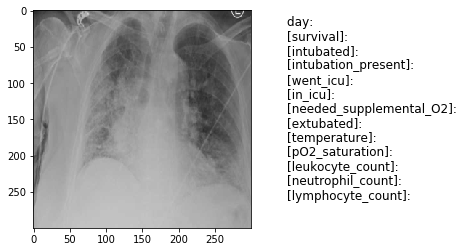

[Clincal Notes]: 





Patient 189	[Gender]: M	[Age]: 61
[Patient Location]: 


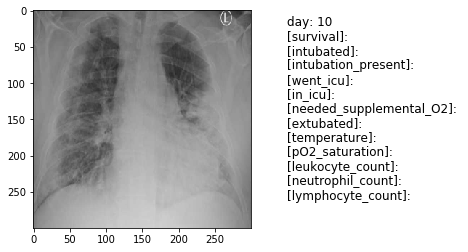

[Clincal Notes]: 





Patient 190	[Gender]: M	[Age]: 58
[Patient Location]: 


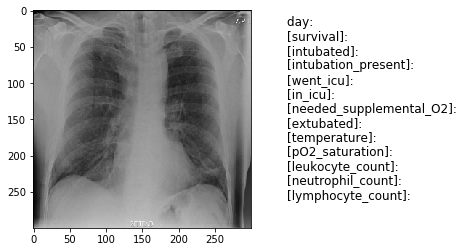

[Clincal Notes]: with co-infection


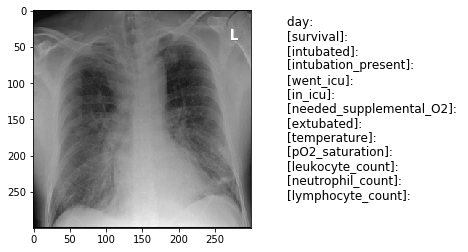

[Clincal Notes]: with co-infection


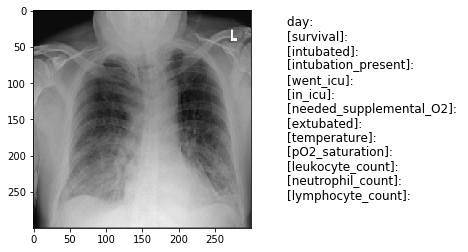

[Clincal Notes]: with co-infection





Patient 191	[Gender]: 	[Age]: 70
[Patient Location]: 


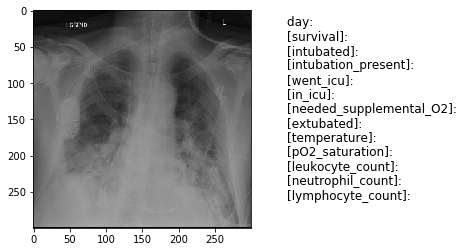

[Clincal Notes]: 


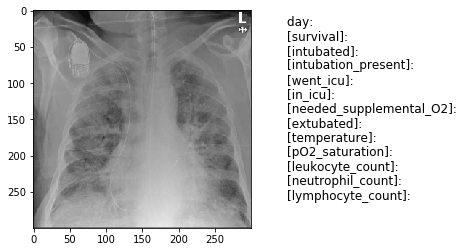

[Clincal Notes]: 





Patient 192	[Gender]: 	[Age]: 
[Patient Location]: 


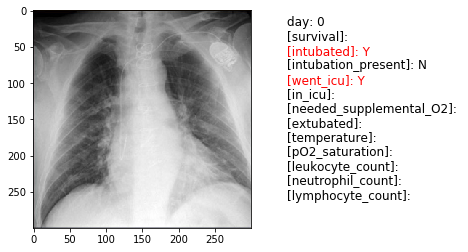

[Clincal Notes]: chest film normal on admission to hospital


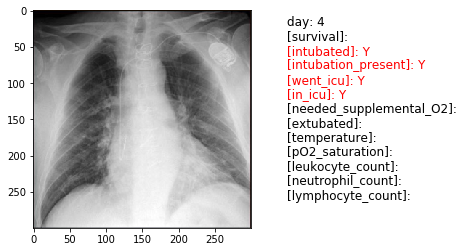

[Clincal Notes]: patient on mechanical ventilation with bilateral consolidations on the chest film





Patient 193	[Gender]: M	[Age]: 83
[Patient Location]: 


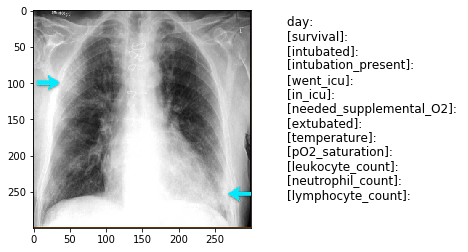

[Clincal Notes]: Chest film of a 83 year old male with mitral insufficiency, pulmonary hypertension and atrial fibrillation with COVID-19 infection. Ground-glass opacification and consolidation in right upper lobe and left lower lobe (arrows).





Patient 194	[Gender]: M	[Age]: 64
[Patient Location]: 


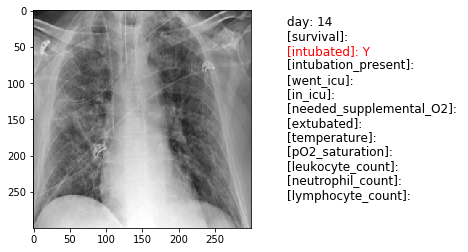

[Clincal Notes]: Within a few hours after presentation on the ER the patient became hypoxic and was treated with mechanical ventilation. Later that day the patient was transferred to another hospital. History: 64 year old male with fever and coughing for 2 weeks after a skiing holiday with his family. CT findings: Widespread GGO in all lobes. Crazy paving (blue arrows). Vascular enlargement (black arrow). Subpleural bands with retraction (yellow arrows). Consolidation and bronchiectasis posteriorly in the lower lobes. CORADS 5 - very high suspicion of COVID-19. PCR positive





Patient 195	[Gender]: M	[Age]: 83
[Patient Location]: 


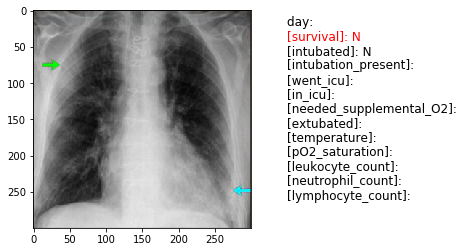

[Clincal Notes]: 83 year old male with mitral insufficiency and pulmonary hypertension was diagnosed with COVID-19 infection. The chest film shows consolidation in the right upper lobe (green arrow) and probably some consolidation in the left lower lobe. The patient decided not to be treat with mechanical ventilation and died four days later.





Patient 196	[Gender]: M	[Age]: 73
[Patient Location]: 


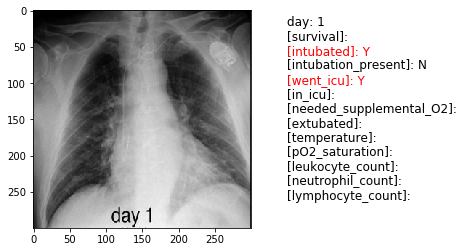

[Clincal Notes]: Day 1: normal findings. History: 73 year old male with aorta insufficiency and pacemaker was admitted to the hospital with fever and coughing after being in an area with COVID-19. PCR positive. Follow-up: extubated after 9 days of mechanical ventilation.


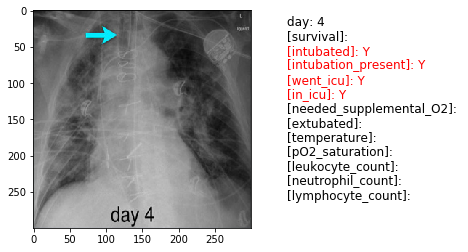

[Clincal Notes]: Day 4: bilateral consolidations intubated. History: 73 year old male with aorta insufficiency and pacemaker was admitted to the hospital with fever and coughing after being in an area with COVID-19. PCR positive. Follow-up: extubated after 9 days of mechanical ventilation.


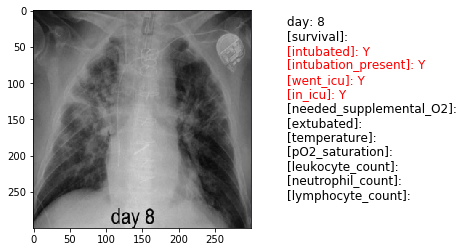

[Clincal Notes]: Day 8: bilateral consolidation. History: 73 year old male with aorta insufficiency and pacemaker was admitted to the hospital with fever and coughing after being in an area with COVID-19. PCR positive. Follow-up: extubated after 9 days of mechanical ventilation.


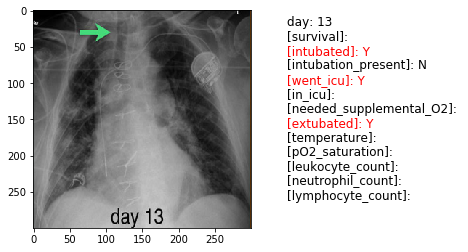

[Clincal Notes]: Day 13: extubation. History: 73 year old male with aorta insufficiency and pacemaker was admitted to the hospital with fever and coughing after being in an area with COVID-19. PCR positive. Follow-up: extubated after 9 days of mechanical ventilation.





Patient 197	[Gender]: F	[Age]: 72
[Patient Location]: Complejo Hospitalario de Navarra, Pamplona, Spain


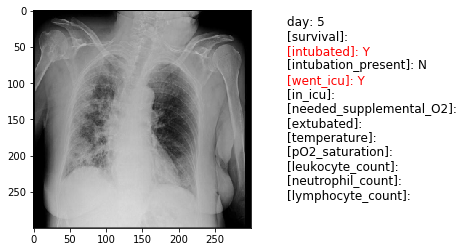

[Clincal Notes]: 72-year-old female came to the hospital with sore throat, cough, dyspnea, anosmia and fever for 5 days. Physical exam revealed no pathological findings. Biochemistry showed lymphopenia, decreased prothrombin activity, c-reactive protein increase and hypoxemia. RT-PCR was positive for COVID-19. No co-morbidities or risk factors were communicated. AP chest X-Ray: a reticular-nodular pattern in both lungs, mostly in the right one, was observed. In addition, mild opacities in the superior,middle and lower right lobes were depicted.


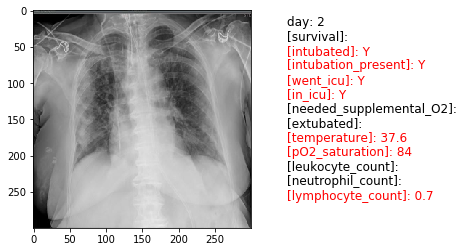

[Clincal Notes]: A 72-year-old female patient with a history of ischaemic stroke, ocular myasthenia, arterial hyper-tension, and hypercholesterolaemia was admitted to the emergency department because of dyspnoea. She reported having fever and cough for a week. At admission, her pulse oximeter saturation was 84%, the tympanic temperature was 37.6 �C. Laboratory findings revealed elevated C-reactive protein (19.69 mg/dL, normal range 0.01-0.5 mg/dL) and mild lymphopenia (0.7X10^3/mm^3, normal range 1.0-4.0 X10^3/mm^3). The patient also underwent non-contrast chest CT. AP chest X-ray obtained on the second day of admission demonstrated diffuse bilateral opacities, tracheal cannula, na-sogastric tube, internal jugular CVC





Patient 198	[Gender]: F	[Age]: 74
[Patient Location]: Complejo Hospitalario de Navarra, Pamplona, Spain


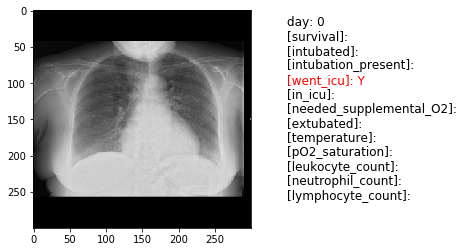

[Clincal Notes]: A 74-year-old woman with history of hypertension and heart disease, who had been discharged 10 days before knee prosthetic surgery, was admitted with 4-day history of fever, dry cough and dyspnoea. She had not left home since discharge and no family member was affected. Analysis revealed lymphopenia, elevation of C-reactive protein and a positive RT-PCR. The patient was admitted to the intensive care unit, with a favourable course. Chest X-ray at admission showed diffuse reticular pattern with small opacities in both basal regions


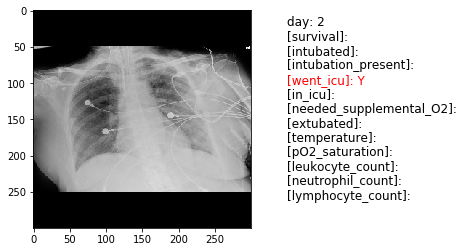

[Clincal Notes]: A 74-year-old woman with history of hypertension and heart disease, who had been discharged 10 days before knee prosthetic surgery, was admitted with 4-day history of fever, dry cough and dyspnoea. She had not left home since discharge and no family member was affected. Analysis revealed lymphopenia, elevation of C-reactive protein and a positive RT-PCR. The patient was admitted to the intensive care unit, with a favourable course. Chest X-ray on the second day showed diffuse reticular pattern and increased density in both lungs


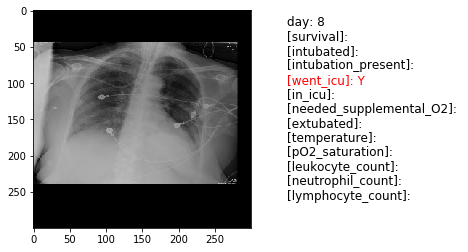

[Clincal Notes]: A 74-year-old woman with history of hypertension and heart disease, who had been discharged 10 days before knee prosthetic surgery, was admitted with 4-day history of fever, dry cough and dyspnoea. She had not left home since discharge and no family member was affected. Analysis revealed lymphopenia, elevation of C-reactive protein and a positive RT-PCR. The patient was admitted to the intensive care unit, with a favourable course. Chest x-ray on the eighth day showed improvement with decreased of high density and reticular pattern, more evident in the upper left lobe.





Patient 199	[Gender]: F	[Age]: 65
[Patient Location]: Centro Hospitalar Universit�rio do Porto, Porto, Portugal


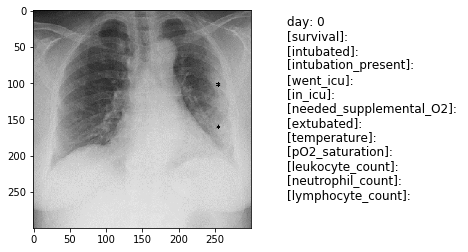

[Clincal Notes]: A sixty-five-year-old woman presented to the emergency department with a 5-day history of nausea and diarrhoea and a 2-day onset of non-productive cough and asthenia, without fever. Her husband had similar symptoms, and both had no epidemiological context for COVID-19 infection. She had type-2 diabetes-mellitus, arterial hypertension and chronic renal disease. Both were positive on RT-PCR test for COVID-19. Anteroposterior chest x-ray of a patient infected with COVID-19 that shows consolidations





Patient 200	[Gender]: M	[Age]: 88
[Patient Location]: Italy


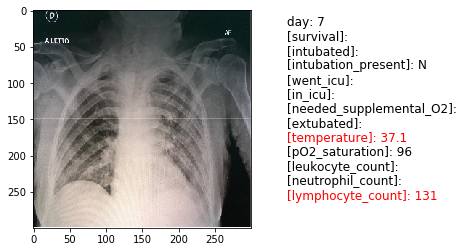

[Clincal Notes]: showing interstitial-alveolar hypodiaphania of the middle-basal field on the left and basal seat on the right, which is associated with pleural veiling on the left).





Patient 201	[Gender]: M	[Age]: 77
[Patient Location]: Italy


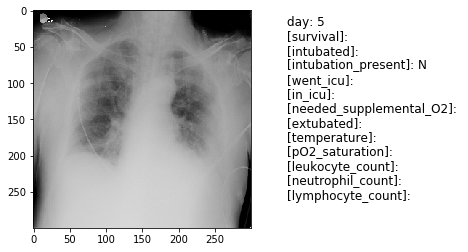

[Clincal Notes]: Softened confluent densities with peripheral distribution with associated interstitial weft thickening. No pleural effusion. Thickening with frosted glass with peripheral distribution and associated thickening of the interlobular septa, absence of pleural effusion and in the absence of significant ilo-mediastinal lymphadenopathies characterize the TC pattern, highly suggestive of CoViD-19, then found later with pharyngeal swab.





Patient 202	[Gender]: M	[Age]: 83
[Patient Location]: Italy


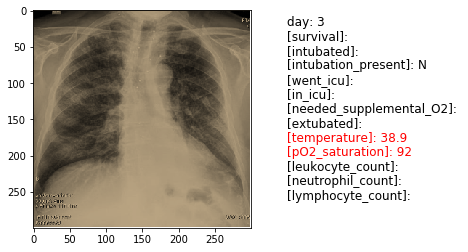

[Clincal Notes]: posterior bilateral interstitial engagement, at the base of the alveolar consolidation area with air bronchograms and moderate concomitant pleural effusion. The X-ray examination shows nuanced parenchymal thickening in the middle and lower field in the right hemithorax and in the middle field on the left.





Patient 203	[Gender]: F	[Age]: 45
[Patient Location]: Pakistan


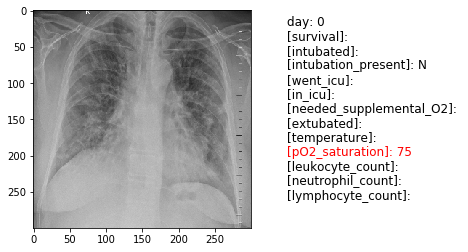

[Clincal Notes]: Fever, cough and shortness of breath on arrival patient saturation of oxygen was 75%. There is peripheral patchy air space opacification seen in both lung lower zones with diffuse ground-glass haze bilaterally. This is the initial plain film, raising suspicion of COVID-19 pneumonia. RT-PCR was sent which turned out to be positive. The patient was referred to a COVID-19 dedicated center for further treatment.





Patient 204	[Gender]: M	[Age]: 45
[Patient Location]: Turkey


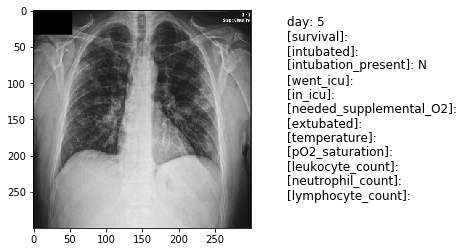

[Clincal Notes]: Fever, dry cough and dyspnea for few days.  Multiple peripheral opacifications, throughout both lungs.  





Patient 205	[Gender]: M	[Age]: 55
[Patient Location]: North Derbyshire, United Kingdom


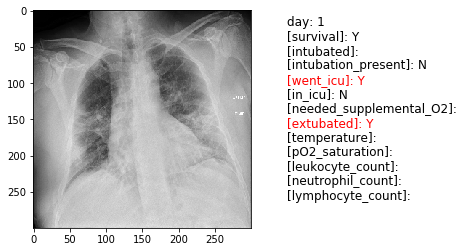

[Clincal Notes]: Moderate amount of mid zone airspace opacification in both mid zones with a peripheral predominance.


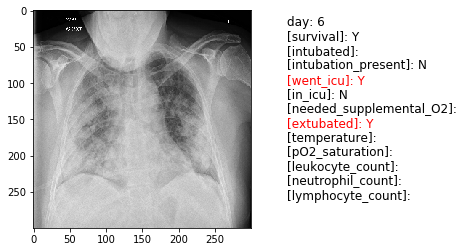

[Clincal Notes]: just stepped down from HDU. New oxygen requirements. Extensive bilateral airspace opacification in both lungs, more pronounced on the right and with relative sparing of the left upper lobe.  The airspace opacification has a peripheral distribution.  No pleural effusions. 


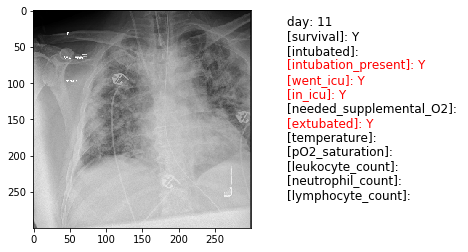

[Clincal Notes]: ITU admission, Endotracheal tube, nasogastric tube and right internal jugular lines suitable sited.  Bilateral airspace opacification persists, but it has partially regressed since the prior radiograph.


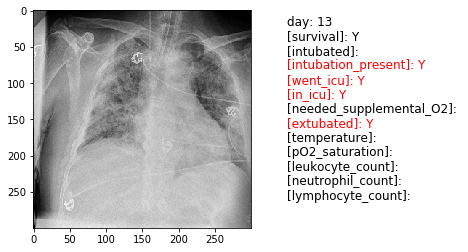

[Clincal Notes]: Lines and tubes suitably sited.  Minor regression in the appearances of the lungs from the radiograph of 2 days earlier.


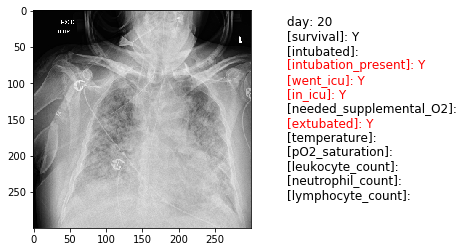

[Clincal Notes]: increasing oxygen requirements. Extubated.  Positive pressure ventilation mask in use.  Widespread bilateral airspace opacification in both lungs.  No longer is the distribution peripheral or sparing the apices.  No pleural effusions or lobar consolidation.


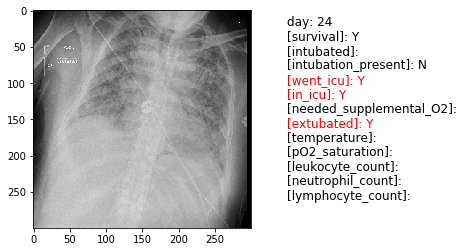

[Clincal Notes]: Extubated since the prior radiograph.  Partial regression of the diffuse lungs changes, however air bronchograms are now evident in both upper lobes.


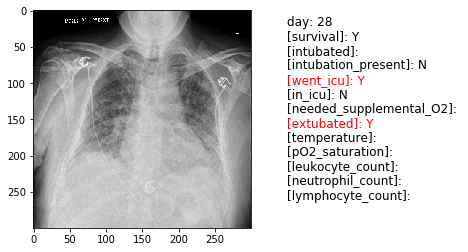

[Clincal Notes]: Remarkable improvement in appearances since the radiograph 4 days earlier.    The current appearances of the lungs are nearly normal and better than the day 1 admission appearances.





Patient 206	[Gender]: M	[Age]: 48
[Patient Location]: Hospital Hollabrunn, Hollabrunn, Austria


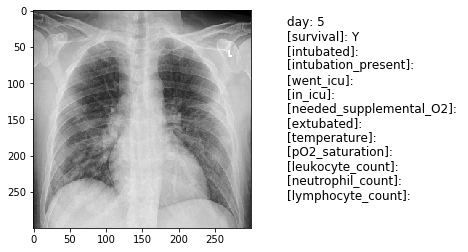

[Clincal Notes]: 48-year-old male patient with a five-day history of cough and fever. Past medical history was unremarkable. He also suffered from anosmia since three days. The patient was admitted to the hospital ward and discharged one week after admission with complete recovery. Chest X-ray: Peripheral ground glass opacities on both sides. Picture was taken five days after onset of symptoms


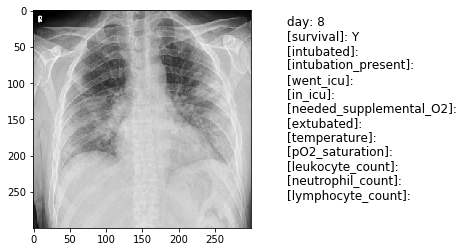

[Clincal Notes]: 48-year-old male patient with a five-day history of cough and fever. Past medical history was unremarkable. He also suffered from anosmia since three days. The patient was admitted to the hospital ward and discharged one week after admission with complete recovery. AP bedside chest X-ray: Three days later the patient deteriorated. Progressive opacities extending from the periphery to the center can be observed.


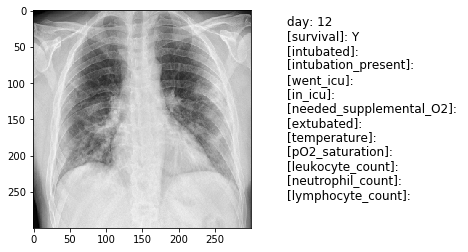

[Clincal Notes]: 48-year-old male patient with a five-day history of cough and fever. Past medical history was unremarkable. He also suffered from anosmia since three days. The patient was admitted to the hospital ward and discharged one week after admission with complete recovery. Chest X-ray: One week after the changes in chest radiography declined.





Patient 212	[Gender]: 	[Age]: 43
[Patient Location]: Humanitas Clinical and Research Hospital, Rozzano, Milan, Italy


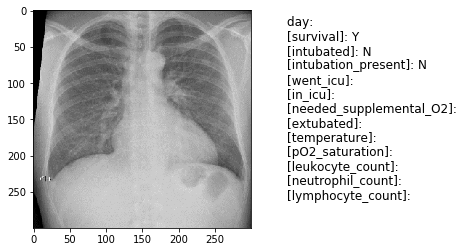

[Clincal Notes]: Patient 3 - CXR: Presence of two areas of parenchymal consolidations with possible inflammatory aetiology in the apical segment of the LUL and in the RLL.





Patient 213	[Gender]: 	[Age]: 46
[Patient Location]: Humanitas Clinical and Research Hospital, Rozzano, Milan, Italy


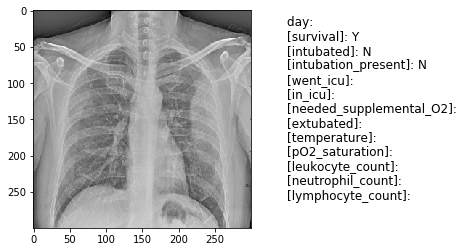

[Clincal Notes]: Patient 4 - CXR: diffuse consolidations, particularly visible in LUL. Patient required NIV with low-flow oxygen therapy.





Patient 215	[Gender]: 	[Age]: 38
[Patient Location]: Humanitas Clinical and Research Hospital, Rozzano, Milan, Italy


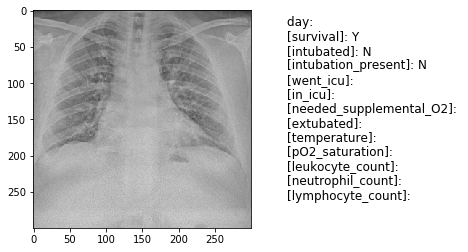

[Clincal Notes]: Patient 6 - CXR: Suspicious areas of parenchymal consolidations. Patient required NIV with low-flow oxygen therapy and CPAP.





Patient 216	[Gender]: M	[Age]: 58
[Patient Location]: Evangelismos General Hospital of Athens, Athens, Greece


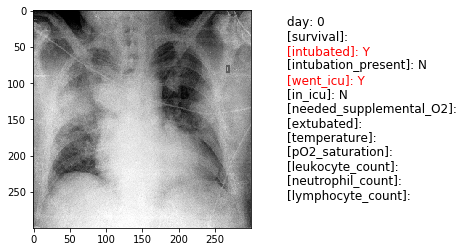

[Clincal Notes]: A 58-year old male non-smoking patient presented to our Emergency Department with progressive dyspnoea. Five days earlier, he complained of fever, sore throat and dry cough with positive RT-PCR test for COVID-19.  Medical history included chronic sinusitis without any known pathogen exposure. After 48 hours, due to worsening hypoxemia and deterioration of mental status, he was intubated on the 7th day after the initiation of symptoms. AP chest radiography: bilateral diffuse alveolar pulmonary consolidations, especially in the right upper and middle zones.





Patient 219	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


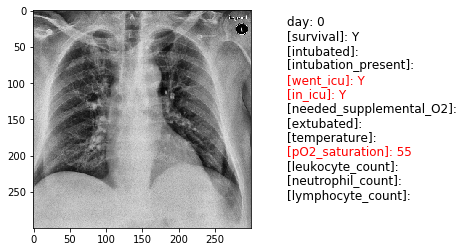

[Clincal Notes]: 


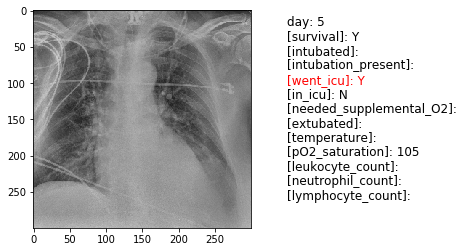

[Clincal Notes]: 





Patient 221	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


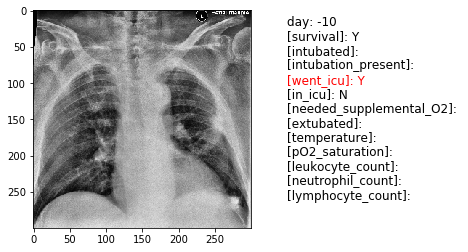

[Clincal Notes]: 


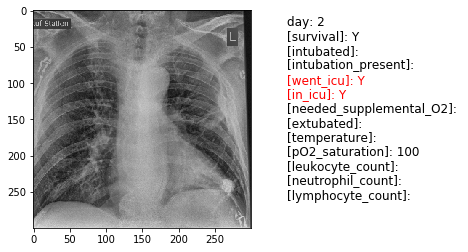

[Clincal Notes]: 


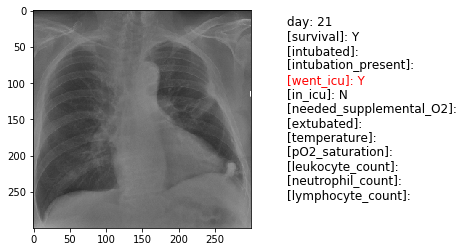

[Clincal Notes]: 





Patient 222	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


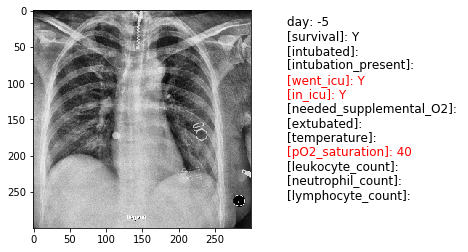

[Clincal Notes]: 


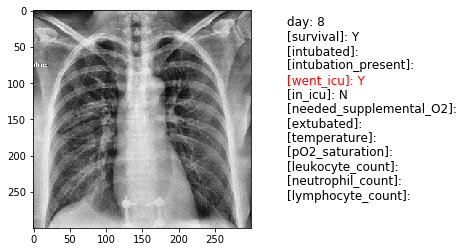

[Clincal Notes]: 





Patient 223	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


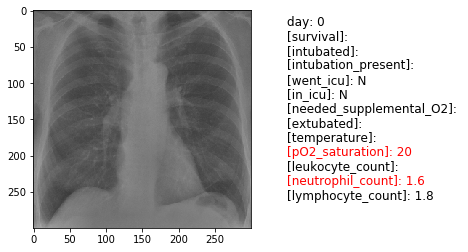

[Clincal Notes]: 





Patient 224	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


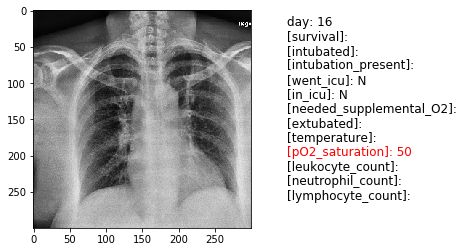

[Clincal Notes]: 





Patient 225	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


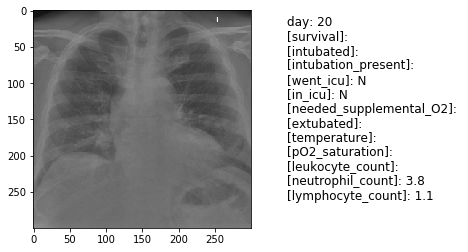

[Clincal Notes]: 


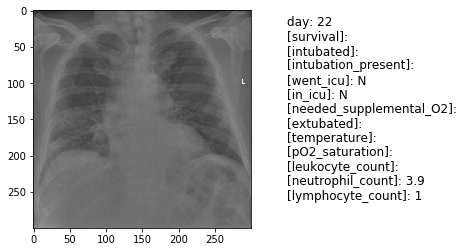

[Clincal Notes]: 





Patient 226	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


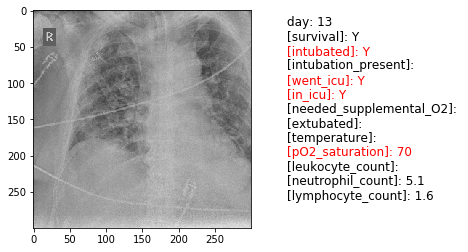

[Clincal Notes]: 


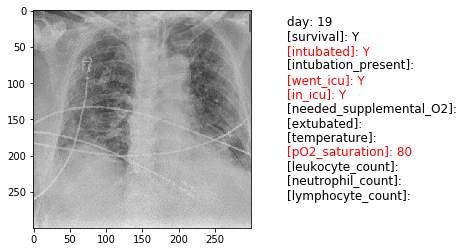

[Clincal Notes]: 


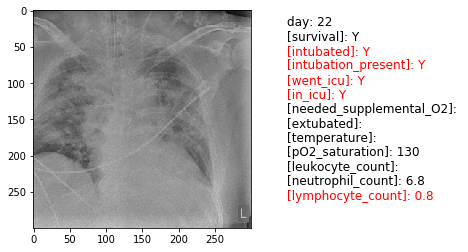

[Clincal Notes]: 





Patient 227	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


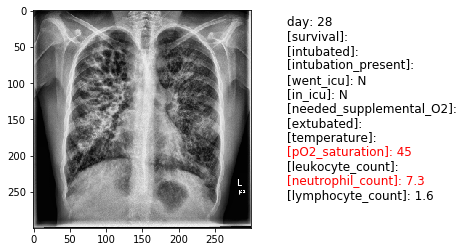

[Clincal Notes]: 





Patient 229	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


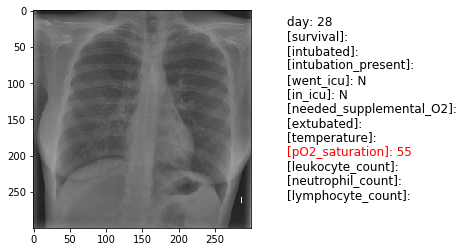

[Clincal Notes]: 





Patient 230	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


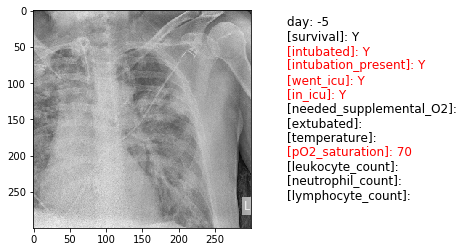

[Clincal Notes]: 


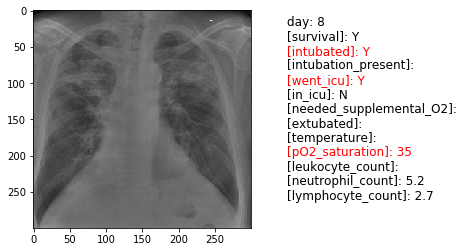

[Clincal Notes]: 





Patient 232	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


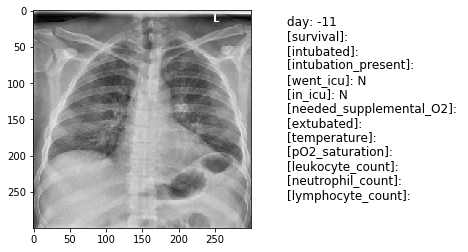

[Clincal Notes]: 





Patient 233	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


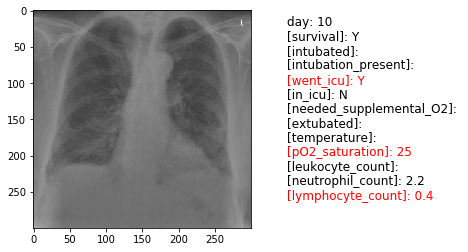

[Clincal Notes]: 





Patient 234	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


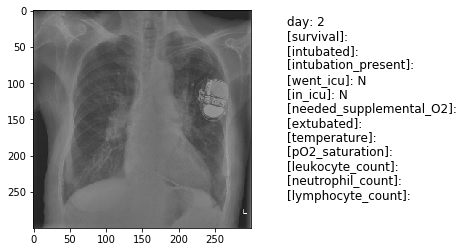

[Clincal Notes]: 





Patient 235	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


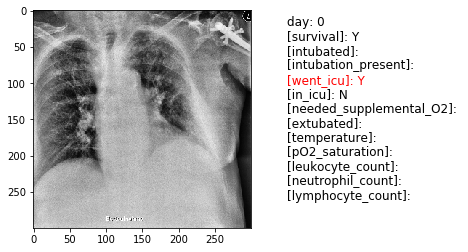

[Clincal Notes]: 


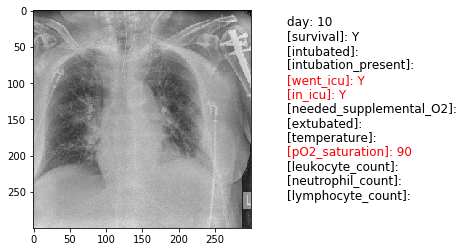

[Clincal Notes]: 


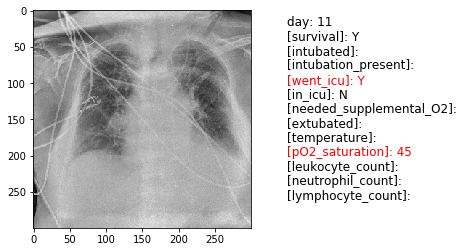

[Clincal Notes]: 





Patient 236	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


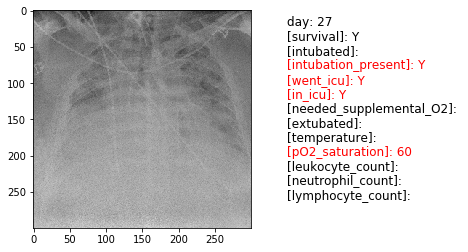

[Clincal Notes]: 





Patient 237	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


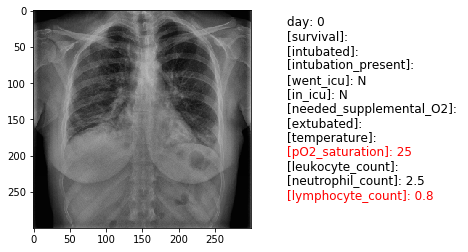

[Clincal Notes]: 





Patient 239	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


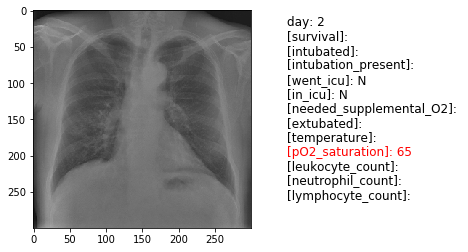

[Clincal Notes]: 





Patient 240	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


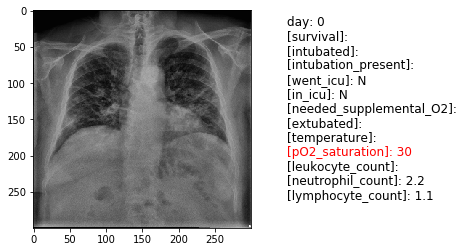

[Clincal Notes]: 





Patient 241	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


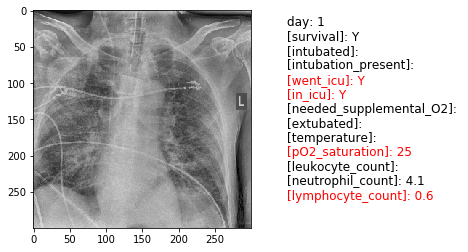

[Clincal Notes]: 





Patient 242	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


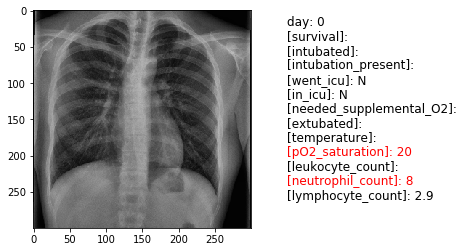

[Clincal Notes]: 





Patient 243	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


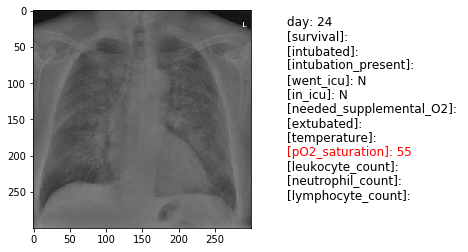

[Clincal Notes]: 


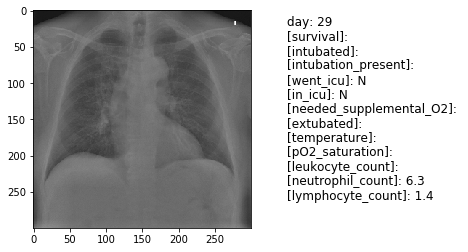

[Clincal Notes]: 





Patient 244	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


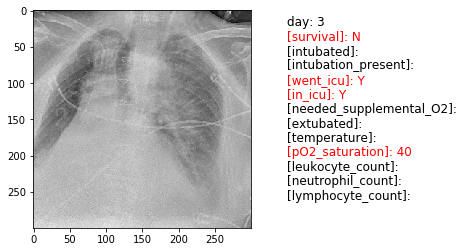

[Clincal Notes]: 


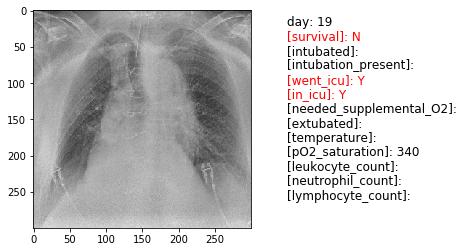

[Clincal Notes]: 





Patient 245	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


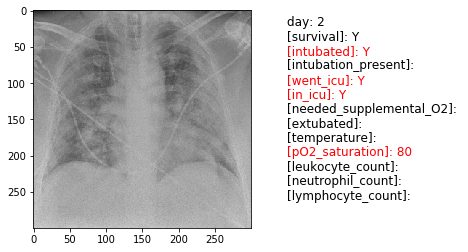

[Clincal Notes]: 


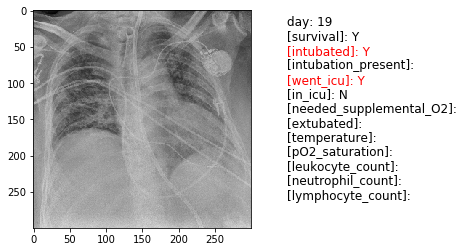

[Clincal Notes]: 


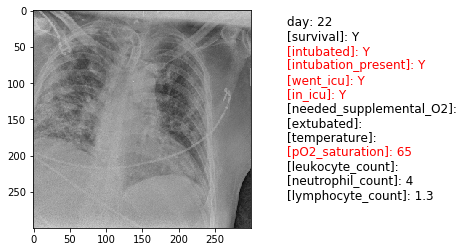

[Clincal Notes]: 


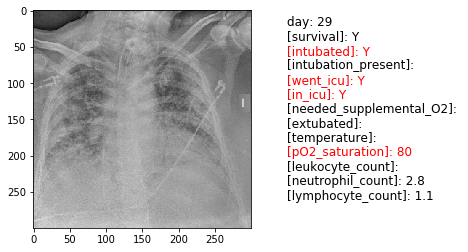

[Clincal Notes]: 


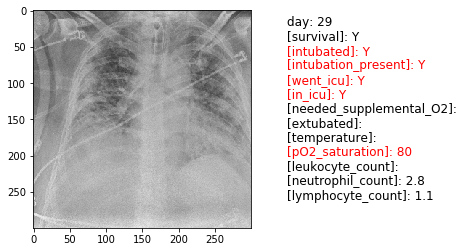

[Clincal Notes]: 





Patient 246	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


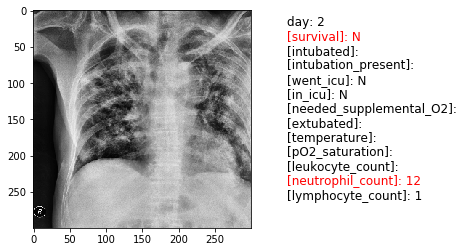

[Clincal Notes]: 


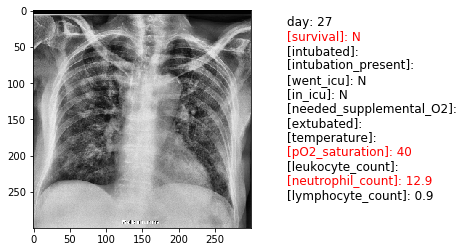

[Clincal Notes]: 





Patient 247	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


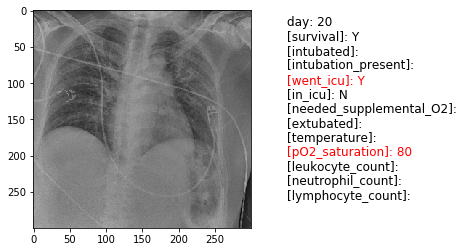

[Clincal Notes]: 





Patient 248	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


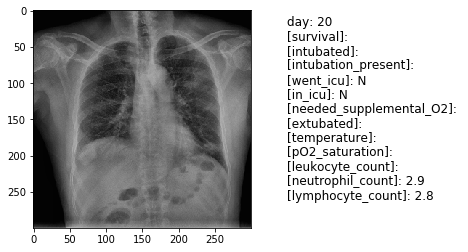

[Clincal Notes]: 





Patient 249	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


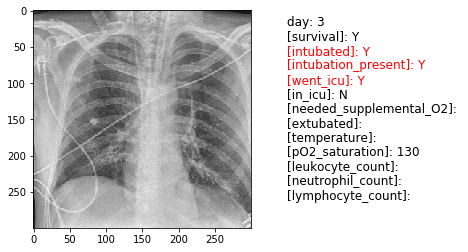

[Clincal Notes]: 


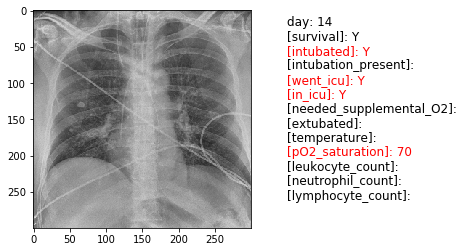

[Clincal Notes]: 


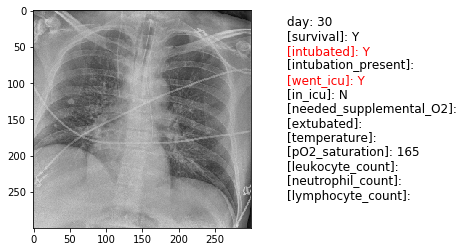

[Clincal Notes]: 





Patient 250	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


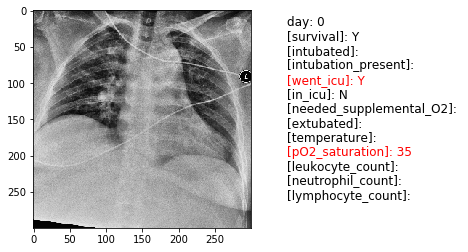

[Clincal Notes]: 


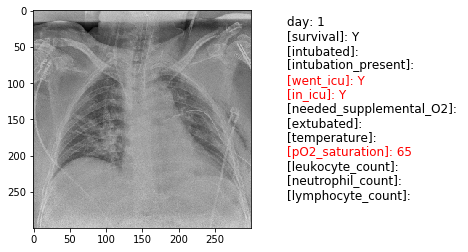

[Clincal Notes]: 


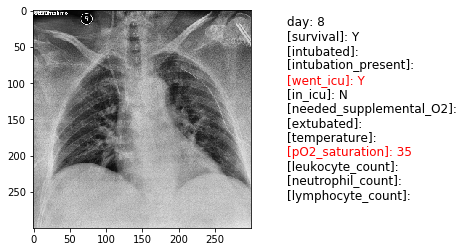

[Clincal Notes]: 


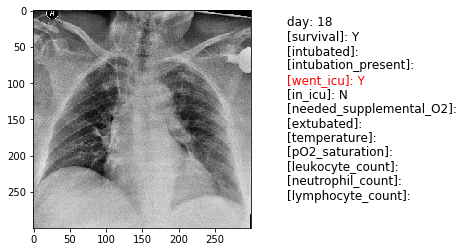

[Clincal Notes]: 


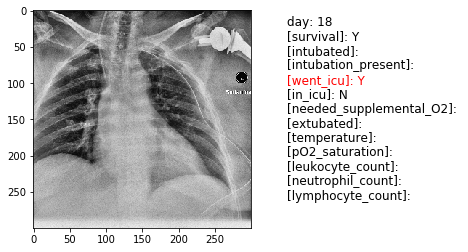

[Clincal Notes]: 


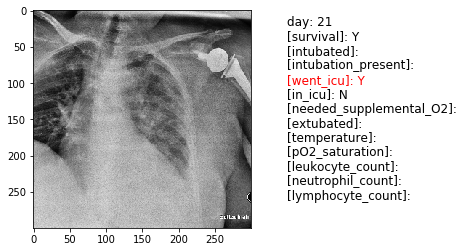

[Clincal Notes]: 


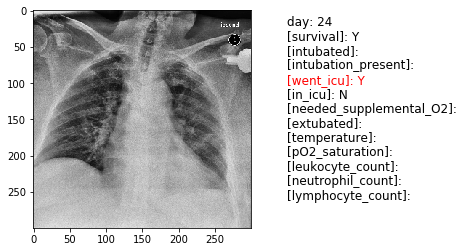

[Clincal Notes]: 





Patient 251	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


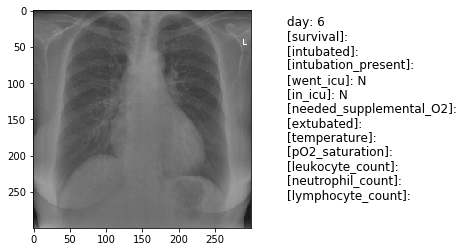

[Clincal Notes]: 


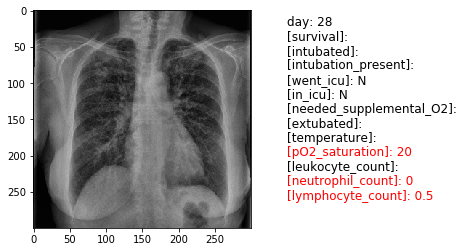

[Clincal Notes]: 





Patient 252	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


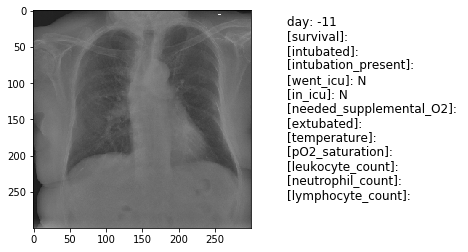

[Clincal Notes]: 


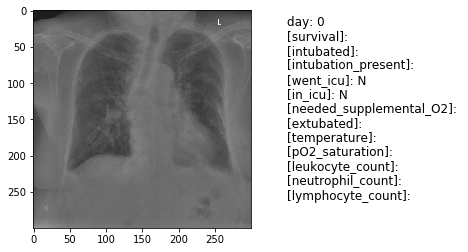

[Clincal Notes]: 





Patient 253	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


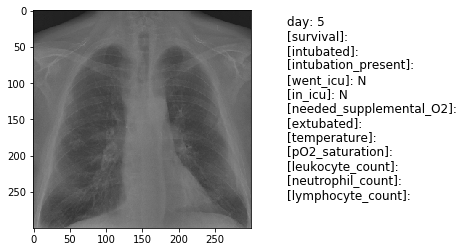

[Clincal Notes]: 


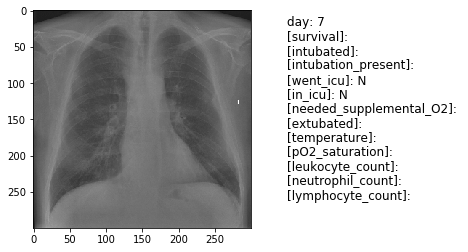

[Clincal Notes]: 


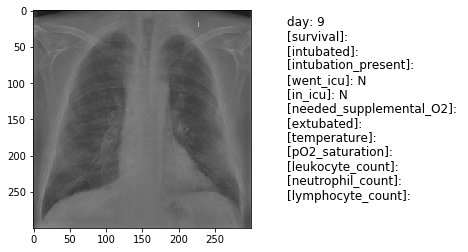

[Clincal Notes]: 


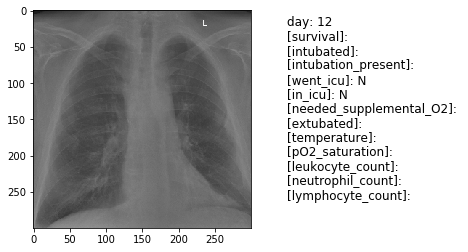

[Clincal Notes]: 


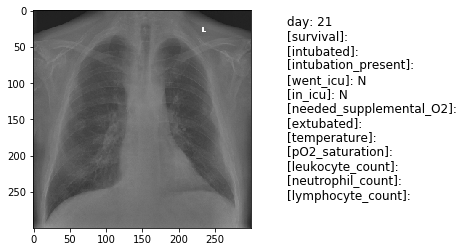

[Clincal Notes]: 


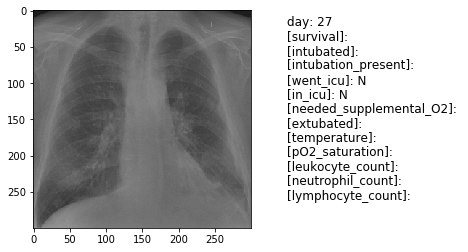

[Clincal Notes]: 


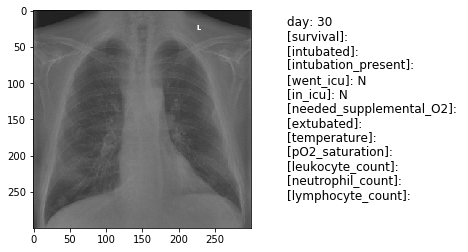

[Clincal Notes]: 


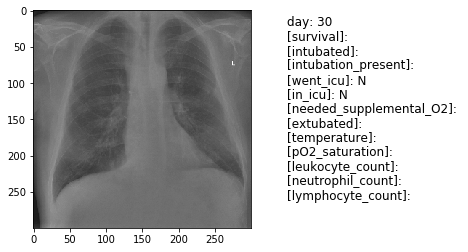

[Clincal Notes]: 





Patient 254	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


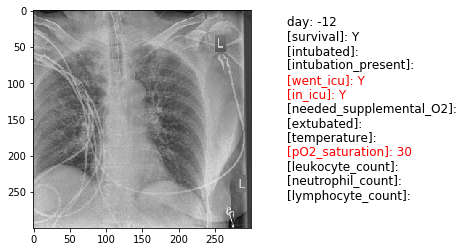

[Clincal Notes]: 


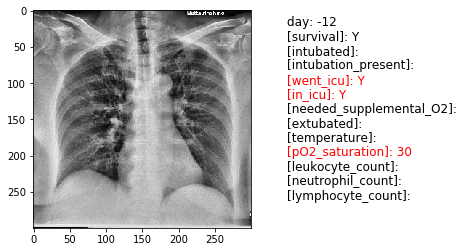

[Clincal Notes]: 





Patient 257	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


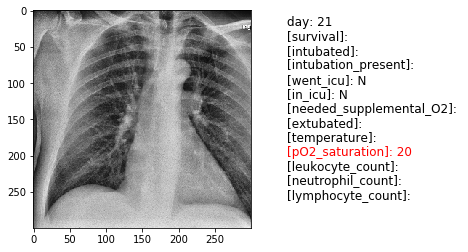

[Clincal Notes]: 





Patient 258	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


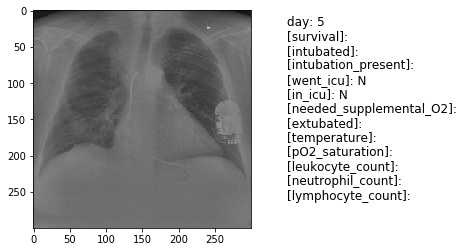

[Clincal Notes]: 





Patient 259	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


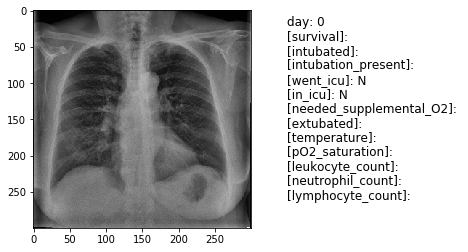

[Clincal Notes]: 





Patient 261	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


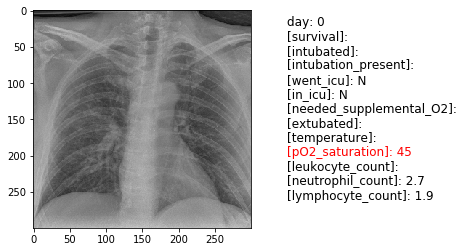

[Clincal Notes]: 





Patient 263	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


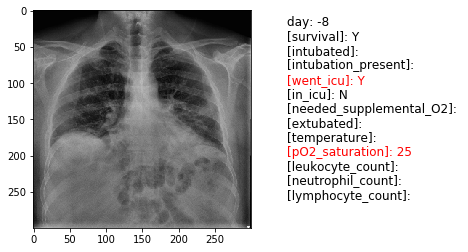

[Clincal Notes]: 


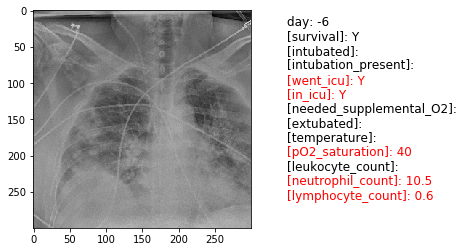

[Clincal Notes]: 


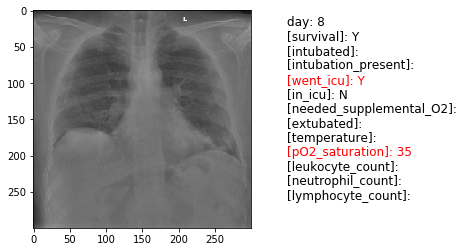

[Clincal Notes]: 





Patient 264	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


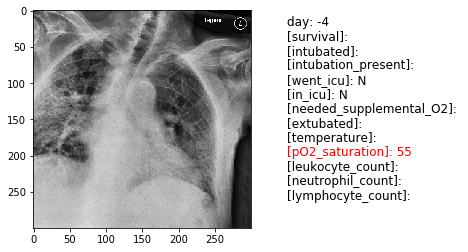

[Clincal Notes]: 


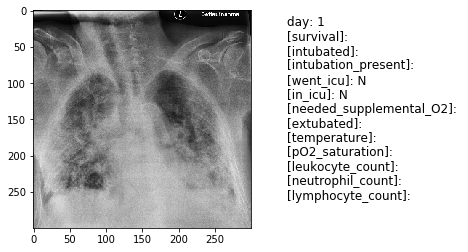

[Clincal Notes]: 


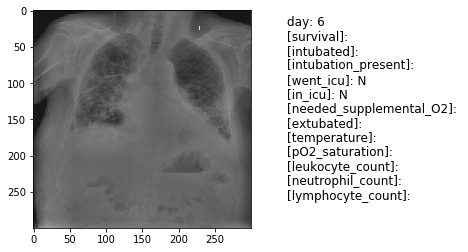

[Clincal Notes]: 





Patient 266	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


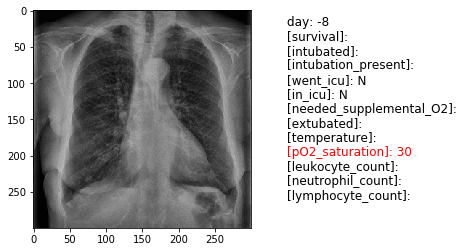

[Clincal Notes]: 





Patient 267	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


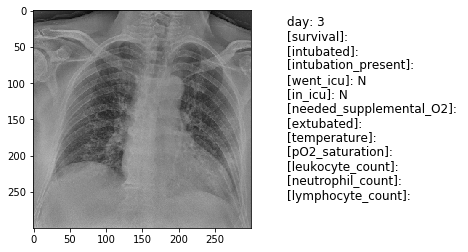

[Clincal Notes]: 





Patient 268	[Gender]: F	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


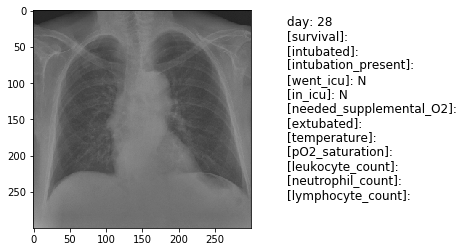

[Clincal Notes]: 





Patient 269	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


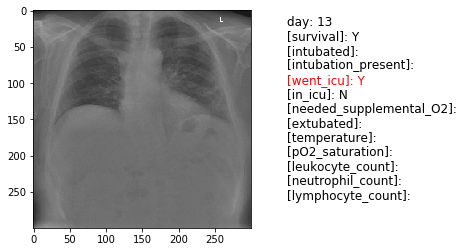

[Clincal Notes]: 





Patient 270	[Gender]: M	[Age]: 
[Patient Location]: Hannover Medical School, Hannover, Germany


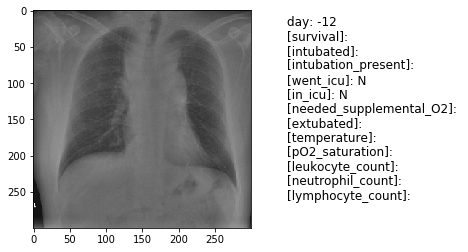

[Clincal Notes]: 


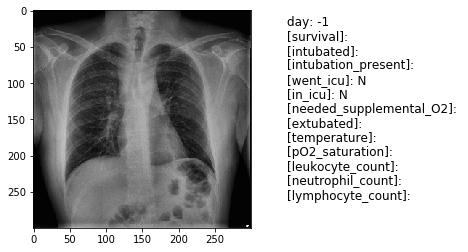

[Clincal Notes]: 


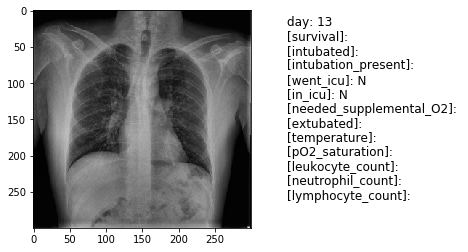

[Clincal Notes]: 





Patient 288	[Gender]: M	[Age]: 61
[Patient Location]: Wuhan, China


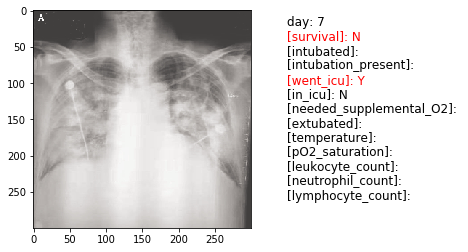

[Clincal Notes]: Patient 2 initially reported fever and cough on December 20, 2019; respiratory distress developed 7 days after the onset of illness and worsened over the next 2 days (see chest radiographs, Figure 1), at which time mechanical ventilation was started. He had been a frequent visitor to the seafood wholesale market. 


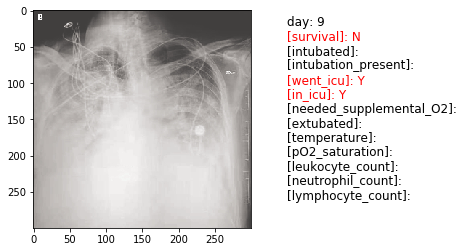

[Clincal Notes]: Patient 2 initially reported fever and cough on December 20, 2019; respiratory distress developed 7 days after the onset of illness and worsened over the next 2 days (see chest radiographs, Figure 1), at which time mechanical ventilation was started. He had been a frequent visitor to the seafood wholesale market. 





Patient 289	[Gender]: 	[Age]: 
[Patient Location]: 


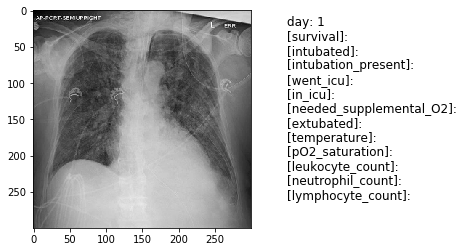

[Clincal Notes]: Chest X-Ray of a symptomatic patient on hospital days 1 (a), 3 (b), and 5 (c). Note the rapid progression of the pulmonary infiltrates over time


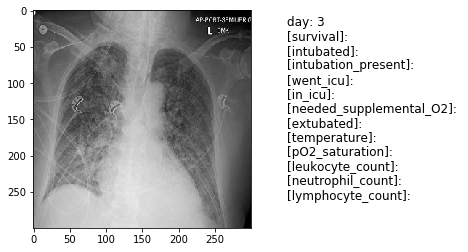

[Clincal Notes]: Chest X-Ray of a symptomatic patient on hospital days 1 (a), 3 (b), and 5 (c). Note the rapid progression of the pulmonary infiltrates over time


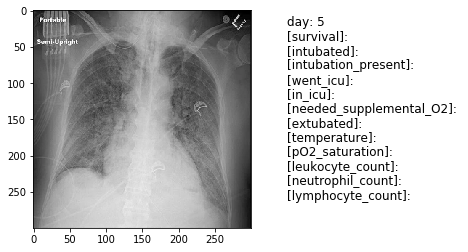

[Clincal Notes]: Chest X-Ray of a symptomatic patient on hospital days 1 (a), 3 (b), and 5 (c). Note the rapid progression of the pulmonary infiltrates over time





Patient 290	[Gender]: F	[Age]: 63
[Patient Location]: Brescia, Italy


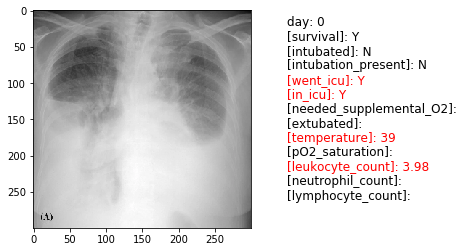

[Clincal Notes]: A 63-year-old woman with metastatic ovarian cancer and recurrent malignant pleural effusion came to our institutional ER with fever (39 ?C) and dyspnea at rest. Being our institute located in a severely involved area of the COVID-19 outbreak, clinical symptoms were compatible with COVID-19 infection. Laboratory parameters included hemoglobin 10.7, white blood cells 3.98, C-reactive protein 43.5, arterial pH 7.5, pO2 53 mmHg, pCO2 31 mmHg and blood lactate concentration 1 mmol/L. Although the patient underwent a right pleurodesis 6 months ago, chest X-ray showed bilateral pleural effusion (loculated on the right side) as well as interstitial thickening (Fig. 1A), a common imaging feature in COVID-19. She underwent a naso-/oropharyngeal swab which turned positive for SARS-CoV-2 nucleic acid after being processed through a real-time reverse transcriptase polymerase chain reaction (Novel Coronavirus PCR Fluorescence Diagnostic Kit, BioGerm Medical Biotechnology). She start

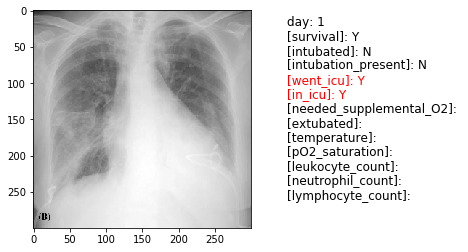

[Clincal Notes]: A 63-year-old woman with metastatic ovarian cancer and recurrent malignant pleural effusion came to our institutional ER with fever (39 ?C) and dyspnea at rest. Being our institute located in a severely involved area of the COVID-19 outbreak, clinical symptoms were compatible with COVID-19 infection. Laboratory parameters included hemoglobin 10.7, white blood cells 3.98, C-reactive protein 43.5, arterial pH 7.5, pO2 53 mmHg, pCO2 31 mmHg and blood lactate concentration 1 mmol/L. Although the patient underwent a right pleurodesis 6 months ago, chest X-ray showed bilateral pleural effusion (loculated on the right side) as well as interstitial thickening (Fig. 1A), a common imaging feature in COVID-19. She underwent a naso-/oropharyngeal swab which turned positive for SARS-CoV-2 nucleic acid after being processed through a real-time reverse transcriptase polymerase chain reaction (Novel Coronavirus PCR Fluorescence Diagnostic Kit, BioGerm Medical Biotechnology). She start

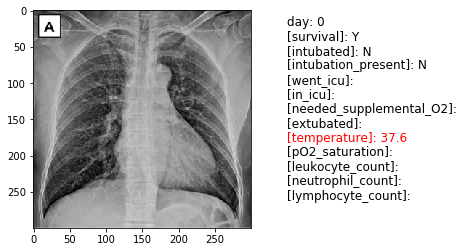

[Clincal Notes]: we report a case of COVID-19 pneumonia in a 61-year-old female RA patient who was receiving conventional disease-modifying antirheumatic drugs (cDMARDs). The patient presented with a 4-day history of myalgia and febrile sensation. COVID-19 was confirmed by real-time polymerase chain reaction (PCR). Chest X-ray showed increased opacity on the right lower lung area, and C-reactive protein level was slightly elevated. The patient was treated with antiviral agents (lopinavir/ritonavir), and treatment with cDMARDs was discontinued except hydroxychloroquine. Her symptoms and laboratory results gradually improved. Three weeks later, real-time PCR for COVID-19 showed negative conversion, and the patient was discharged without any complications. a No abnormal findings were observed at hospitalization day 1.


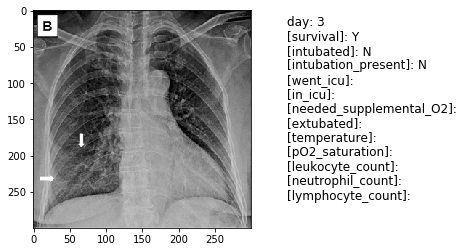

[Clincal Notes]: we report a case of COVID-19 pneumonia in a 61-year-old female RA patient who was receiving conventional disease-modifying antirheumatic drugs (cDMARDs). The patient presented with a 4-day history of myalgia and febrile sensation. COVID-19 was confirmed by real-time polymerase chain reaction (PCR). Chest X-ray showed increased opacity on the right lower lung area, and C-reactive protein level was slightly elevated. The patient was treated with antiviral agents (lopinavir/ritonavir), and treatment with cDMARDs was discontinued except hydroxychloroquine. Her symptoms and laboratory results gradually improved. Three weeks later, real-time PCR for COVID-19 showed negative conversion, and the patient was discharged without any complications. b Haziness was observed on the right lower lung area at hospitalization day 3.


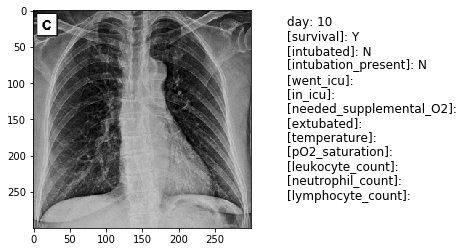

[Clincal Notes]: we report a case of COVID-19 pneumonia in a 61-year-old female RA patient who was receiving conventional disease-modifying antirheumatic drugs (cDMARDs). The patient presented with a 4-day history of myalgia and febrile sensation. COVID-19 was confirmed by real-time polymerase chain reaction (PCR). Chest X-ray showed increased opacity on the right lower lung area, and C-reactive protein level was slightly elevated. The patient was treated with antiviral agents (lopinavir/ritonavir), and treatment with cDMARDs was discontinued except hydroxychloroquine. Her symptoms and laboratory results gradually improved. Three weeks later, real-time PCR for COVID-19 showed negative conversion, and the patient was discharged without any complications. c Resorption of haziness on right lower lung area was observed at hospitalization day 10





Patient 292	[Gender]: F	[Age]: 54
[Patient Location]: Brescia, Italy


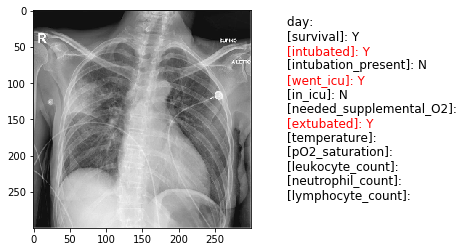

[Clincal Notes]: A 54 years old women, with a past medical history of anterior communicating artery (AComA) aneurysm treated surgically 20 years before, was found unconscious at home. When the rescue arrived, she regained consciousness and became unrest. At the emergency department, a brief neurological examination revealed a GCS of 12 (E3 M6 V3), without focal sensorimotor deficits. No signs of both tongue biting and incontinence were reported by the familiars. Anosmia and ageusia were referred by several days. Head CT scan was normal (Fig. 1). Chest X-ray (Fig. 2) revealed an interstitial pneumonia (IP), and real-time polymerase chain reaction (RT-PCR) for SARS-CoV-2 was positive.





Patient 293	[Gender]: 	[Age]: 55
[Patient Location]: Seattle, USA


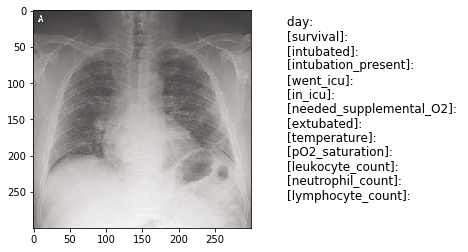

[Clincal Notes]: An initial radiograph (anteroposterior view) of the chest at admission (Panel A) shows hazy opacities in the upper and mid lung zones. Another chest radiograph obtained approximately 24 hours after the initial presentation (Panel B) shows worsening multifocal air-space opacities. Axial CT images (Panels C and D) and coronal reformats (Panel E) obtained within 2 hours after the chest radiograph in Panel B show extensive ground glass opacities and occasional foci of consolidation.


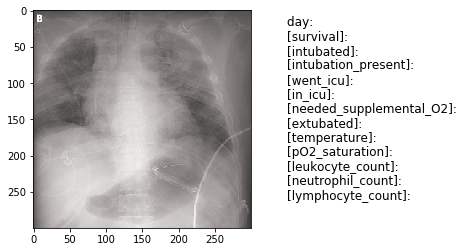

[Clincal Notes]: An initial radiograph (anteroposterior view) of the chest at admission (Panel A) shows hazy opacities in the upper and mid lung zones. Another chest radiograph obtained approximately 24 hours after the initial presentation (Panel B) shows worsening multifocal air-space opacities. Axial CT images (Panels C and D) and coronal reformats (Panel E) obtained within 2 hours after the chest radiograph in Panel B show extensive ground glass opacities and occasional foci of consolidation.





Patient 294	[Gender]: M	[Age]: 72
[Patient Location]: Brescia, Italy


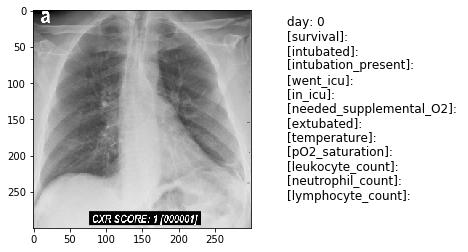

[Clincal Notes]: Serial chest X-ray findings in a 72-year-old male patient with COVID-19 pneumonia. a Baseline frontal chest radiograph performed on the day of admission (one day after the onset of fever).


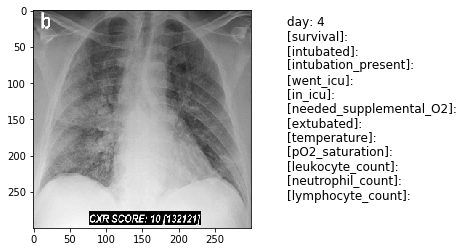

[Clincal Notes]: Serial chest X-ray findings in a 72-year-old male patient with COVID-19 pneumonia. a Baseline frontal chest radiograph performed on the day of admission (one day after the onset of fever). A rapid progression of the lung disease is shown on radiographic follow-ups performed at day 4 (b) and day 5 (c) post-hospitalization


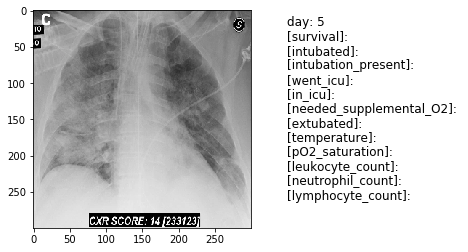

[Clincal Notes]: Serial chest X-ray findings in a 72-year-old male patient with COVID-19 pneumonia. a Baseline frontal chest radiograph performed on the day of admission (one day after the onset of fever). A rapid progression of the lung disease is shown on radiographic follow-ups performed at day 4 (b) and day 5 (c) post-hospitalization





Patient 295	[Gender]: 	[Age]: 
[Patient Location]: Brescia, Italy


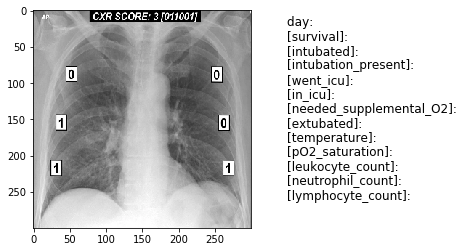

[Clincal Notes]: 





Patient 296	[Gender]: 	[Age]: 
[Patient Location]: Brescia, Italy


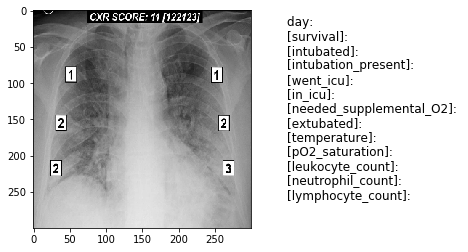

[Clincal Notes]: 





Patient 297	[Gender]: M	[Age]: 73
[Patient Location]: Brescia, Italy


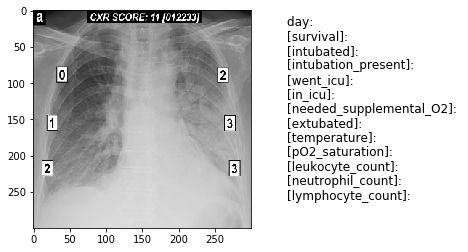

[Clincal Notes]: 





Patient 298	[Gender]: F	[Age]: 74
[Patient Location]: Brescia, Italy


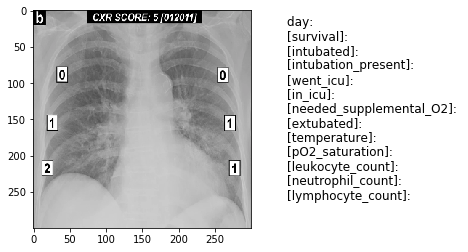

[Clincal Notes]: 





Patient 299	[Gender]: M	[Age]: 73
[Patient Location]: Padova, Italy


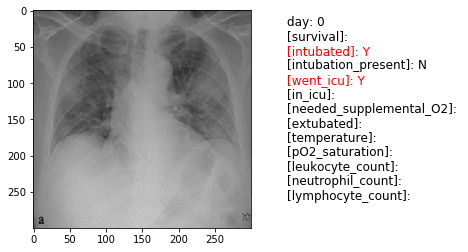

[Clincal Notes]: Chest X-rays of a 73-year-old male patient affected by COVID-19 (a?d). The first chest radiograph at admission demonstrated bilateral pulmonary perihilar consolidations (a). Due to a worsening of the clinical conditions, during the second day after admission, he underwent endotracheal intubation (b) with a significant improvement of the radiological findings within 24 h (c). 72 h later, the radiological findings worsened again especially in the left lung (d)


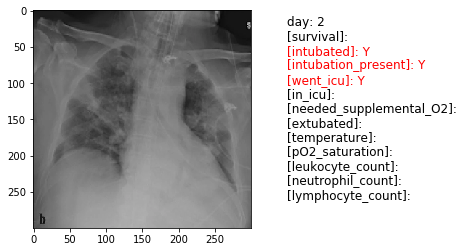

[Clincal Notes]: Chest X-rays of a 73-year-old male patient affected by COVID-19 (a?d). The first chest radiograph at admission demonstrated bilateral pulmonary perihilar consolidations (a). Due to a worsening of the clinical conditions, during the second day after admission, he underwent endotracheal intubation (b) with a significant improvement of the radiological findings within 24 h (c). 72 h later, the radiological findings worsened again especially in the left lung (d)


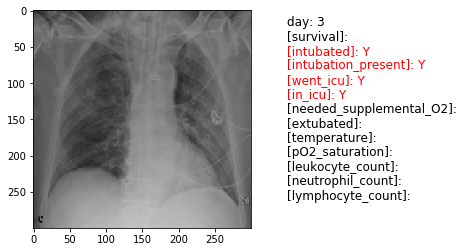

[Clincal Notes]: Chest X-rays of a 73-year-old male patient affected by COVID-19 (a?d). The first chest radiograph at admission demonstrated bilateral pulmonary perihilar consolidations (a). Due to a worsening of the clinical conditions, during the second day after admission, he underwent endotracheal intubation (b) with a significant improvement of the radiological findings within 24 h (c). 72 h later, the radiological findings worsened again especially in the left lung (d)


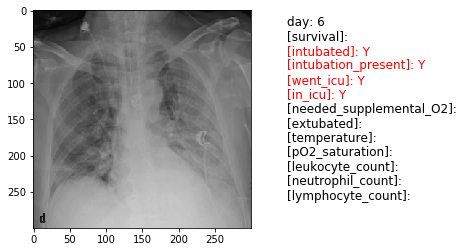

[Clincal Notes]: Chest X-rays of a 73-year-old male patient affected by COVID-19 (a?d). The first chest radiograph at admission demonstrated bilateral pulmonary perihilar consolidations (a). Due to a worsening of the clinical conditions, during the second day after admission, he underwent endotracheal intubation (b) with a significant improvement of the radiological findings within 24 h (c). 72 h later, the radiological findings worsened again especially in the left lung (d)





Patient 300	[Gender]: M	[Age]: 27
[Patient Location]: Padova, Italy


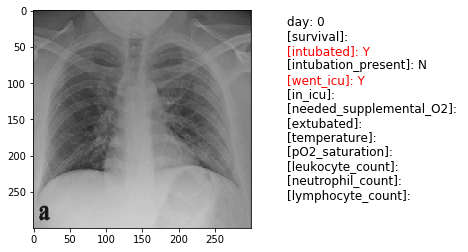

[Clincal Notes]: Chest X-rays of a 27-year-old male patient with COVID-19 (a?d). The first radiograph at admission demonstrated a mild interstitial thickening in the lower lobes (a). Within 72 h from hospital admission, his clinical conditions worsened and bilateral pulmonary consolidations became visible at chest X-ray (b). The same day he was intubated with a prompt improvement of the radiological findings especially in the left lung (c). In the next 24 h after the beginning of the mechanical ventilation, the bilateral pulmonary consolidations increased (d)


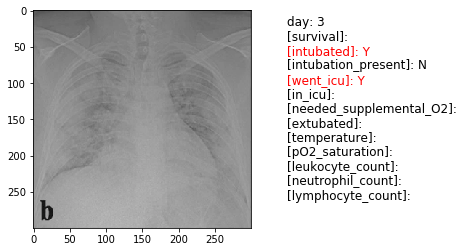

[Clincal Notes]: Chest X-rays of a 27-year-old male patient with COVID-19 (a?d). The first radiograph at admission demonstrated a mild interstitial thickening in the lower lobes (a). Within 72 h from hospital admission, his clinical conditions worsened and bilateral pulmonary consolidations became visible at chest X-ray (b). The same day he was intubated with a prompt improvement of the radiological findings especially in the left lung (c). In the next 24 h after the beginning of the mechanical ventilation, the bilateral pulmonary consolidations increased (d)


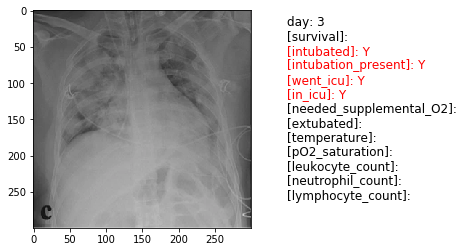

[Clincal Notes]: Chest X-rays of a 27-year-old male patient with COVID-19 (a?d). The first radiograph at admission demonstrated a mild interstitial thickening in the lower lobes (a). Within 72 h from hospital admission, his clinical conditions worsened and bilateral pulmonary consolidations became visible at chest X-ray (b). The same day he was intubated with a prompt improvement of the radiological findings especially in the left lung (c). In the next 24 h after the beginning of the mechanical ventilation, the bilateral pulmonary consolidations increased (d)


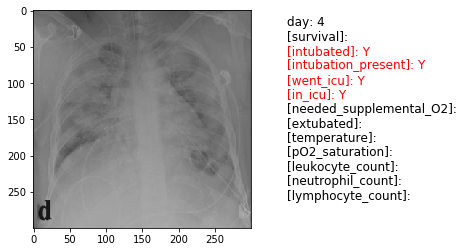

[Clincal Notes]: Chest X-rays of a 27-year-old male patient with COVID-19 (a?d). The first radiograph at admission demonstrated a mild interstitial thickening in the lower lobes (a). Within 72 h from hospital admission, his clinical conditions worsened and bilateral pulmonary consolidations became visible at chest X-ray (b). The same day he was intubated with a prompt improvement of the radiological findings especially in the left lung (c). In the next 24 h after the beginning of the mechanical ventilation, the bilateral pulmonary consolidations increased (d)





Patient 301	[Gender]: M	[Age]: 62
[Patient Location]: Chicago, USA


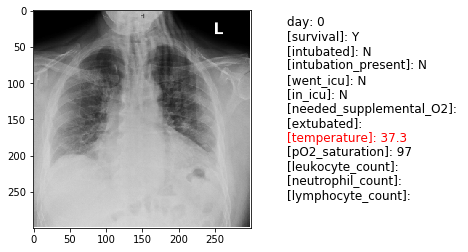

[Clincal Notes]: 28M previously fit and well, not on any regular medications, presented with a 6 day Hx of fever, non-productive cough and SOB for the last 4 days. His symptoms started as sore throat and coryzal symptoms 8 days prior to his presentation and he reported contact with a friend with similar symptomatology.  O/E T39.1 HR87 BP119/63 RR38 SpO2 90% on RA. Bilateral nasal crepitations without a wheeze.  Image 1 - CXR on admission Image 2 - haematology, biochemistry on admission and serial gases Image 3 - CXR post intubation in the critical care setting Image 4 - the reason for this unfortunate young man requiring critical care. On arrival to the ED, vital signs were temperature 37.3 ?C, heart rate 96 beats per minute, blood pressure 137/70, 20 respirations per minute, and oxygen saturation 97% on room air. Lung examination was notable for non-labored respirations with clear breath sounds bilaterally. The reminder of his physical examination was unremarkable. The ED treatment te

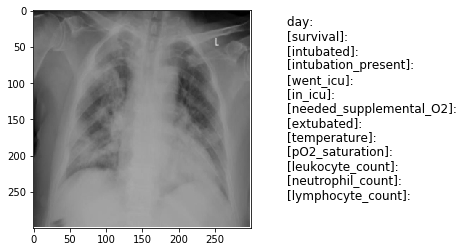

[Clincal Notes]: A 35-year-old female patient presented to our clinic with otalgia and tinnitus. She has not any published COVID-19 symptoms. The patient has not any comorbid diseases. There was hyperemia and bulging tympanic membrane in her otorhinolaryngologic examination (Fig. 1). But there was mild rhonchi at lower part of thorax. The patient underwent audiometry and tympanometry tests. In terms of roncus detected in the examination, further examinations (chest X-ray, real-time reverse transcriptase?polymerase chain reaction (RT-PCR)) were requested due to the pandemic status of world.





Patient 303	[Gender]: M	[Age]: 74
[Patient Location]: Nagoya, Japan


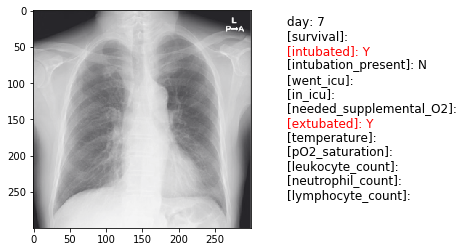

[Clincal Notes]: The patient was a 74-year-old man with a body weight of 65 kg and had no overseas travel history and no contact with COVID-19 patients. He was a hepatitis B carrier and had hypertension, bronchial asthma, and was not under a medical treatment. He experienced slight fever on Day 1 and was admitted to a nearby hospital on Day 4 with prolonged high fever (> 39 ?C) and shortness of breath. The Hemoglobin A1c (HbA1c) test revealed poorly controlled diabetes with a value of 9.4%. The PCR test for SARS-CoV-2 was positive, and he was diagnosed with COVID-19 on Day 7. He received intensive drug treatment, including ciclesonide, lopinavir/ritonavir and systemic corticosteroids, as well as respiratory care. Despite these treatments, his respiratory condition deteriorated, and he underwent tracheal intubation (23 cm deep from the mouth) for mechanical ventilation on Day 11. After his transfer to our hospital on Day 12, favipiravir was added to the drug regimen to improve the gener

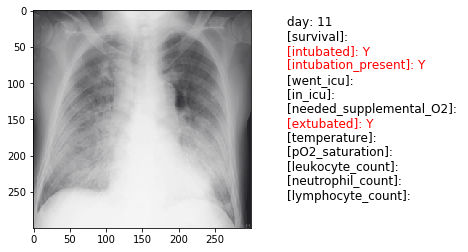

[Clincal Notes]: The patient was a 74-year-old man with a body weight of 65 kg and had no overseas travel history and no contact with COVID-19 patients. He was a hepatitis B carrier and had hypertension, bronchial asthma, and was not under a medical treatment. He experienced slight fever on Day 1 and was admitted to a nearby hospital on Day 4 with prolonged high fever (> 39 ?C) and shortness of breath. The Hemoglobin A1c (HbA1c) test revealed poorly controlled diabetes with a value of 9.4%. The PCR test for SARS-CoV-2 was positive, and he was diagnosed with COVID-19 on Day 7. He received intensive drug treatment, including ciclesonide, lopinavir/ritonavir and systemic corticosteroids, as well as respiratory care. Despite these treatments, his respiratory condition deteriorated, and he underwent tracheal intubation (23 cm deep from the mouth) for mechanical ventilation on Day 11. After his transfer to our hospital on Day 12, favipiravir was added to the drug regimen to improve the gener

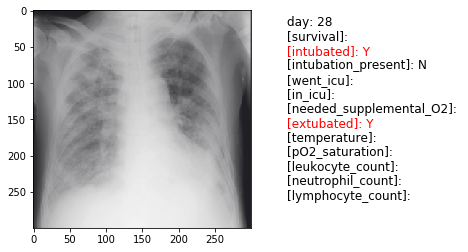

[Clincal Notes]: The patient was a 74-year-old man with a body weight of 65 kg and had no overseas travel history and no contact with COVID-19 patients. He was a hepatitis B carrier and had hypertension, bronchial asthma, and was not under a medical treatment. He experienced slight fever on Day 1 and was admitted to a nearby hospital on Day 4 with prolonged high fever (> 39 ?C) and shortness of breath. The Hemoglobin A1c (HbA1c) test revealed poorly controlled diabetes with a value of 9.4%. The PCR test for SARS-CoV-2 was positive, and he was diagnosed with COVID-19 on Day 7. He received intensive drug treatment, including ciclesonide, lopinavir/ritonavir and systemic corticosteroids, as well as respiratory care. Despite these treatments, his respiratory condition deteriorated, and he underwent tracheal intubation (23 cm deep from the mouth) for mechanical ventilation on Day 11. After his transfer to our hospital on Day 12, favipiravir was added to the drug regimen to improve the gener

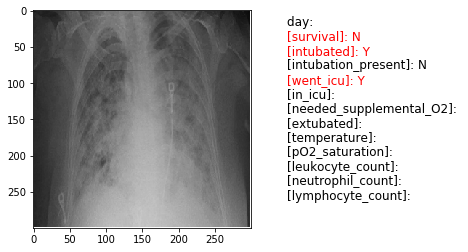

[Clincal Notes]: 80 year-old-female with a history of hypertension was brought to the ED for a chief complaint of altered mental status and left-sided weakness. The family denied history of fever or cough, but reported that the patient has been falling frequently in the past week. The patient was intubated for airway protection and a code stroke was activated. Vital signs in the ED were significant for Temp of 100.2� F (37.9� C), HR 101, BP 130/77, Examination was significant for left hemiplegia and aphasia. NIHSS was calculated to be 36. CT head revealed an acute right MCA stroke (Fig. 3a). CTA of the head and neck demonstrated occlusion of the right internal carotid artery at origin and incidental bilateral patchy apical lung opacities (Fig. 3b). CT perfusion demonstrated a 305 cc core infarct in the right MCA distribution and a surrounding 109 cc ischemic penumbra (Fig. 3c). The patient was deemed not a suitable candidate for any acute neuro-intervention due to the large core infarc

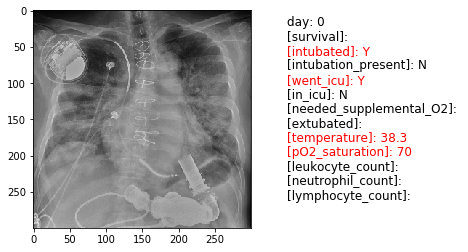

[Clincal Notes]: 


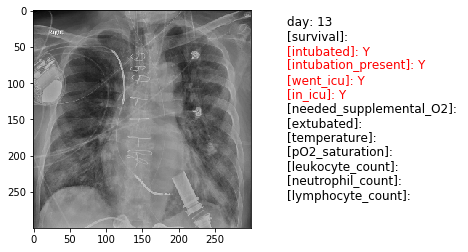

[Clincal Notes]: 





Patient 306	[Gender]: M	[Age]: 40
[Patient Location]: New Brunswick, New Jersey, USA


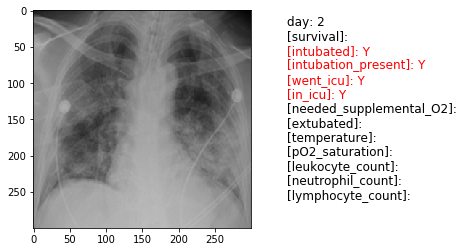

[Clincal Notes]: There is evidence of bilateral interstitialopacifications consistent with ARDS





Patient 307	[Gender]: M	[Age]: 66
[Patient Location]: Singapore


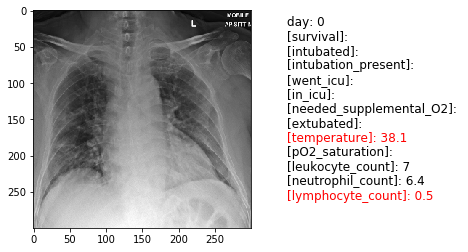

[Clincal Notes]: Our index case?Case 1 (66-year old man from Wuhan, China) ?presented on January 22, 2020 with a 2-day history of fever (38.1?C) and cough (Figure 1A). Chest radiograph showed bilateral, patchy, ill-defined lung infiltrates (Figure 1B). Throat swab was positive for SARS-CoV-2 by RT-PCR (Corman et al., 2020). He progressively became more dependent on supplemental oxygen (Figure 1A), with worsening lung infiltrates on chest radiograph. His respiratory function reached a nadir on day 5 post illness onset, as evidenced by the oxygen saturation (Figure 1C) and tachycardia (Figure 1D) despite 4L of supplemental oxygen. He was initiated on oral lopinavir-ritonavir on the same day. After the first two positive SARS-CoV-2 RT-PCR findings, subsequent throat swabs from Case 1 were only positive intermittently until day 18 of illness (Figure 1A).





Patient 308	[Gender]: M	[Age]: 37
[Patient Location]: Singapore


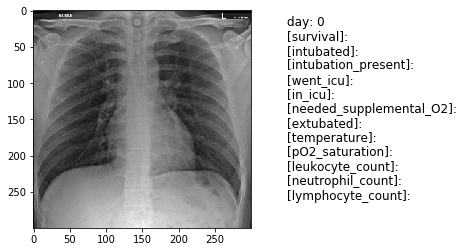

[Clincal Notes]: Case 2 (37 years old) was the son of Case 1. On January 23, he reported mild sore throat and cough that started 3 days earlier, even before onset of symptoms in the index case (Figure 1A). He also reported a one-day history of diarrhea on January 18. He was never febrile throughout this period. Chest radiographs were normal (Figure 1B). Nonetheless, throat swabs were consistently RT-PCR positive for SARS-CoV-2 in Case 2 until day 29 from illness onset (Figure 1A).





Patient 309	[Gender]: M	[Age]: 38
[Patient Location]: Singapore


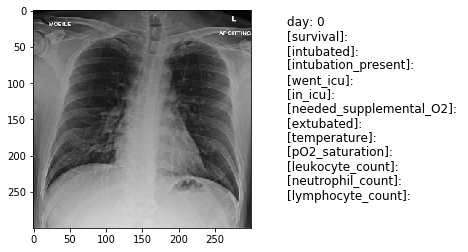

[Clincal Notes]: Case 3 was a 38-year-old businessman from Wuhan, China. He arrived in Singapore on January 22 and became unwell with fever, non-productive cough, lethargy, and myalgia a day later. He presented to the hospital on January 29 for persistent fever and was diagnosed with RT-PCR-confirmed COVID-19. He did not develop lower respiratory tract complications, but throat swabs were consistently RT-PCR positive for SARS-CoV-2 until 23 days post illness onset (Figure 1A). Chest radiograph was normal (Figure 1B).





Patient 310	[Gender]: M	[Age]: 71
[Patient Location]: Milan, Italy


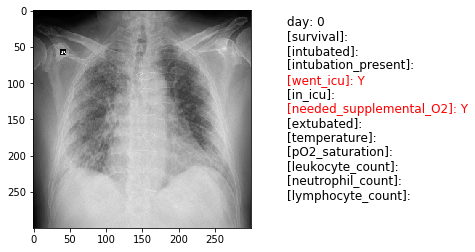

[Clincal Notes]: Patient #1 is a 71-year-old Caucasian male, who was admitted in the hospital for critical limb ischemia of the right leg requiring surgery. He had a meaningful past medical history, due to history of atrial fibrillation (resolved at the time of hospitalization), hypercholesterolemia and hypertension, associated with multiple arterial complications and mild kidney failure. Indeed, the patient had coronary artery disease requiring 5 stents, and then the recent peripheral arterial disease treated with embolectomy by Fogarty catheter. During the hospitalization, on April 6th the patient was diagnosed with bilateral interstitial pneumonia (see chest X-ray, Fig. 1 ), that was eventually demonstrated to have been caused by SARS-CoV-2 infection. Because of severe hypoxia irrespective of oxygen support through standard Ventimask, the patient had to start non-invasive mechanical ventilation (NIV) with Continuous Positive Air-Pressure (C-PAP) with 60% of Fraction of Inspired Oxyg

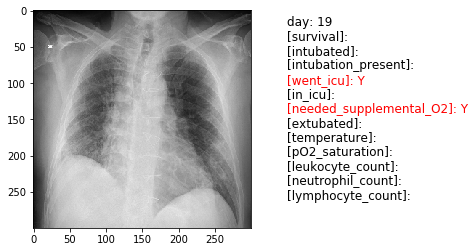

[Clincal Notes]: Patient #1 is a 71-year-old Caucasian male, who was admitted in the hospital for critical limb ischemia of the right leg requiring surgery. He had a meaningful past medical history, due to history of atrial fibrillation (resolved at the time of hospitalization), hypercholesterolemia and hypertension, associated with multiple arterial complications and mild kidney failure. Indeed, the patient had coronary artery disease requiring 5 stents, and then the recent peripheral arterial disease treated with embolectomy by Fogarty catheter. During the hospitalization, on April 6th the patient was diagnosed with bilateral interstitial pneumonia (see chest X-ray, Fig. 1 ), that was eventually demonstrated to have been caused by SARS-CoV-2 infection. Because of severe hypoxia irrespective of oxygen support through standard Ventimask, the patient had to start non-invasive mechanical ventilation (NIV) with Continuous Positive Air-Pressure (C-PAP) with 60% of Fraction of Inspired Oxyg

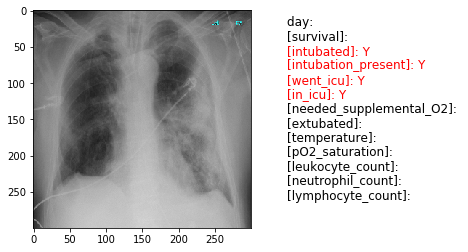

[Clincal Notes]: A 68-year-old intubated man with fever and cough. ClassicCOVID-19 appearances on CXR. This patient had a positive RT-PCR forCOVID-19 on the second throat swab after an initial negative throatswab.





Patient 311b	[Gender]: F	[Age]: 39
[Patient Location]: United Kingdom


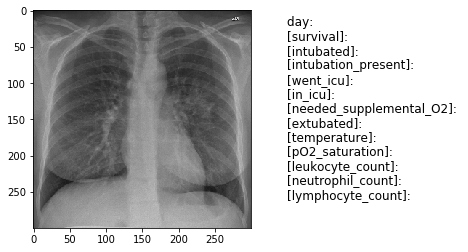

[Clincal Notes]: A 39-year-old woman with fever and ill-defined left peri-hilar opacity. The RT-PCR throat swab was COVID-19 positive.





Patient 312	[Gender]: F	[Age]: 59
[Patient Location]: Essen, Germany


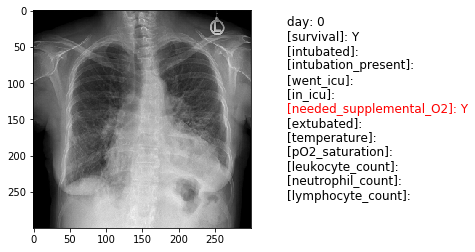

[Clincal Notes]: We report on a 59-year-old woman 13 months after bilateral lung transplantation who presented with SARS-CoV-2 infection. She underwent bilateral lung transplantation because of chronic thromboembolic pulmonary hypertension in February 2019. Alemtuzumab was administered as induction therapy, and a dual immunosuppressive regimen consisting of tacrolimus and prednisolone was used as maintenance therapy. Following a complicated post-transplant course, she was discharged 3 months post-operatively. The highest forced expiratory volume at 1 second value was reached in December 2019 with 1.60 liters (72% predicted). On the day of hospitalization (Day 0), she presented to the outpatient clinic for a routine follow-up visit with no apparent symptoms. Lung function testing showed a drop in forced expiratory volume at 1 second to 1.28 liters (57% predicted). Upon questioning, she expressed mild exercise dyspnea and a dry cough but no fever or diarrhea. The patient had no concernin

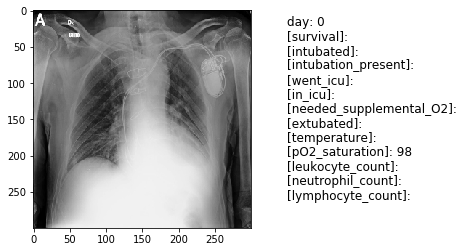

[Clincal Notes]: A 71-year-old man with hypertension and coronary artery disease, status post permanent pacemaker (PPM) implantation 3 years before, presented to the Emergency Department (ED) with a presyncopal episode while sitting. He reported lightheadedness, profuse sweating, and blurred vision. In the ED his blood pressure was 115/75 mm Hg, heart rate 75 beats per minute, and oxygen saturation 98% on room air. His device was interrogated and showed normal functioning, regular parameters, and no arrhythmias. In order to be admitted on a regular medicine floor he was tested for COVID-19 infection. His nasopharyngeal swab result was positive. His chest radiograph was unremarkable (Figure 1A).


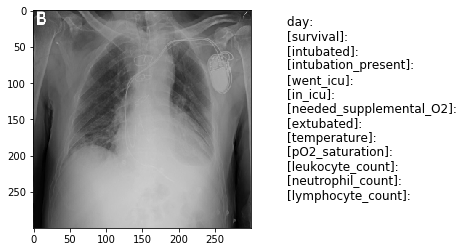

[Clincal Notes]: A 71-year-old man with hypertension and coronary artery disease, status post permanent pacemaker (PPM) implantation 3 years before, presented to the Emergency Department (ED) with a presyncopal episode while sitting. He reported lightheadedness, profuse sweating, and blurred vision. In the ED his blood pressure was 115/75 mm Hg, heart rate 75 beats per minute, and oxygen saturation 98% on room air. His device was interrogated and showed normal functioning, regular parameters, and no arrhythmias. In order to be admitted on a regular medicine floor he was tested for COVID-19 infection. He was placed on isolation precautions and after 4 days he developed a fever; subsequently, right lobe pneumonia was diagnosed on chest radiograph (Figure 1B).





Patient 313b	[Gender]: M	[Age]: 75
[Patient Location]: Turin, Italy


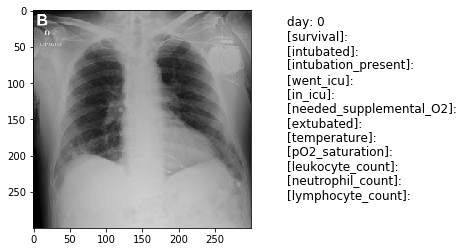

[Clincal Notes]: Two days later, he presented again to the ED because of a syncope preceded by a similar vagal reaction. The ICD worked properly, and no arrhythmias were found. Chest radiograph showed an area of lung dysventilation in the right lower lobe (Figure 3B). CT scan of the chest confirmed bilateral pneumonia, with multiple ground-glass opacities with subpleural distribution (Figure 3C). He was tested again for COVID-19 infection and the result was positive.





Patient 314	[Gender]: M	[Age]: 21
[Patient Location]: Florida, USA


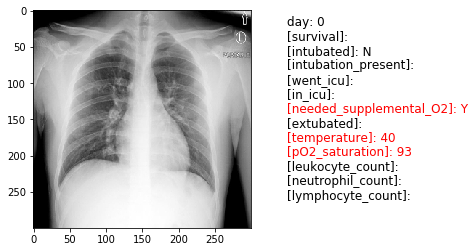

[Clincal Notes]: 21 year old male, with known substance abuse (cocaine, methamphetamines) and current smoker of 1 pack a day for the last 3 years, with no reported past medical history, presented to the Emergency department of a South Florida Hospital in the USA, with complaints of fever, dry cough, exertional dyspnea, generalized myalgia, fatigue and diarrhea of 3 days duration. At initiation of symptoms he was prescribed Tamiflu at the Urgent care center but his symptomatology worsened. Denied abdominal pain, nausea, vomiting, chills, and chest pain. The patient had no identifiable exposure to sick contacts nor recent travel outside the USA. The physical exam was significant for Temperature of 40C, Heart Rate 122 Respiratory rate 18 Blood pressure of 128/75 O2Sat:93% at room air, mild expiratory wheezing in bilateral lung fields. O2 via nasal cannula was started, a Respiratory Pathogen (RP) panel (GenMark Diagnostics, Carlsbad, CA) and a SARS-CoV-2 test (CDC 2019-Novel Coronavirus Re

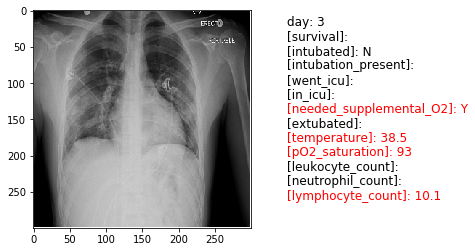

[Clincal Notes]: Patient presented to the emergency department 3 days later due to worsening dry cough, dyspnea at rest, fever associated with chills. Previous SARS-CoV-2 test was negative. The physical exam was significant for Temperature of 38.5C, Heart Rate 117 Respiratory rate 20 Blood pressure of 121/68 O2Sat:93% at room air, expiratory wheezing and crackles in bilateral lung fields. Supplemental O2 via nasal cannula started, SARS-CoV-2 testing reordered, along with chest X-ray, blood cultures, CBC, patient was placed in respiratory isolation in a single negative pressure ward of the medical intermediate care unit. The patient was started on Normal Saline IV 2 L, Ceftriaxone 2 g IV QD, Azithromycin 500 mg IV QD empirically, albuterol nebulizer and Acetaminophen 1000 mg PO. Chest X-ray (Fig. 2) showing bilateral pulmonary opacities, WBC 12.6 1000/uL (reference range 3.5 - 10.0 1000/uL), Neutrophils 85.3 %(reference range 40.3 - 74.8 %), Lymphocytes 10.1% (reference range 12.2 - 47.

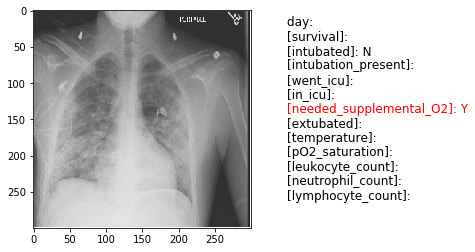

[Clincal Notes]: Patient continued with supplemental oxygen on Venturi Mask at a FIO 50% with a stable O2 sat, follow up chest x-ray (Fig. 5) showed worsening bilateral infiltrates but clinically, the patient continued to improve.





Patient 315	[Gender]: F	[Age]: 78
[Patient Location]: Tokyo, Japan


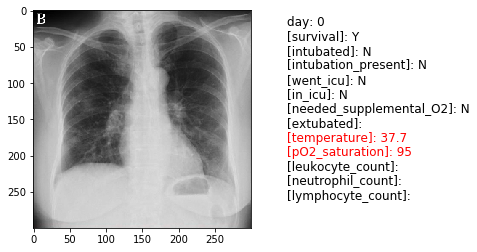

[Clincal Notes]: A 78-year-old woman, a non-smoker with dyslipidemia and hypothyroidism presented to her primary care physician on 13 February with general malaise and anorexia lasting several days. She did not have other symptoms, such as fever, cough, sputum, or dyspnoea. She had visited Paris, France, from 30 January to 4 February 2020. At that time, her vital signs were within normal limits, including SpO2 (i.e., 98 % on room air) (Fig. 1A). On 18 February, she complained of cough and exacerbation of malaise and anorexia and had an associated 3 kg body weight loss. She was referred to our hospital because of a bilateral reticular shadow seen on chest X-rays (Fig. 1B) and ground-glass opacity (GGO) adjacent to the pleura seen on chest computed tomography (CT) (Fig. 1C, D). At the time of her visit, she had a temperature of 37.7 ?C; respiratory rate, 20 breaths/min; heart rate, 106 beats/min (regular); blood pressure, 139/63 mmHg; and SPO2 of 95 % on room air. Admission blood tests s

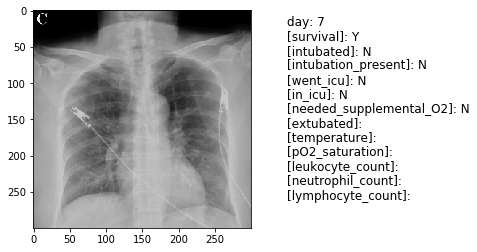

[Clincal Notes]: A 78-year-old woman, a non-smoker with dyslipidemia and hypothyroidism presented to her primary care physician on 13 February with general malaise and anorexia lasting several days. She did not have other symptoms, such as fever, cough, sputum, or dyspnoea. She had visited Paris, France, from 30 January to 4 February 2020. At that time, her vital signs were within normal limits, including SpO2 (i.e., 98 % on room air) (Fig. 1A). On 18 February, she complained of cough and exacerbation of malaise and anorexia and had an associated 3 kg body weight loss. She was referred to our hospital because of a bilateral reticular shadow seen on chest X-rays (Fig. 1B) and ground-glass opacity (GGO) adjacent to the pleura seen on chest computed tomography (CT) (Fig. 1C, D). At the time of her visit, she had a temperature of 37.7 ?C; respiratory rate, 20 breaths/min; heart rate, 106 beats/min (regular); blood pressure, 139/63 mmHg; and SPO2 of 95 % on room air. Admission blood tests s

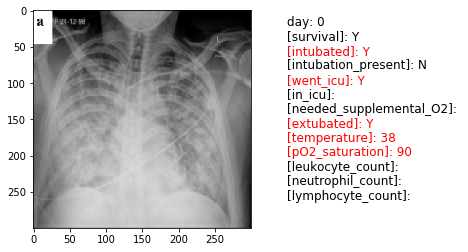

[Clincal Notes]: A 54-year old man presented to the emergency department of Erfan Niyayesh Hospital, Tehran, Iran, with complains of high-grade fever, cough, and dyspnea for five days. At admission time, he had fever up to 38 ?C. Peripheral oxygen saturation was 90% with a face mask. No abnormality was seen in laboratory results except positive C-reactive protein, lymphopenia with 570 cells/?L, and severe respiratory acidosis. The chest X-ray imaging revealed bilateral infiltration in both upper and lower lobs (Fig. 1a). The patient had no underlying diseases and history of medicine usage. Reverse transcription-polymerase chain reaction (RT-PCR) sample for COVID-19 was reported positive and according to RT-PCR test and clinical symptoms, the diagnosis of COVID-19 was made for the patient. The therapeutic regimen included Hydroxychloroquine at a dose of 200 mg P.O. BID and lopinavir/ritonavir at a dose of 200/50 mg P.O. BID initiated for the patient. After four days, the clinical condit

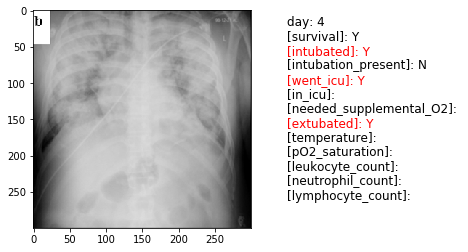

[Clincal Notes]: A 54-year old man presented to the emergency department of Erfan Niyayesh Hospital, Tehran, Iran, with complains of high-grade fever, cough, and dyspnea for five days. At admission time, he had fever up to 38 ?C. Peripheral oxygen saturation was 90% with a face mask. No abnormality was seen in laboratory results except positive C-reactive protein, lymphopenia with 570 cells/?L, and severe respiratory acidosis. The chest X-ray imaging revealed bilateral infiltration in both upper and lower lobs (Fig. 1a). The patient had no underlying diseases and history of medicine usage. Reverse transcription-polymerase chain reaction (RT-PCR) sample for COVID-19 was reported positive and according to RT-PCR test and clinical symptoms, the diagnosis of COVID-19 was made for the patient. The therapeutic regimen included Hydroxychloroquine at a dose of 200 mg P.O. BID and lopinavir/ritonavir at a dose of 200/50 mg P.O. BID initiated for the patient. After four days, the clinical condit

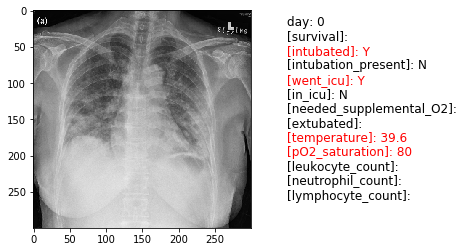

[Clincal Notes]: The index patient, a 64-year-old woman, attended the Department of Accident and Emergency at 23:42 h on 1st February 2020 with fever, productive cough and breathlessness for 2 days. She developed flu-like symptoms on 24th January 2020 with transient improvement after taking antibiotics and symptomatic treatment prescribed by a general practitioner. However, her fever relapsed on 30th January 2020 with productive cough and dyspnea. She had no history of travel in the preceding month, but she owned a fashion boutique with many mainland Chinese customers owing to its proximity to the West Kowloon high-speed rail station. On admission, she had a fever of 39.6�C with sinus tachycardia of 126 bpm and blood pressure of 198/92 mmHg. She was tachypnoeic with oxygen saturation of 80% in room air. Bilateral crepitations were heard on auscultation and chest X-ray revealed multi-lobar pulmonary infiltrates (Figure 2 (a)). In the absence of history of travel to China or contact with

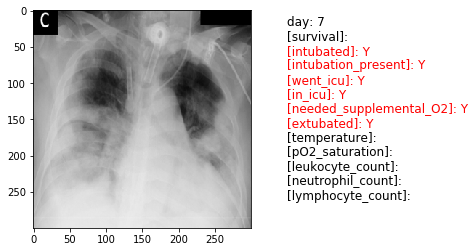

[Clincal Notes]: Initial and serial laboratory results are shown in Table 1. A computed tomography (CT) scan of the chest showed diffuse infiltrate and ground-glass opacities bilaterally with no pleural effusion (Fig. 2). Transthoracic echocardiography revealed a normal left ventricular ejection fraction, size, and no abnormality of its valve. A rapid influenza test with a nasal swab taken on the day of admission was negative, and the gram-stain of his sputum specimen was insignificant. Both pneumococcal and legionella urinary antigen tests were negative, as was a loop-mediated isothermal amplification test for Mycoplasma pneumoniae (C) Hospital day 7 (ECMO day 6)


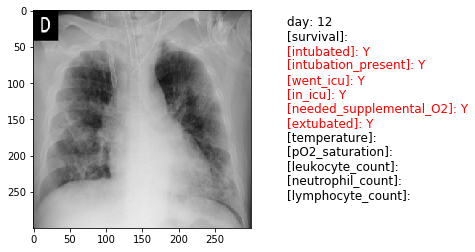

[Clincal Notes]: Initial and serial laboratory results are shown in Table 1. A computed tomography (CT) scan of the chest showed diffuse infiltrate and ground-glass opacities bilaterally with no pleural effusion (Fig. 2). Transthoracic echocardiography revealed a normal left ventricular ejection fraction, size, and no abnormality of its valve. A rapid influenza test with a nasal swab taken on the day of admission was negative, and the gram-stain of his sputum specimen was insignificant. Both pneumococcal and legionella urinary antigen tests were negative, as was a loop-mediated isothermal amplification test for Mycoplasma pneumoniae (D) Hospital day 12 (ECMO day 11)


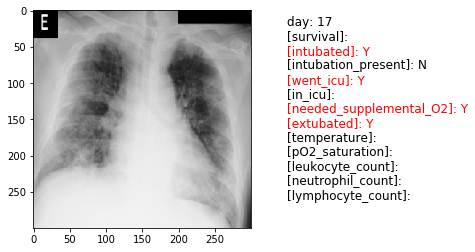

[Clincal Notes]: Initial and serial laboratory results are shown in Table 1. A computed tomography (CT) scan of the chest showed diffuse infiltrate and ground-glass opacities bilaterally with no pleural effusion (Fig. 2). Transthoracic echocardiography revealed a normal left ventricular ejection fraction, size, and no abnormality of its valve. A rapid influenza test with a nasal swab taken on the day of admission was negative, and the gram-stain of his sputum specimen was insignificant. Both pneumococcal and legionella urinary antigen tests were negative, as was a loop-mediated isothermal amplification test for Mycoplasma pneumoniae (E) Hospital day 17





Patient 319a	[Gender]: F	[Age]: 74
[Patient Location]: Taichung, Taiwan


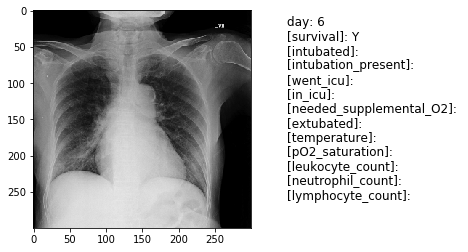

[Clincal Notes]: A 74 year-old female visitor from Wuhan City, China presented to the hospital with fever, malaise, and poor appetite. She reported no underlying medical conditions. There was no chillness, cough, rhinorrhea, sore throat, myalgia, chest discomfort, dyspnea, abdominal pain, or diarrhea. Physical examination disclosed body temperature of 38.1 �C, blood pressure of 129/68 mm Hg, heart rate of 79 beats per minute, respiratory rate of 18 breaths per minute. Chest radiography (CXR) revealed mild increased infiltration over bilateral lower lung field. Peripheral-blood white-cell count was 3770 per cubic millimeter (with 62.3% neutrophils and 32.1% lymphocytes). Nasopharyngeal swab was positive for severe acute respiratory syndrome coronavirus-2 (SARS-CoV-2) by real-time reverse-transcriptase polymerase chain reaction (rRT-PCR) assay performed by the Centers for Diseases Control in Taiwan (Taiwan CDC). On day 6 in hospital, the patient remained febrile, malaise and poor appetit

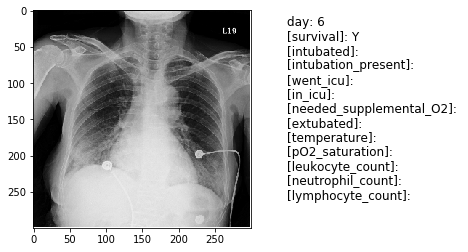

[Clincal Notes]: A 73 year-old previously health female visitor returning from Wuhan City 3 days ago presented to the hospital with dry cough, fever, malaise and poor appetite. She denied chillness, rhinorrhea, sore throat, chest discomfort, myalgia, dyspnea, abdominal pain, or diarrhea. Her body temperature was 38.7 �C with blood pressure of 117/47 mm Hg, heart rate of 82 beats per minute, respiratory rate of 18 breaths per minute. CXR demonstrated non-specific mild increased infiltration over bilateral lower lung field. Peripheral-blood white-cell count was 3420 per cubic millimeter (with 69.3% neutrophils and 26.9% lymphocytes). Nasopharyngeal swab was positive for SARS-CoV-2 by rRT-PCR assay reported from Taiwan CDC. On day 6 in hospital, the patient remained febrile, malaise and poor appetite. She reported worsening of cough. Follow-up CXR revealed patchy consolidation over bilateral lower lung field (Fig. 1B). Parenteral cefepime and oral clarithromycin therapy were initiated. On

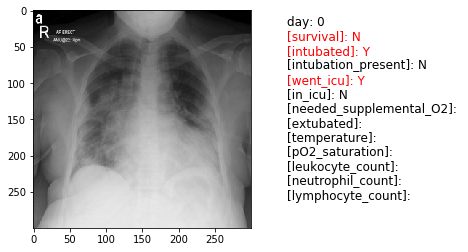

[Clincal Notes]: A 67-year-old woman with insulin-dependent type 2 diabetes and end-stage kidney disease on hemodialysis therapy for 4 years received a deceased donor kidney transplant in March 2019. Her eGFR was 45 to 55 ml/min per 1.73 m2. She was maintained on tacrolimus with levels between 5 and 8 ng/ml, mycophenolate mofetil (MMF) 250 mg twice a day (BD), and prednisolone 5 mg OD. Her other medications included ramipril, aspirin, alfacalcidol, and amiloride. She presented on March 5 with cough, fever, and shortness of breath. Chest X-ray revealed bilateral patchy consolidation (Figure 1a). SARS-CoV-2 RNA polymerase chain reaction tests from nose and throat viral swabs were positive. Bronchial washing for pneumocystis polymerase chain reaction was negative, as was blood polymerase chain reaction for cytomegalovirus DNA. There was no other positive microbiological diagnosis. She was hypoxic with peripheral oxygen saturation of 86% and a respiratory rate of 26 breaths/min, so she was

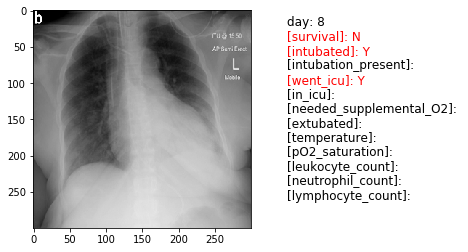

[Clincal Notes]: A 67-year-old woman with insulin-dependent type 2 diabetes and end-stage kidney disease on hemodialysis therapy for 4 years received a deceased donor kidney transplant in March 2019. Her eGFR was 45 to 55 ml/min per 1.73 m2. She was maintained on tacrolimus with levels between 5 and 8 ng/ml, mycophenolate mofetil (MMF) 250 mg twice a day (BD), and prednisolone 5 mg OD. Her other medications included ramipril, aspirin, alfacalcidol, and amiloride. She presented on March 5 with cough, fever, and shortness of breath. Chest X-ray revealed bilateral patchy consolidation (Figure 1a). SARS-CoV-2 RNA polymerase chain reaction tests from nose and throat viral swabs were positive. Bronchial washing for pneumocystis polymerase chain reaction was negative, as was blood polymerase chain reaction for cytomegalovirus DNA. There was no other positive microbiological diagnosis. She was hypoxic with peripheral oxygen saturation of 86% and a respiratory rate of 26 breaths/min, so she was

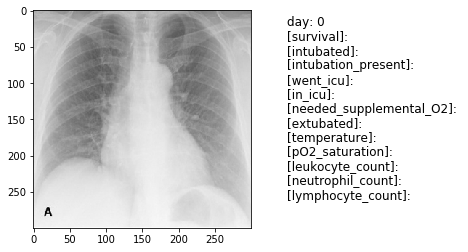

[Clincal Notes]: (A) CXR image of a 75-year-old patient who came to the emergency department and presented with 1-day history of COVID-19 infection-compatible symptoms without initial radiographic abnormalities and with a positive PCR result for SARS-CoV-2.


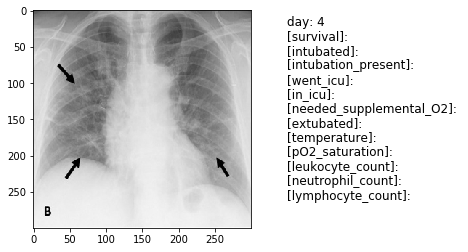

[Clincal Notes]: (B) CXR image, 4 days later, in which bilateral GGO are identified.





Patient 322	[Gender]: 	[Age]: 75
[Patient Location]: Teruel, Spain


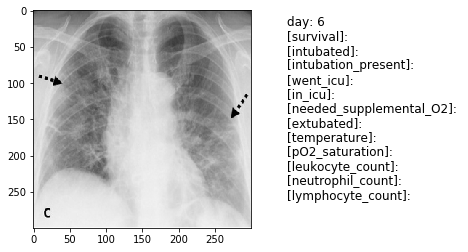

[Clincal Notes]: (C) CXR image, 2 days later, in which a reticular pattern is observed due to septal thickening with persistence of GGO.





Patient 323	[Gender]: M	[Age]: 72
[Patient Location]: Modena, Italy


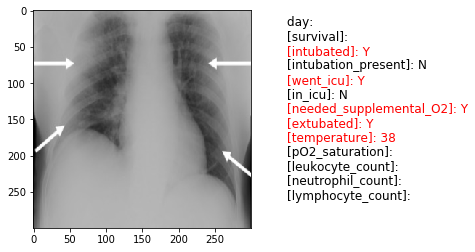

[Clincal Notes]: Chest X-ray on admission shows diffuse interstitial abnormalities alongside scattered bilateral infiltrates. Arrows indicate the local ultrasound patterns, in particular: irregular vertical artifacts (B-lines) with impaired pleural sliding next to subpleural small consolidations in the upper anterior sites and thick and confluent B lines in the low posterior site.





Patient 324a	[Gender]: F	[Age]: 69
[Patient Location]: United Kingdom 


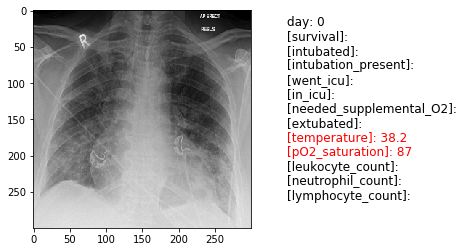

[Clincal Notes]: A 69-year-old female presented to the emergency department with a three-day history of fever (temperature 38.2 C) and shortness of breath (oxygen saturation 87%), normal white cell count (6400 ?/L) but lymphopenia (890 ?/L) and an elevated CRP (149, normal <5). Mobile chest radiograph (Fig. 1 ) demonstrates classical findings associated with COVID-19 of bilateral, predominantly peripheral lower zone ground glass and interstitial opacification. Nasopharyngeal swab RT-PCR was positive for SARS-CoV-2. Index chest radiograph of a 69 year old female with bilateral, peripheral ground glass and interstitial opacification (Classic/Probable COVID-19).





Patient 324b	[Gender]: F	[Age]: 93
[Patient Location]: United Kingdom 


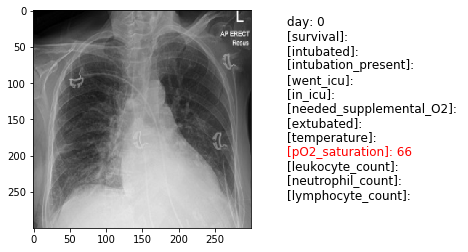

[Clincal Notes]: A 93-year-old female presented to the emergency department with a 10-day history of shortness of breath (oxygen saturation 66%), elevated CRP (71), normal white cell count (9500 ?/L) and lymphopenia (930 ?/L). Index (Day 0, Fig. 2 a) chest radiograph appearances were indeterminate with bilateral mid and lower zone interstitial opacification. a. Index chest radiograph (Day 0) with unilateral lower zone interstitial opacification (Indeterminate COVID-19).


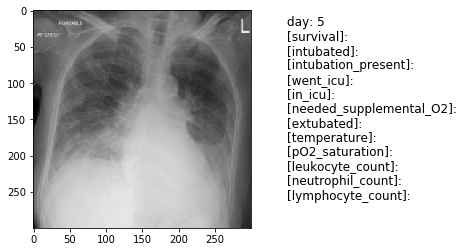

[Clincal Notes]: A 93-year-old female presented to the emergency department with a 10-day history of shortness of breath (oxygen saturation 66%), elevated CRP (71), normal white cell count (9500 ?/L) and lymphopenia (930 ?/L). Rapid progression occurred across seven days, with bilateral ground glass opacification (Fig. 2b) and development of acute respiratory distress syndrome (Fig. 2c). Nasopharyngeal swab RT-PCR was positive for SARS-CoV-2. b. Repeat chest radiograph day 5 with bilateral ground glass opacification in the lower zones (Classic/Probable COVID-19).


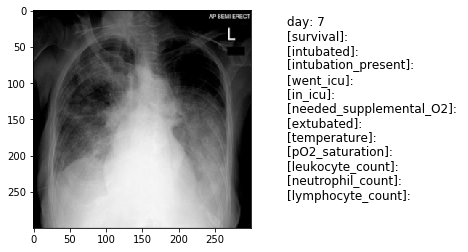

[Clincal Notes]: A 93-year-old female presented to the emergency department with a 10-day history of shortness of breath (oxygen saturation 66%), elevated CRP (71), normal white cell count (9500 ?/L) and lymphopenia (930 ?/L). Rapid progression occurred across seven days, with bilateral ground glass opacification (Fig. 2b) and development of acute respiratory distress syndrome (Fig. 2c). Nasopharyngeal swab RT-PCR was positive for SARS-CoV-2. c. Repeat chest radiograph day 7 with diffuse bilateral ground glass opacification (Classic/Probable COVID).





Patient 325	[Gender]: F	[Age]: 78
[Patient Location]: Rome, Italy


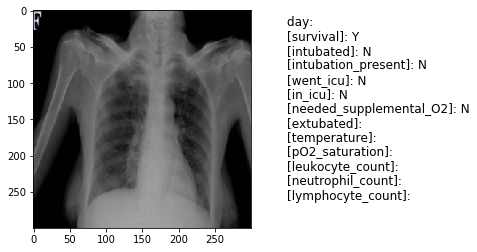

[Clincal Notes]: On 12th March 2020 a 78-year-old woman was admitted to our Emergency Department for ongoing myoclonic jerks of the right face and right limbs. She suffered from hypertension and postencephalitic epilepsy. When she was 76, the patient developed a Herpes Simplex Virus-1 (HSV-1) encephalitis. The initial presentation of the herpetic encephalitis were repetitive oral buccal automatisms and aphasia lasting 6 h associated with the electroencephalographic findings of subcontinuous epileptiform discharges over the left temporal fields, configuring a non-convulsive status epilepticus (NCSE). The status epilepticus was successfully treated with a sequence of antiepileptic drugs. Because of the encephalitis, fluent aphasia and mild right limbs weakness persisted, with only a partial recovery after neuro-rehabilitation. Since then, the patient was steadily under treatment with valproic acid and levetiracetam and remained seizure-free for more than two years. She was under regular 

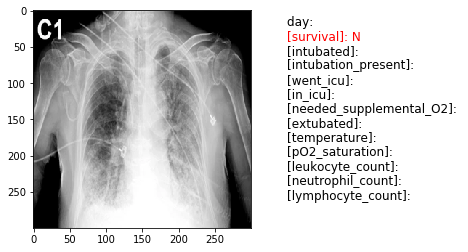

[Clincal Notes]: In Case 3, X-ray showed patchy high-density shadows in both lungs, which were more prominent in the lower lobes (C1) and worsened during the couple of days before death (C2). Case 3 exhibited focal interstitial thickening (Fig. 3c)


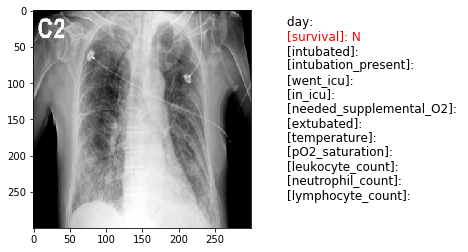

[Clincal Notes]: In Case 3, X-ray showed patchy high-density shadows in both lungs, which were more prominent in the lower lobes (C1) and worsened during the couple of days before death (C2). Case 3 exhibited focal interstitial thickening (Fig. 3c)





Patient 326b	[Gender]: M	[Age]: 94
[Patient Location]: Nottingham, United Kingdom 


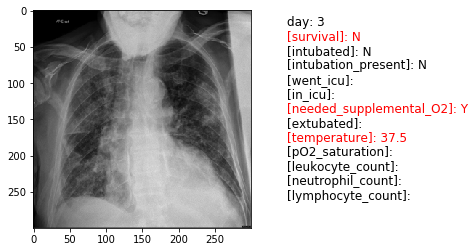

[Clincal Notes]: Past medical history: Diabetes, hypertension. CXR showing right upper and lower zone airspace opacification and small bilateral effusion.





Patient 329	[Gender]: M	[Age]: 34
[Patient Location]: Centro Médico Imbanaco, Cali, Valle del Cauca, Colombia


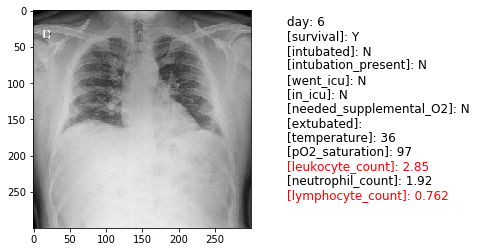

[Clincal Notes]: Chest radiograph obtained on admission shows peripheral ground-glass opacities in mid- and lower-third of the thorax . Chest radiographs obtained on admission showed peripheral ground-glass opacities in mid- and lower-third of the thorax. Postmortem radiography showed bilateral pulmonary opacities Image 2B.





Patient 330	[Gender]: M	[Age]: 51
[Patient Location]: Wuhan, China


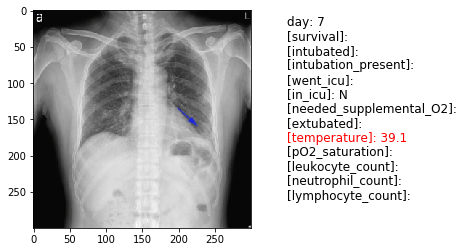

[Clincal Notes]: A 51 years old male with general muscle ache and fatigue for 1 week, fever for 1 day (39.1 ℃), anemia. Laboratory test: normal white blood cells (9.24 × 109/L), lymphocytes percentage (5.1%), decreased lymphocytes (0.47 × 109/ L), decreased eosinophil count (0 × 109/L), increased C-reaction protein (170.91 mg/L), increased procalcitonin (0.45 ng/ml), increased erythrocyte sedimentation rate (48 mm/h). Imaging examination: a shows patchy shadows in the outer region of the left lower lobe, b shows large ground-glass opacity in the left lower lobe, and c shows subpleural patchy ground-glass opacity in posterior part of right upper lobe and lower tongue of left upper lobe, d shows large ground-glass opacity in the basal segment of the left lower lobe  





Patient 331a	[Gender]: F	[Age]: 39
[Patient Location]: San Lazaro Hospital, Manila, Philippines


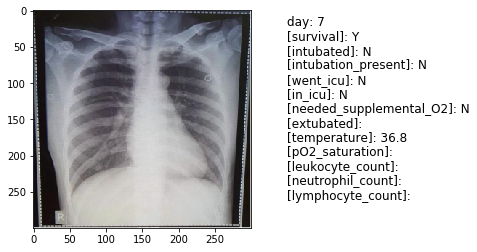

[Clincal Notes]: Posteroanterior chest radiograph of patient 1, 27 January 2020 (illness day 7). Unremarkable  





Patient 331b	[Gender]: M	[Age]: 44
[Patient Location]: San Lazaro Hospital, Manila, Philippines


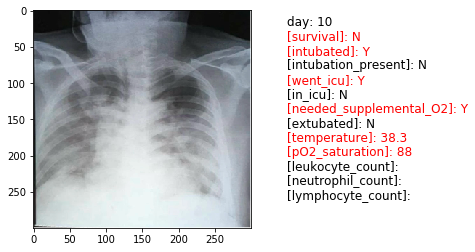

[Clincal Notes]: Posteroanterior chest radiograph of patient 2, 27 January 2020 (illness day 10). Hazy infiltrates in both lung fields consistent with pneumonia


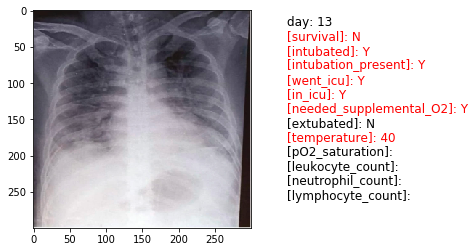

[Clincal Notes]: Posteroanterior chest radiograph of patient 2, 30 January 2020 (illness day 13). Endotracheal tube in situ approximately 2 cm above the carina. There is worsening of the previously noted pneumonia





Patient 332	[Gender]: F	[Age]: 56
[Patient Location]: Thailand


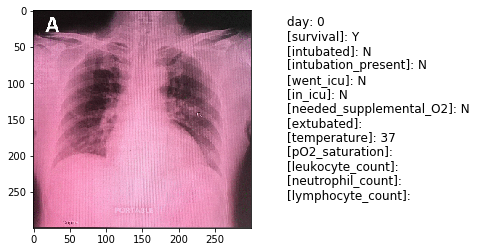

[Clincal Notes]: Her chest radiography (CXR) revealed an alveolar opacity in the left middle lung field (Figure 2A). Thus, a diagnosis of pneumonia probably due to COVID-19 was made.


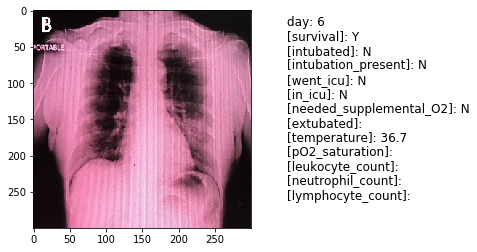

[Clincal Notes]: 


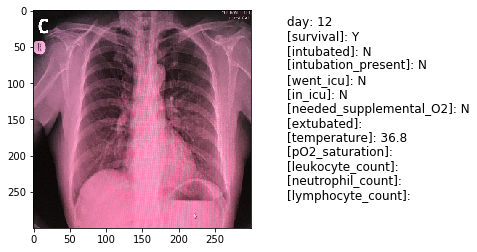

[Clincal Notes]: 





Patient 333	[Gender]: F	[Age]: 50
[Patient Location]: China


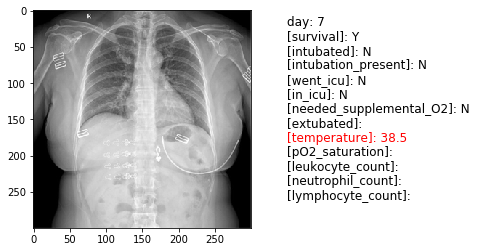

[Clincal Notes]: Initial admission chest X-ray shows increased and thickened right lower lung markings, suggesting bronchitis and interstitial pneumonia. On February 4, 2020, a 50-year-old female patient, who is a businesswoman, presented with chief complaints of “fever for one week, diarrhea, anorexia, and asthenia,” and she was admitted to the Infectious Diseases Fever Clinic of Xiangyang First People’s Hospital Affiliated to Hubei Medical College. The patient had a five-day business trip in Wuhan (from January 22, 2020, to January 27, 2020). Fever initially occurred on January 28, 2020, with a body temperature of 38.5°C, with dry cough and muscle ache. On January 30, 2020, the patient went to Xiangyang First People’s Hospital of Traditional Chinese Medicine (TCM) for consultation in the respiratory department, and the laboratory test reported that the influenza A virus serology was negative. The results of blood routine examination were normal [white blood cell count (WBC): 5.1×109/

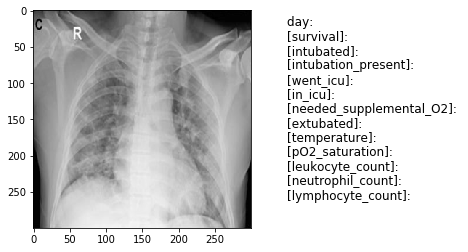

[Clincal Notes]: chest X-ray also showed patchy consolidation in bilateral lung periphery.





Patient 335	[Gender]: M	[Age]: 74
[Patient Location]: Boca Raton, Florida , USA


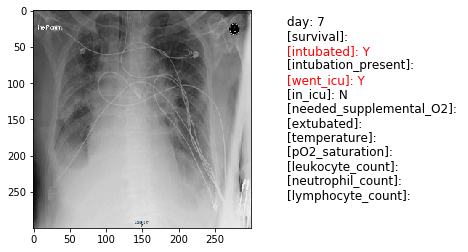

[Clincal Notes]: Chest X-ray shows multifocal airspace opacities and “ground-glass opacities”, characteristic signs of COVID-19 infection.





Patient 336	[Gender]: M	[Age]: 49
[Patient Location]: New Brunswick, New Jersey, USA


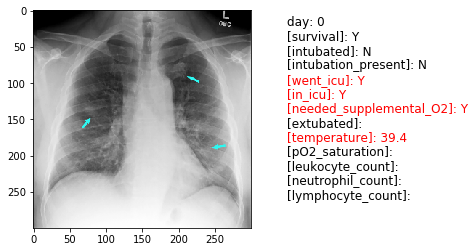

[Clincal Notes]: Chest X-ray showing hazy bilateral lung opacities (arrows)





Patient 337	[Gender]: M	[Age]: 80
[Patient Location]: Cleveland, Ohio, USA


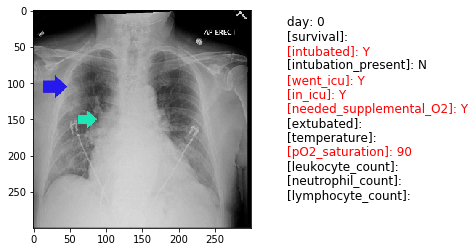

[Clincal Notes]: Chest X-ray on presentation showing hazy right upper lobe opacity (red arrow) with increased prominence of right hilum indicating adenopathy or inflammatory changes (green arrow)


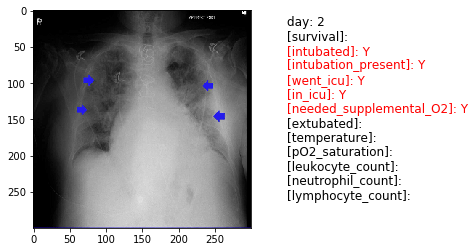

[Clincal Notes]: Chest X-ray on day 2 of admission revealing worsening infiltrates in bilateral lung zones





Patient 338	[Gender]: F	[Age]: 61
[Patient Location]: Little Rock, Arkansas, USA


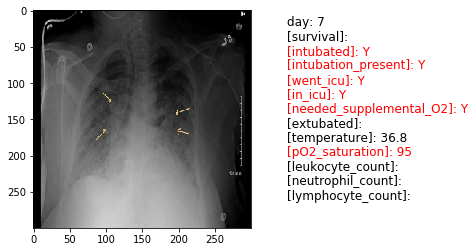

[Clincal Notes]: Chest X-ray suggestive of bilateral pulmonary edema, more on the right compared to left (arrows pointing)


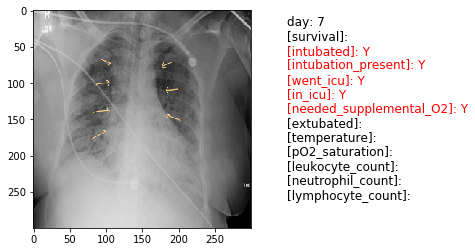

[Clincal Notes]: Chest X-ray showing bilateral ground glass opacities with worsening aeration suggestive of acute respiratory distress syndrome (ARDS) (arrows pointing)





Patient 341	[Gender]: F	[Age]: 49
[Patient Location]: Italy


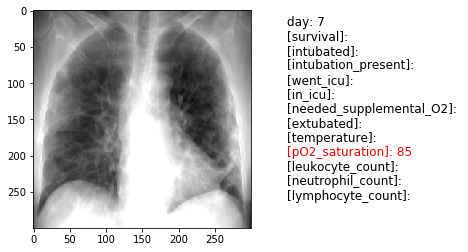

[Clincal Notes]: Presence of multiple and nuanced areas of hypodiaphaly, partly pseudonodular in appearance, borne by both hemithorax, with a predominantly peribronchial distribution, with associated reinforcement of the interstitial texture and peribronchial thickening, more evident in the ilo-peri-ilar and mediobasal bilaterally. In the basal center there are some areas delimited by radiopaque streaks, possible emphysematic manifestations. Bilateral medium-basal disventilator phenomena.





Patient 342	[Gender]: F	[Age]: 47
[Patient Location]: Italy


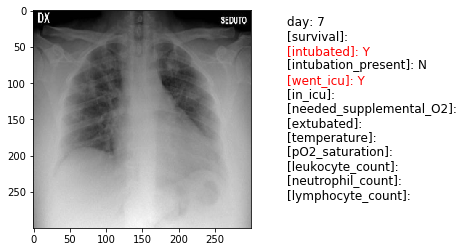

[Clincal Notes]: Gradient interstitial - alveolar infiltrates are recognized in the bilateral intercleidoilary site and in the right middle field. No pleural effusion. Cardiac transverse diameter increase.


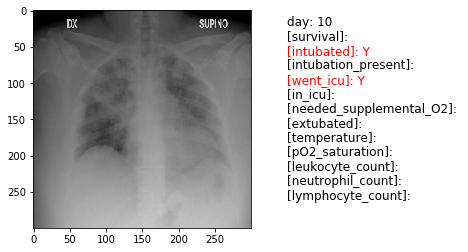

[Clincal Notes]: Increase in extension of multiple bilateral infiltrates which currently flow into parenchymal thickening in the middle III of the right lung and in multiple parenchymal consolidation patches on the left. Pleural effusion not recognizable.





Patient 343	[Gender]: F	[Age]: 47
[Patient Location]: Italy


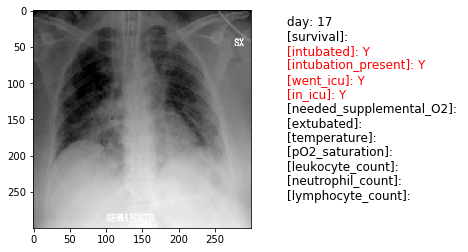

[Clincal Notes]: increase in bilateral interstitial alveolar infiltrates, more compact in the right perilary region. Appearance of pneumomediastinum and soft tissue emphysema of the chest wall and at the base of the neck on the left.





Patient 344	[Gender]: M	[Age]: 78
[Patient Location]: Italy


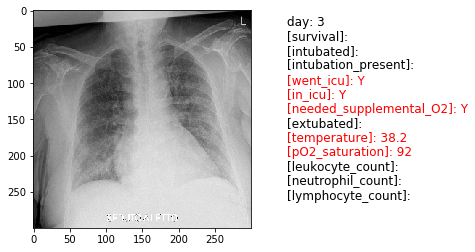

[Clincal Notes]: A new chest X-ray shows subtle and uneven thickenings spread to the middle and lower third of the left lung field and to the lower third of the right lung field suspected of having Covid-19 infection.


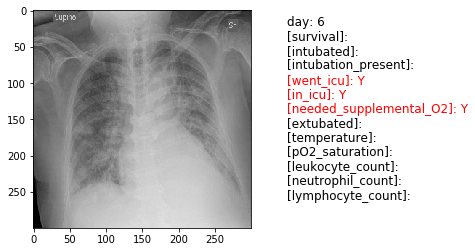

[Clincal Notes]: 





Patient 345	[Gender]: F	[Age]: 78
[Patient Location]: Italy


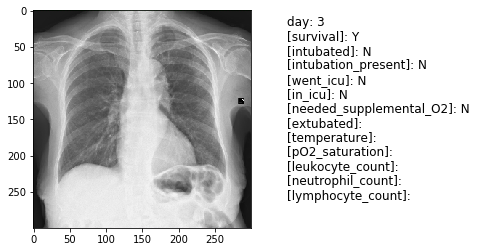

[Clincal Notes]: Widespread modest peribroncovasal pulmonary interstitial reinforcement with nuanced reduction of diaphanous at the mantle site of the left upper pulmonary field (alveolar-interstitial commitment?) Worthy of diagnostic examination by chest CT





Patient 346	[Gender]: F	[Age]: 64
[Patient Location]: Italy


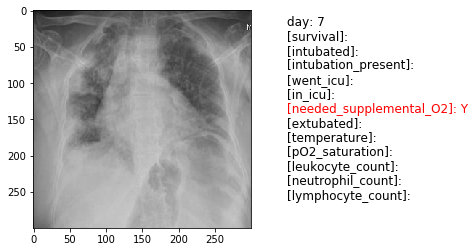

[Clincal Notes]: bilateral parenchymal thickening report .





Patient 347	[Gender]: F	[Age]: 39
[Patient Location]: Italy


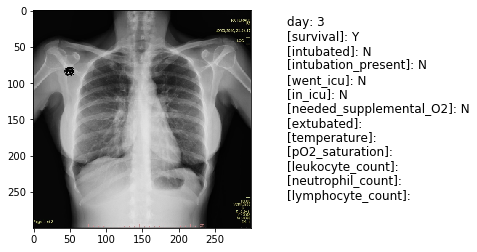

[Clincal Notes]: 


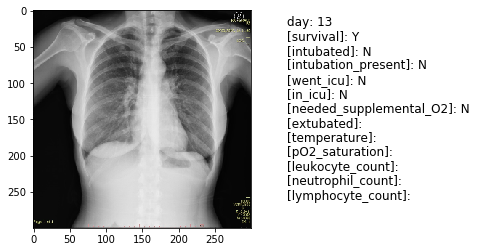

[Clincal Notes]: Plenty of nuanced shaded glass areola are appreciated in the dorsal areas of both lower lung lobes, without parenchymal consolidation. In the lung segments not affected by the findings just described, there are no widespread alterations of the interstitium. No pleural effusion.  The case presented confirms the limited sensitivity of the X-ray examination and the usefulness of CT in case of discrepancy with clinical data.





Patient 348	[Gender]: M	[Age]: 75
[Patient Location]: Italy


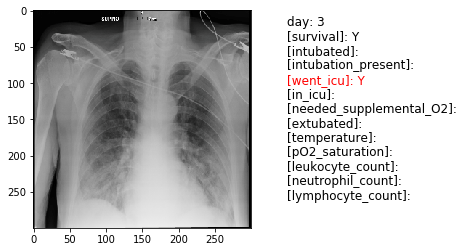

[Clincal Notes]: Blocks of parenchymal thickening in bilateral mid-basal region compatible with interstitial pneumonia.





Patient 349	[Gender]: M	[Age]: 57
[Patient Location]: Italy


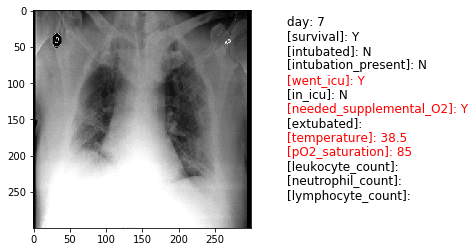

[Clincal Notes]: Presence of nuanced parenchymal thickenings, partly with pseudo-nodular appearance, in both hemithorax, with greater evidence in bi-basal site. Reinforcement of the interstitial texture and peri-bronchial thickening, bilaterally. Thickened them. Veiling (pleurogenic) of both SCFs.







In [8]:
# visualize data details
for patient_id in patient_data:
    print("\033[1mPatient %s\033[0m\t\033[1m[Gender]\033[0m: %s\t\033[1m[Age]\033[0m: %s" % (patient_id, patient_data[patient_id]['sex'], patient_data[patient_id]['age']))
    print('\033[1m[Patient Location]\033[0m: %s' % patient_data[patient_id]['location'])

    if len(patient_data[patient_id]['records']) >= 1:

        for record in patient_data[patient_id]['records']:
            img_filename = '../data/covid-chestxray-dataset/images/' + record[column_name.index('filename') - 4]

            if 'nii.gz' not in img_filename:

                img = cv2.imread(img_filename)

                # add rectangle to image
                for bbox in record[-1]:
                    try:
                        cv2.rectangle(img, (bbox[0], bbox[1]), (bbox[0] + bbox[2], bbox[1] + bbox[3]), (0, 255, 0), 2)
                    except:
                        continue
                img = cv2.resize(img, (300, 300))

                plt.imshow(img)

                plt.text(350, 20, 'day: %s' % record[0], fontsize=12)
                plt.text(350, 40, '[survival]: %s' % record[column_name.index('survival') - 4], fontsize=12, color='red' if record[column_name.index('survival') - 4] == 'N' else 'black')
                plt.text(350, 60, '[intubated]: %s' % record[column_name.index('intubated') - 4], fontsize=12, color='red' if record[column_name.index('intubated') - 4] == 'Y' else 'black')
                plt.text(350, 80, '[intubation_present]: %s' % record[column_name.index('intubation_present') - 4], fontsize=12, color='red' if record[column_name.index('intubation_present') - 4] == 'Y' else 'black')
                plt.text(350, 100, '[went_icu]: %s' % record[column_name.index('went_icu') - 4], fontsize=12, color='red' if record[column_name.index('went_icu') - 4] == 'Y' else 'black')
                plt.text(350, 120, '[in_icu]: %s' % record[column_name.index('in_icu') - 4], fontsize=12, color='red' if record[column_name.index('in_icu') - 4] == 'Y' else 'black')
                plt.text(350, 140, '[needed_supplemental_O2]: %s' % record[column_name.index('needed_supplemental_O2') - 4], fontsize=12, color='red' if record[column_name.index('needed_supplemental_O2') - 4] == 'Y' else 'black')
                plt.text(350, 160, '[extubated]: %s' % record[column_name.index('extubated') - 4], fontsize=12, color='red' if record[column_name.index('extubated') - 4] == 'Y' else 'black')
                plt.text(350, 180, '[temperature]: %s' % record[column_name.index('temperature') - 4], fontsize=12, color='red' if record[column_name.index('temperature') - 4] != '' and float(record[column_name.index('temperature') - 4]) > 37 else 'black')
                plt.text(350, 200, '[pO2_saturation]: %s' % record[column_name.index('pO2_saturation') - 4], fontsize=12, color='red' if record[column_name.index('pO2_saturation') - 4] != '' and float(record[column_name.index('pO2_saturation') - 4]) < 96 else 'black')
                plt.text(350, 220, '[leukocyte_count]: %s' % record[column_name.index('leukocyte_count') - 4], fontsize=12, color='red' if record[column_name.index('leukocyte_count') - 4] != '' and (float(record[column_name.index('leukocyte_count') - 4]) < 4 or float(record[column_name.index('leukocyte_count') - 4]) > 11) else 'black')
                plt.text(350, 240, '[neutrophil_count]: %s' % record[column_name.index('neutrophil_count') - 4], fontsize=12, color='red' if record[column_name.index('neutrophil_count') - 4] != '' and (float(record[column_name.index('neutrophil_count') - 4]) < 1.7 or float(record[column_name.index('neutrophil_count') - 4]) > 7) else 'black')
                plt.text(350, 260, '[lymphocyte_count]: %s' % record[column_name.index('lymphocyte_count') - 4], fontsize=12, color='red' if record[column_name.index('lymphocyte_count') - 4] != '' and (float(record[column_name.index('lymphocyte_count') - 4]) < 0.9 or float(record[column_name.index('lymphocyte_count') - 4]) > 2.9) else 'black')

                plt.show()
                plt.show(block=False)

                print('\033[1m[Clincal Notes]\033[0m: %s' % record[column_name.index('clinical_notes') - 4])

    print()
    print()
    print()
    print()
    print()